# 3D Multi-class Segmentation with UNETR  (Muscle, Fat (subcut and internal), psoas,cavity, BGD)

## Setup environment

In [1]:
!pip install -q "monai-weekly[nibabel, tqdm, einops]"
!python -c "import matplotlib" || pip install -q matplotlib
%matplotlib inline

In [2]:
import os
import shutil
import tempfile

import matplotlib.pyplot as plt
import numpy as np
from tqdm import tqdm

from monai.losses import DiceCELoss
from monai.inferers import sliding_window_inference
from monai.transforms import (
    AsDiscrete,
    EnsureChannelFirstd,
    AddChanneld,
    Compose,
    CropForegroundd,
    LoadImaged,
    Orientationd,
    RandFlipd,
    RandCropByPosNegLabeld,
    RandShiftIntensityd,
    SaveImaged,
    ScaleIntensityRanged,
    Spacingd,
    RandRotate90d,
    ToTensord,
)

from monai.config import print_config
from monai.metrics import DiceMetric
from monai.networks.nets import UNETR

from monai.data import (
    DataLoader,
    CacheDataset,
    load_decathlon_datalist,
    decollate_batch,
)


import torch

print_config()

MONAI version: 0.10.dev2231
Numpy version: 1.23.1
Pytorch version: 1.12.0+cu102
MONAI flags: HAS_EXT = False, USE_COMPILED = False, USE_META_DICT = False
MONAI rev id: 8236821c099e5997f7ad0410c5374e4472f4ed14
MONAI __file__: /home/adminbthomas/miniconda3/envs/PT02/lib/python3.9/site-packages/monai/__init__.py

Optional dependencies:
Pytorch Ignite version: 0.4.9
Nibabel version: 4.0.1
scikit-image version: 0.19.3
Pillow version: 9.2.0
Tensorboard version: 2.9.1
gdown version: 4.5.1
TorchVision version: 0.13.0+cu102
tqdm version: 4.64.0
lmdb version: 1.3.0
psutil version: 5.9.1
pandas version: 1.4.3
einops version: 0.4.1
transformers version: 4.20.1
mlflow version: 1.27.0
pynrrd version: NOT INSTALLED or UNKNOWN VERSION.

For details about installing the optional dependencies, please visit:
    https://docs.monai.io/en/latest/installation.html#installing-the-recommended-dependencies



## Setup data directory


In [3]:
# directory = os.environ.get("MONAI_DATA_DIRECTORY")
root_dir = "/home/adminbthomas/Downloads/data"# root_dir = tempfile.mkdtemp() if directory is None else directory
print(root_dir)

/home/adminbthomas/Downloads/data


## Setup transforms for training and validation

In [4]:
import datetime
import time

train_transforms = Compose(
    [
        LoadImaged(keys=["image", "label"], ensure_channel_first=True),
#         AddChanneld(keys=["image", "label"]),
        Orientationd(keys=["image", "label"], axcodes="RAS"),
        Spacingd(
            keys=["image", "label"],
            pixdim=(1.5, 1.5, 4.0),
            mode=("bilinear", "nearest"),
        ),
        ScaleIntensityRanged(
            keys=["image"],
            a_min=0,
            a_max=250,
            b_min=0.0,
            b_max=1.0,
            clip=True,   # change-intermedouts 
        ),
        CropForegroundd(keys=["image", "label"], source_key="image"),
        RandCropByPosNegLabeld(
            keys=["image", "label"],
            label_key="label",
            spatial_size=(96, 96, 16),
            pos=1,
            neg=1,
            num_samples=4,
            image_key="image",
            image_threshold=0,
        ),
        RandFlipd(
            keys=["image", "label"],
            spatial_axis=[0],
            prob=0.10,
        ),
        RandFlipd(
            keys=["image", "label"],
            spatial_axis=[1],
            prob=0.10,
        ),
        RandFlipd(
            keys=["image", "label"],
            spatial_axis=[2],
            prob=0.10,
        ),
        RandRotate90d(
            keys=["image", "label"],
            prob=0.10,
            max_k=3,
        ),
        RandShiftIntensityd(
            keys=["image"],
            offsets=0.10,
            prob=0.50,
        ),
        ToTensord(keys=["image", "label"]),
#         SaveImaged(keys="image", meta_keys="image_meta_dict", output_dir="./outMR02_Jul23_Interinputs", output_postfix=datetime.datetime.now().strftime('%f'), resample=False, separate_folder=False),
#         SaveImaged(keys="label", meta_keys="label_meta_dict", output_dir="./outMR02_Jul23_Interinputs", output_postfix=datetime.datetime.now().strftime('%f'), resample=False, separate_folder=False),
    ]
)
val_transforms = Compose(
    [
        LoadImaged(keys=["image", "label"], ensure_channel_first=True),
#         AddChanneld(keys=["image", "label"]),
        Orientationd(keys=["image", "label"], axcodes="RAS"),
        Spacingd(
            keys=["image", "label"],
            pixdim=(1.5, 1.5, 4.0),
            mode=("bilinear", "nearest"),
        ),
        ScaleIntensityRanged(
            keys=["image"], a_min=0, a_max=250, b_min=0.0, b_max=1.0, clip=True
        ),
        CropForegroundd(keys=["image", "label"], source_key="image"),
        ToTensord(keys=["image", "label"]),
    ]
)

### DATA

In [5]:
data_dir = os.path.join(root_dir,"013123_MR/")

In [6]:
# data_dir = os.path.join(root_dir,"013123_MR/")
split_JSON = "dataset_MR04.json"
datasets = data_dir + split_JSON
datalist = load_decathlon_datalist(datasets, True, "training")
val_files = load_decathlon_datalist(datasets, True, "validation")
train_ds = CacheDataset(
    data=datalist,
    transform=train_transforms,
    cache_num=24,
    cache_rate=1.0,
    num_workers=8,
)
train_loader = DataLoader(
    train_ds, batch_size=1, shuffle=True, num_workers=8, pin_memory=True
)
val_ds = CacheDataset(
    data=val_files, transform=val_transforms, cache_num=6, cache_rate=1.0, num_workers=4
)
val_loader = DataLoader(
    val_ds, batch_size=1, shuffle=False, num_workers=4, pin_memory=True
)

Loading dataset:   0%|                                                                                                                                                     | 0/12 [00:00<?, ?it/s]Modifying image pixdim from [1.4648438 1.4648438 8.        0.       ] to [  1.46484375   1.46484375   8.         281.03604124]
Modifying image pixdim from [1.4648438 1.4648438 4.        0.       ] to [  1.46484375   1.46484375   4.         268.45717811]
Loading dataset: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 6/6 [00:00<00:00, 10.21it/s]


In [7]:
data_dir = os.path.join(root_dir,"013123_MR/")
print(data_dir)
# help(val_loader)
# len(val_loader)

/home/adminbthomas/Downloads/data/013123_MR/


## Check data shape and visualize

image shape: torch.Size([1, 250, 171, 25]), label shape: torch.Size([1, 250, 171, 25])


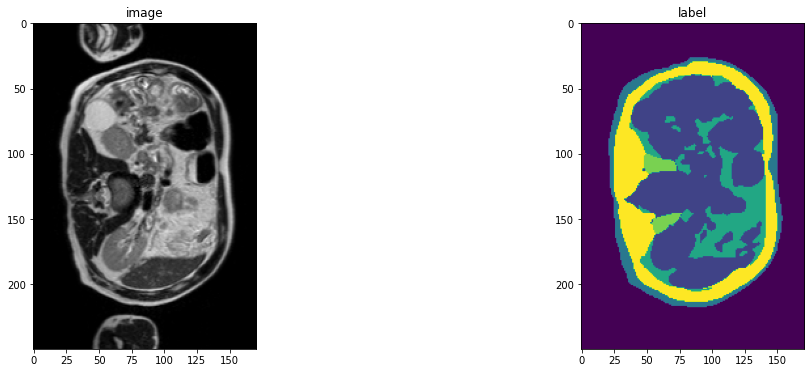

In [8]:
slice_map = {
    "A029_v4_T2W.nii.gz": 10,
    "A029_v4_T2W.nii.gz": 8,
    "A029_v4_T2W.nii.gz": 6
}
case_num = 3
img_name = os.path.split(val_ds[case_num]["image_meta_dict"]["filename_or_obj"])[1]
img = val_ds[case_num]["image"]
label = val_ds[case_num]["label"]
img_shape = img.shape
label_shape = label.shape
print(f"image shape: {img_shape}, label shape: {label_shape}")
plt.figure("image", (18, 6))
plt.subplot(1, 2, 1)
plt.title("image")
plt.imshow(img[0, :, :, slice_map[img_name]].detach().cpu(), cmap="gray")
plt.subplot(1, 2, 2)
plt.title("label")
plt.imshow(label[0, :, :, slice_map[img_name]].detach().cpu())
plt.show()

### Create Model, Loss, Optimizer


In [9]:
# os.environ["CUDA_DEVICE_ORDER"] = "PCI_BUS_ID"
device = torch.device("cuda:0")

model = UNETR(
    in_channels=1,
    out_channels=6,
    img_size=(96, 96, 16),
    feature_size=16,
    hidden_size=768,
    mlp_dim=3072,
    num_heads=12,
    pos_embed="perceptron",
    norm_name="instance",
    res_block=True,
    dropout_rate=0.0,
).to(device)

loss_function = DiceCELoss(to_onehot_y=True, softmax=True)
torch.backends.cudnn.benchmark = True
optimizer = torch.optim.AdamW(model.parameters(), lr=1e-4, weight_decay=1e-5)

### Execute a typical PyTorch training process

In [10]:
def validation(epoch_iterator_val):
    model.eval()
    dice_vals = list()
    with torch.no_grad():
        for step, batch in enumerate(epoch_iterator_val):
            val_inputs, val_labels = (batch["image"].to(device), batch["label"].to(device))
            val_outputs = sliding_window_inference(val_inputs, (96, 96, 16), 4, model)
            val_labels_list = decollate_batch(val_labels)
            val_labels_convert = [
                post_label(val_label_tensor) for val_label_tensor in val_labels_list
            ]
            val_outputs_list = decollate_batch(val_outputs)
            val_output_convert = [
                post_pred(val_pred_tensor) for val_pred_tensor in val_outputs_list
            ]
            dice_metric(y_pred=val_output_convert, y=val_labels_convert)
            dice = dice_metric.aggregate().item()
            dice_vals.append(dice)
            epoch_iterator_val.set_description(
                "Validate (%d / %d Steps) (dice=%2.5f)" % (global_step, 10.0, dice)
            )
        dice_metric.reset()
    mean_dice_val = np.mean(dice_vals)
    return mean_dice_val


def train(global_step, train_loader, dice_val_best, global_step_best):
    model.train()
    epoch_loss = 0
    step = 0
    epoch_iterator = tqdm(
        train_loader, desc="Training (X / X Steps) (loss=X.X)", dynamic_ncols=True
    )
    for step, batch in enumerate(epoch_iterator):
        step += 1
        x, y = (batch["image"].to(device), batch["label"].to(device))
#         print(x.shape)
#         print(y.shape)
#         plt.figure("image", (18, 6))
#         plt.subplot(1, 2, 1)
#         plt.title("image")
#         plt.imshow(x[3,0,:,:,4].detach().cpu(), cmap="gray")
#         plt.subplot(1, 2, 2)
#         plt.title("label")
#         plt.imshow(y[3,0,:,:,4].detach().cpu())
#         plt.show()
        logit_map = model(x)
        loss = loss_function(logit_map, y)
        loss.backward()
        epoch_loss += loss.item()
        optimizer.step()
        optimizer.zero_grad()
        epoch_iterator.set_description(
            "Training (%d / %d Steps) (loss=%2.5f)" % (global_step, max_iterations, loss)
        )
        if (
            global_step % eval_num == 0 and global_step != 0
        ) or global_step == max_iterations:
            epoch_iterator_val = tqdm(
                val_loader, desc="Validate (X / X Steps) (dice=X.X)", dynamic_ncols=True
            )
            dice_val = validation(epoch_iterator_val)
            epoch_loss /= step
            epoch_loss_values.append(epoch_loss)
            metric_values.append(dice_val)
            if dice_val > dice_val_best:
                dice_val_best = dice_val
                global_step_best = global_step
                torch.save(
                    model.state_dict(), os.path.join(data_dir, "TestMR04_multiclassUNetR_Sep23.pth")
                )
                print(
                    "Model Was Saved ! Current Best Avg. Dice: {} Current Avg. Dice: {}".format(
                        dice_val_best, dice_val
                    )
                )
            else:
                print(
                    "Model Was Not Saved ! Current Best Avg. Dice: {} Current Avg. Dice: {}".format(
                        dice_val_best, dice_val
                    )
                )
        global_step += 1
        
    return global_step, dice_val_best, global_step_best


max_iterations = 70000
eval_num = 500
post_label = AsDiscrete(to_onehot=6)
post_pred = AsDiscrete(argmax=True, to_onehot=6)
dice_metric = DiceMetric(include_background=True, reduction="mean", get_not_nans=False)
global_step = 0
dice_val_best = 0.0
global_step_best = 0
epoch_loss_values = []
metric_values = []
while global_step < max_iterations:
    global_step, dice_val_best, global_step_best = train(
        global_step, train_loader, dice_val_best, global_step_best
    )
#     print('I am waiting....')
#     time.sleep(1)
model.load_state_dict(torch.load(os.path.join(data_dir, "TestMR04_multiclassUNetR_Sep23.pth")))

Training (501 / 70000 Steps) (loss=1.39055):  83%|█████████████████████████████████████████████████████████████████████████████████████████████▎                  | 10/12 [00:04<00:01,  1.41it/s]

Model Was Saved ! Current Best Avg. Dice: 0.6347129770687648 Current Avg. Dice: 0.6347129770687648


Training (1001 / 70000 Steps) (loss=1.02669):  50%|████████████████████████████████████████████████████████                                                        | 6/12 [00:04<00:04,  1.25it/s]

Model Was Saved ! Current Best Avg. Dice: 0.6732103143419538 Current Avg. Dice: 0.6732103143419538


Training (1501 / 70000 Steps) (loss=0.81119):  17%|██████████████████▋                                                                                             | 2/12 [00:03<00:15,  1.51s/it]

Model Was Saved ! Current Best Avg. Dice: 0.71290670973914 Current Avg. Dice: 0.71290670973914


Training (2001 / 70000 Steps) (loss=0.96081):  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                  | 10/12 [00:04<00:01,  1.35it/s]

Model Was Saved ! Current Best Avg. Dice: 0.7260158658027649 Current Avg. Dice: 0.7260158658027649


Training (2501 / 70000 Steps) (loss=0.69477):  50%|████████████████████████████████████████████████████████                                                        | 6/12 [00:04<00:04,  1.23it/s]

Model Was Saved ! Current Best Avg. Dice: 0.733961318220411 Current Avg. Dice: 0.733961318220411


Training (3001 / 70000 Steps) (loss=1.14418):  17%|██████████████████▋                                                                                             | 2/12 [00:03<00:13,  1.31s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.733961318220411 Current Avg. Dice: 0.7305506808417184


Training (3501 / 70000 Steps) (loss=0.56304):  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                  | 10/12 [00:04<00:01,  1.36it/s]

Model Was Saved ! Current Best Avg. Dice: 0.7495605179241726 Current Avg. Dice: 0.7495605179241726


Training (4001 / 70000 Steps) (loss=0.73975):  50%|████████████████████████████████████████████████████████                                                        | 6/12 [00:03<00:04,  1.45it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.7495605179241726 Current Avg. Dice: 0.739693854536329


Training (4501 / 70000 Steps) (loss=0.60808):  17%|██████████████████▋                                                                                             | 2/12 [00:02<00:12,  1.26s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.7495605179241726 Current Avg. Dice: 0.7493793368339539


Training (5001 / 70000 Steps) (loss=0.57742):  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                  | 10/12 [00:04<00:01,  1.36it/s]

Model Was Saved ! Current Best Avg. Dice: 0.7572010670389447 Current Avg. Dice: 0.7572010670389447


Training (5501 / 70000 Steps) (loss=0.59521):  50%|████████████████████████████████████████████████████████                                                        | 6/12 [00:04<00:04,  1.24it/s]

Model Was Saved ! Current Best Avg. Dice: 0.7656658973012652 Current Avg. Dice: 0.7656658973012652


Training (6001 / 70000 Steps) (loss=0.56689):  17%|██████████████████▋                                                                                             | 2/12 [00:03<00:15,  1.53s/it]

Model Was Saved ! Current Best Avg. Dice: 0.8517327904701233 Current Avg. Dice: 0.8517327904701233


Training (6501 / 70000 Steps) (loss=0.49283):  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                  | 10/12 [00:04<00:01,  1.35it/s]

Model Was Saved ! Current Best Avg. Dice: 0.8781914370400565 Current Avg. Dice: 0.8781914370400565


Training (7001 / 70000 Steps) (loss=0.49249):  50%|████████████████████████████████████████████████████████                                                        | 6/12 [00:04<00:04,  1.24it/s]

Model Was Saved ! Current Best Avg. Dice: 0.8876701678548541 Current Avg. Dice: 0.8876701678548541


Training (7501 / 70000 Steps) (loss=0.69395):  17%|██████████████████▋                                                                                             | 2/12 [00:03<00:12,  1.29s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.8876701678548541 Current Avg. Dice: 0.8853025180952889


Training (8001 / 70000 Steps) (loss=0.47815):  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                  | 10/12 [00:04<00:01,  1.37it/s]

Model Was Saved ! Current Best Avg. Dice: 0.8880045413970947 Current Avg. Dice: 0.8880045413970947


Training (8501 / 70000 Steps) (loss=0.67743):  50%|████████████████████████████████████████████████████████                                                        | 6/12 [00:03<00:04,  1.43it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.8880045413970947 Current Avg. Dice: 0.8840042182377407


Training (9001 / 70000 Steps) (loss=0.57990):  17%|██████████████████▋                                                                                             | 2/12 [00:03<00:15,  1.52s/it]

Model Was Saved ! Current Best Avg. Dice: 0.8952249544007438 Current Avg. Dice: 0.8952249544007438


Training (9501 / 70000 Steps) (loss=0.45179):  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                  | 10/12 [00:04<00:01,  1.58it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.8952249544007438 Current Avg. Dice: 0.894767667566027


Training (10001 / 70000 Steps) (loss=0.64558):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:03<00:04,  1.43it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.8952249544007438 Current Avg. Dice: 0.890515651021685


Training (10501 / 70000 Steps) (loss=0.42970):  17%|██████████████████▌                                                                                            | 2/12 [00:03<00:13,  1.32s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.8952249544007438 Current Avg. Dice: 0.8915242893355233


Training (11001 / 70000 Steps) (loss=0.52955):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:04<00:01,  1.38it/s]

Model Was Saved ! Current Best Avg. Dice: 0.8987610851015363 Current Avg. Dice: 0.8987610851015363


Training (11501 / 70000 Steps) (loss=0.45102):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:03<00:04,  1.42it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.8987610851015363 Current Avg. Dice: 0.8911950417927333


Training (12001 / 70000 Steps) (loss=0.59517):  17%|██████████████████▌                                                                                            | 2/12 [00:03<00:14,  1.47s/it]

Model Was Saved ! Current Best Avg. Dice: 0.9002385139465332 Current Avg. Dice: 0.9002385139465332


Training (12501 / 70000 Steps) (loss=0.52864):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:04<00:01,  1.39it/s]

Model Was Saved ! Current Best Avg. Dice: 0.9039236732891628 Current Avg. Dice: 0.9039236732891628


Training (13001 / 70000 Steps) (loss=0.40524):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:03<00:04,  1.38it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9039236732891628 Current Avg. Dice: 0.9011428867067609


Training (13501 / 70000 Steps) (loss=0.44367):  17%|██████████████████▌                                                                                            | 2/12 [00:03<00:14,  1.49s/it]

Model Was Saved ! Current Best Avg. Dice: 0.9059266533170428 Current Avg. Dice: 0.9059266533170428


Training (14001 / 70000 Steps) (loss=0.39079):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:04<00:01,  1.60it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9059266533170428 Current Avg. Dice: 0.9034662076405117


Training (14501 / 70000 Steps) (loss=0.83875):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:03<00:04,  1.44it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9059266533170428 Current Avg. Dice: 0.9039223619869777


Training (15001 / 70000 Steps) (loss=0.47720):  17%|██████████████████▌                                                                                            | 2/12 [00:03<00:13,  1.34s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9059266533170428 Current Avg. Dice: 0.9025623883519854


Training (15501 / 70000 Steps) (loss=0.34380):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:04<00:01,  1.61it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9059266533170428 Current Avg. Dice: 0.9019827757562909


Training (16001 / 70000 Steps) (loss=0.36305):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:03<00:04,  1.45it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9059266533170428 Current Avg. Dice: 0.9012251496315002


Training (16501 / 70000 Steps) (loss=0.63425):  17%|██████████████████▌                                                                                            | 2/12 [00:03<00:13,  1.32s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9059266533170428 Current Avg. Dice: 0.8962508610316685


Training (17001 / 70000 Steps) (loss=0.39020):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:04<00:01,  1.62it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9059266533170428 Current Avg. Dice: 0.9025545460837228


Training (17501 / 70000 Steps) (loss=0.39435):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:03<00:04,  1.43it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9059266533170428 Current Avg. Dice: 0.9058968765395028


Training (18001 / 70000 Steps) (loss=0.62824):  17%|██████████████████▌                                                                                            | 2/12 [00:03<00:16,  1.61s/it]

Model Was Saved ! Current Best Avg. Dice: 0.9101309861455645 Current Avg. Dice: 0.9101309861455645


Training (18501 / 70000 Steps) (loss=0.36343):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:04<00:01,  1.57it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9101309861455645 Current Avg. Dice: 0.9079189215387616


Training (19001 / 70000 Steps) (loss=0.40413):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:03<00:04,  1.45it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9101309861455645 Current Avg. Dice: 0.9072442821093968


Training (19501 / 70000 Steps) (loss=0.49638):  17%|██████████████████▌                                                                                            | 2/12 [00:03<00:13,  1.35s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9101309861455645 Current Avg. Dice: 0.9047749127660479


Training (20001 / 70000 Steps) (loss=0.26064):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:04<00:01,  1.62it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9101309861455645 Current Avg. Dice: 0.9070519038609096


Training (20501 / 70000 Steps) (loss=0.58673):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:03<00:04,  1.43it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9101309861455645 Current Avg. Dice: 0.9068324736186436


Training (21001 / 70000 Steps) (loss=0.32885):  17%|██████████████████▌                                                                                            | 2/12 [00:03<00:13,  1.33s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9101309861455645 Current Avg. Dice: 0.9089274321283612


Training (21501 / 70000 Steps) (loss=0.68873):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:04<00:01,  1.59it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9101309861455645 Current Avg. Dice: 0.8989330445017133


Training (22001 / 70000 Steps) (loss=0.39558):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:03<00:04,  1.43it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9101309861455645 Current Avg. Dice: 0.9052179796355111


Training (22501 / 70000 Steps) (loss=0.38446):  17%|██████████████████▌                                                                                            | 2/12 [00:03<00:12,  1.29s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9101309861455645 Current Avg. Dice: 0.9081375684056964


Training (23001 / 70000 Steps) (loss=0.38659):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:04<00:01,  1.60it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9101309861455645 Current Avg. Dice: 0.9095744660922459


Training (23501 / 70000 Steps) (loss=0.40303):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:04<00:04,  1.24it/s]

Model Was Saved ! Current Best Avg. Dice: 0.910861713545663 Current Avg. Dice: 0.910861713545663


Training (24001 / 70000 Steps) (loss=0.56449):  17%|██████████████████▌                                                                                            | 2/12 [00:03<00:12,  1.30s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.910861713545663 Current Avg. Dice: 0.9078800507954189


Training (24501 / 70000 Steps) (loss=0.20924):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:04<00:01,  1.60it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.910861713545663 Current Avg. Dice: 0.9065487044198173


Training (25001 / 70000 Steps) (loss=0.31959):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:03<00:04,  1.45it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.910861713545663 Current Avg. Dice: 0.9038800171443394


Training (25501 / 70000 Steps) (loss=0.32861):  17%|██████████████████▌                                                                                            | 2/12 [00:03<00:13,  1.31s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.910861713545663 Current Avg. Dice: 0.9063557471547808


Training (26001 / 70000 Steps) (loss=0.25687):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:04<00:01,  1.61it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.910861713545663 Current Avg. Dice: 0.9061595116342817


Training (26501 / 70000 Steps) (loss=0.35774):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:03<00:04,  1.40it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.910861713545663 Current Avg. Dice: 0.8931533779416766


Training (27001 / 70000 Steps) (loss=0.40313):  17%|██████████████████▌                                                                                            | 2/12 [00:03<00:12,  1.29s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.910861713545663 Current Avg. Dice: 0.9079691256795611


Training (27501 / 70000 Steps) (loss=0.43828):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:04<00:01,  1.60it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.910861713545663 Current Avg. Dice: 0.9087171043668475


Training (28001 / 70000 Steps) (loss=0.45770):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:04<00:05,  1.20it/s]

Model Was Saved ! Current Best Avg. Dice: 0.9136978132384164 Current Avg. Dice: 0.9136978132384164


Training (28501 / 70000 Steps) (loss=0.39211):  17%|██████████████████▌                                                                                            | 2/12 [00:03<00:12,  1.26s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9136978132384164 Current Avg. Dice: 0.9086155806268964


Training (29501 / 70000 Steps) (loss=0.44239):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:03<00:04,  1.42it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9136978132384164 Current Avg. Dice: 0.8871229035513741


Training (30001 / 70000 Steps) (loss=0.39099):  17%|██████████████████▌                                                                                            | 2/12 [00:03<00:13,  1.35s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9136978132384164 Current Avg. Dice: 0.9078186665262494


Training (30501 / 70000 Steps) (loss=0.33834):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:04<00:01,  1.62it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9136978132384164 Current Avg. Dice: 0.9122774600982666


Training (30731 / 70000 Steps) (loss=0.51124): 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:02<00:00,  6.36it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Training (35001 / 70000 Steps) (loss=0.27547):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:04<00:01,  1.60it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9144894736153739 Current Avg. Dice: 0.9120194826807294


Training (35501 / 70000 Steps) (loss=0.28118):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:03<00:04,  1.44it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9144894736153739 Current Avg. Dice: 0.9123184766088214


Training (36001 / 70000 Steps) (loss=0.17111):  17%|██████████████████▌                                                                                            | 2/12 [00:03<00:12,  1.28s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9144894736153739 Current Avg. Dice: 0.9081971219607762


Training (36501 / 70000 Steps) (loss=0.34330):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:04<00:01,  1.34it/s]

Model Was Saved ! Current Best Avg. Dice: 0.9152264254433768 Current Avg. Dice: 0.9152264254433768


Training (37001 / 70000 Steps) (loss=0.23216):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:03<00:04,  1.43it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9152264254433768 Current Avg. Dice: 0.9089133143424988


Training (37501 / 70000 Steps) (loss=0.28897):  17%|██████████████████▌                                                                                            | 2/12 [00:03<00:13,  1.32s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9152264254433768 Current Avg. Dice: 0.9120870147432599


Training (38001 / 70000 Steps) (loss=0.31628):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:04<00:01,  1.62it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9152264254433768 Current Avg. Dice: 0.911599372114454


Training (38501 / 70000 Steps) (loss=0.46074):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:03<00:04,  1.45it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9152264254433768 Current Avg. Dice: 0.9098258103643145


Training (39001 / 70000 Steps) (loss=0.75501):  17%|██████████████████▌                                                                                            | 2/12 [00:03<00:13,  1.34s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9152264254433768 Current Avg. Dice: 0.9142657262938363


Training (39501 / 70000 Steps) (loss=0.30292):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:04<00:01,  1.62it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9152264254433768 Current Avg. Dice: 0.9129714454923358


Training (40001 / 70000 Steps) (loss=0.37495):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:03<00:04,  1.45it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9152264254433768 Current Avg. Dice: 0.908896437713078


Training (40501 / 70000 Steps) (loss=0.67229):  17%|██████████████████▌                                                                                            | 2/12 [00:03<00:13,  1.32s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9152264254433768 Current Avg. Dice: 0.9075331687927246


Training (41001 / 70000 Steps) (loss=0.34946):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:04<00:01,  1.58it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9152264254433768 Current Avg. Dice: 0.9080285855701992


Training (41501 / 70000 Steps) (loss=0.46012):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:03<00:04,  1.45it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9152264254433768 Current Avg. Dice: 0.9058730431965419


Training (42001 / 70000 Steps) (loss=0.26528):  17%|██████████████████▌                                                                                            | 2/12 [00:03<00:13,  1.32s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9152264254433768 Current Avg. Dice: 0.9123673864773342


Training (42501 / 70000 Steps) (loss=0.35606):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:04<00:01,  1.60it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9152264254433768 Current Avg. Dice: 0.9070167371204921


Training (43001 / 70000 Steps) (loss=0.29890):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:03<00:04,  1.42it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9152264254433768 Current Avg. Dice: 0.9063755699566433


Training (43501 / 70000 Steps) (loss=0.36846):  17%|██████████████████▌                                                                                            | 2/12 [00:03<00:13,  1.31s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9152264254433768 Current Avg. Dice: 0.9091086132185799


Training (44001 / 70000 Steps) (loss=0.36827):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:04<00:01,  1.62it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9152264254433768 Current Avg. Dice: 0.9091221860476902


Training (44501 / 70000 Steps) (loss=0.33120):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:03<00:04,  1.44it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9152264254433768 Current Avg. Dice: 0.9126256874629429


Training (45001 / 70000 Steps) (loss=0.36572):  17%|██████████████████▌                                                                                            | 2/12 [00:03<00:12,  1.30s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9152264254433768 Current Avg. Dice: 0.9137447902134487


Training (45501 / 70000 Steps) (loss=0.18682):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:04<00:01,  1.60it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9152264254433768 Current Avg. Dice: 0.9130317909376962


Training (46001 / 70000 Steps) (loss=0.37978):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:04<00:04,  1.25it/s]

Model Was Saved ! Current Best Avg. Dice: 0.9164656400680542 Current Avg. Dice: 0.9164656400680542


Training (46501 / 70000 Steps) (loss=0.50164):  17%|██████████████████▌                                                                                            | 2/12 [00:03<00:12,  1.28s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9164656400680542 Current Avg. Dice: 0.9120619467326573


Training (47001 / 70000 Steps) (loss=0.25780):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:04<00:01,  1.62it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9164656400680542 Current Avg. Dice: 0.9147220253944397


Training (47501 / 70000 Steps) (loss=0.25977):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:03<00:04,  1.45it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9164656400680542 Current Avg. Dice: 0.9108860407556806


Training (48001 / 70000 Steps) (loss=0.41856):  17%|██████████████████▌                                                                                            | 2/12 [00:03<00:13,  1.31s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9164656400680542 Current Avg. Dice: 0.9152501480919975


Training (48501 / 70000 Steps) (loss=0.32304):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:04<00:01,  1.61it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9164656400680542 Current Avg. Dice: 0.9139502474239894


Training (49001 / 70000 Steps) (loss=0.40398):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:03<00:04,  1.45it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9164656400680542 Current Avg. Dice: 0.9152946472167969


Training (49501 / 70000 Steps) (loss=0.44434):  17%|██████████████████▌                                                                                            | 2/12 [00:03<00:13,  1.32s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9164656400680542 Current Avg. Dice: 0.9091088771820068


Training (50001 / 70000 Steps) (loss=0.24656):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:04<00:01,  1.62it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9164656400680542 Current Avg. Dice: 0.9131836891174316


Training (50501 / 70000 Steps) (loss=0.32765):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:03<00:04,  1.44it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9164656400680542 Current Avg. Dice: 0.913921764918736


Training (51001 / 70000 Steps) (loss=0.35180):  17%|██████████████████▌                                                                                            | 2/12 [00:03<00:15,  1.51s/it]

Model Was Saved ! Current Best Avg. Dice: 0.9181161608014788 Current Avg. Dice: 0.9181161608014788


Training (51501 / 70000 Steps) (loss=0.41845):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:04<00:01,  1.63it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9181161608014788 Current Avg. Dice: 0.9142816066741943


Training (52001 / 70000 Steps) (loss=0.49024):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:03<00:04,  1.48it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9181161608014788 Current Avg. Dice: 0.9102327908788409


Training (52501 / 70000 Steps) (loss=0.30754):  17%|██████████████████▌                                                                                            | 2/12 [00:03<00:13,  1.31s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9181161608014788 Current Avg. Dice: 0.9121160762650626


Training (53001 / 70000 Steps) (loss=0.34646):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:04<00:01,  1.62it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9181161608014788 Current Avg. Dice: 0.9174729585647583


Training (53501 / 70000 Steps) (loss=0.20575):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:03<00:04,  1.43it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9181161608014788 Current Avg. Dice: 0.9153705154146466


Training (54001 / 70000 Steps) (loss=0.45387):  17%|██████████████████▌                                                                                            | 2/12 [00:03<00:14,  1.46s/it]

Model Was Saved ! Current Best Avg. Dice: 0.9200727599007743 Current Avg. Dice: 0.9200727599007743


Training (54501 / 70000 Steps) (loss=0.28767):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:04<00:01,  1.61it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9200727599007743 Current Avg. Dice: 0.9122722319194249


Training (55001 / 70000 Steps) (loss=0.39393):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:03<00:04,  1.44it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9200727599007743 Current Avg. Dice: 0.9141814197812762


Training (55501 / 70000 Steps) (loss=0.26345):  17%|██████████████████▌                                                                                            | 2/12 [00:03<00:13,  1.30s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9200727599007743 Current Avg. Dice: 0.9170913525990078


Training (56001 / 70000 Steps) (loss=0.34436):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:04<00:01,  1.60it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9200727599007743 Current Avg. Dice: 0.9101612057004657


Training (56501 / 70000 Steps) (loss=0.39133):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:03<00:04,  1.45it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9200727599007743 Current Avg. Dice: 0.911824745791299


Training (57001 / 70000 Steps) (loss=0.38010):  17%|██████████████████▌                                                                                            | 2/12 [00:03<00:12,  1.27s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9200727599007743 Current Avg. Dice: 0.9119905744280133


Training (57501 / 70000 Steps) (loss=0.26560):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:04<00:01,  1.65it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9200727599007743 Current Avg. Dice: 0.909021258354187


Training (58001 / 70000 Steps) (loss=0.33512):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:03<00:04,  1.42it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9200727599007743 Current Avg. Dice: 0.9163643632616315


Training (58501 / 70000 Steps) (loss=0.47443):  17%|██████████████████▌                                                                                            | 2/12 [00:03<00:13,  1.31s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9200727599007743 Current Avg. Dice: 0.9116560220718384


Training (59001 / 70000 Steps) (loss=0.38511):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:04<00:01,  1.59it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9200727599007743 Current Avg. Dice: 0.9138518827302116


Training (59501 / 70000 Steps) (loss=0.29403):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:03<00:04,  1.43it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9200727599007743 Current Avg. Dice: 0.9169689842632839


Training (60001 / 70000 Steps) (loss=0.32306):  17%|██████████████████▌                                                                                            | 2/12 [00:03<00:13,  1.32s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9200727599007743 Current Avg. Dice: 0.913101145199367


Training (60501 / 70000 Steps) (loss=0.44342):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:04<00:01,  1.58it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9200727599007743 Current Avg. Dice: 0.9179220369883946


Training (61001 / 70000 Steps) (loss=0.26896):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:03<00:04,  1.47it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9200727599007743 Current Avg. Dice: 0.9086149420057025


Training (61501 / 70000 Steps) (loss=0.35625):  17%|██████████████████▌                                                                                            | 2/12 [00:03<00:12,  1.29s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9200727599007743 Current Avg. Dice: 0.9153354253087725


Training (62001 / 70000 Steps) (loss=0.25587):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:04<00:01,  1.62it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9200727599007743 Current Avg. Dice: 0.9156750781195504


Training (62501 / 70000 Steps) (loss=0.50770):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:03<00:04,  1.40it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9200727599007743 Current Avg. Dice: 0.9124408790043422


Training (63001 / 70000 Steps) (loss=0.30230):  17%|██████████████████▌                                                                                            | 2/12 [00:03<00:13,  1.34s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9200727599007743 Current Avg. Dice: 0.91379862172263


Training (63501 / 70000 Steps) (loss=0.22249):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:04<00:01,  1.59it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9200727599007743 Current Avg. Dice: 0.9146916270256042


Training (64001 / 70000 Steps) (loss=0.22600):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:03<00:04,  1.42it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9200727599007743 Current Avg. Dice: 0.9149830000741142


Training (64501 / 70000 Steps) (loss=0.36668):  17%|██████████████████▌                                                                                            | 2/12 [00:03<00:12,  1.28s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9200727599007743 Current Avg. Dice: 0.9160779288836888


Training (65001 / 70000 Steps) (loss=0.31259):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:04<00:01,  1.61it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9200727599007743 Current Avg. Dice: 0.9139742084911892


Training (65501 / 70000 Steps) (loss=0.36925):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:03<00:04,  1.40it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9200727599007743 Current Avg. Dice: 0.9184562734195164


Training (66001 / 70000 Steps) (loss=0.29606):  17%|██████████████████▌                                                                                            | 2/12 [00:03<00:13,  1.35s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9200727599007743 Current Avg. Dice: 0.9141636320522853


Training (66501 / 70000 Steps) (loss=0.47251):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:04<00:01,  1.59it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9200727599007743 Current Avg. Dice: 0.9143070152827671


Training (67001 / 70000 Steps) (loss=0.35936):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:03<00:04,  1.44it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9200727599007743 Current Avg. Dice: 0.9134199448994228


Training (67501 / 70000 Steps) (loss=0.31662):  17%|██████████████████▌                                                                                            | 2/12 [00:03<00:12,  1.29s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9200727599007743 Current Avg. Dice: 0.9185916781425476


Training (68001 / 70000 Steps) (loss=0.42800):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:04<00:01,  1.61it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9200727599007743 Current Avg. Dice: 0.9133367623601641


Training (68501 / 70000 Steps) (loss=0.34023):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:03<00:04,  1.46it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9200727599007743 Current Avg. Dice: 0.9132191283362252


Training (69001 / 70000 Steps) (loss=0.21639):  17%|██████████████████▌                                                                                            | 2/12 [00:03<00:13,  1.32s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9200727599007743 Current Avg. Dice: 0.9131754807063511


Training (69501 / 70000 Steps) (loss=0.33000):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:04<00:01,  1.61it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9200727599007743 Current Avg. Dice: 0.9143980060304914


Training (70001 / 70000 Steps) (loss=0.27782):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:03<00:04,  1.43it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9200727599007743 Current Avg. Dice: 0.912891549723489


Training (70007 / 70000 Steps) (loss=0.34961): 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:04<00:00,  2.50it/s]


<All keys matched successfully>

In [11]:
print(
    f"train completed, best_metric: {dice_val_best:.4f} "
    f"at iteration: {global_step_best}"
)

train completed, best_metric: 0.9201 at iteration: 54000


In [ ]:
# 6062500/380133
# 12062500/731025
# 250*250*49
# 12062500/(250*250)

### Plot the loss and metric

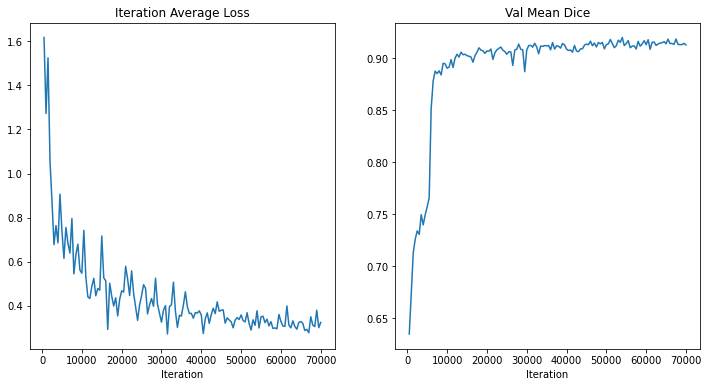

In [12]:
plt.figure("train", (12, 6))
plt.subplot(1, 2, 1)
plt.title("Iteration Average Loss")
x = [eval_num * (i + 1) for i in range(len(epoch_loss_values))]
y = epoch_loss_values
plt.xlabel("Iteration")
plt.plot(x, y)
plt.subplot(1, 2, 2)
plt.title("Val Mean Dice")
x = [eval_num * (i + 1) for i in range(len(metric_values))]
y = metric_values
plt.xlabel("Iteration")
plt.plot(x, y)
plt.show()

### Check best model output with the input image and label

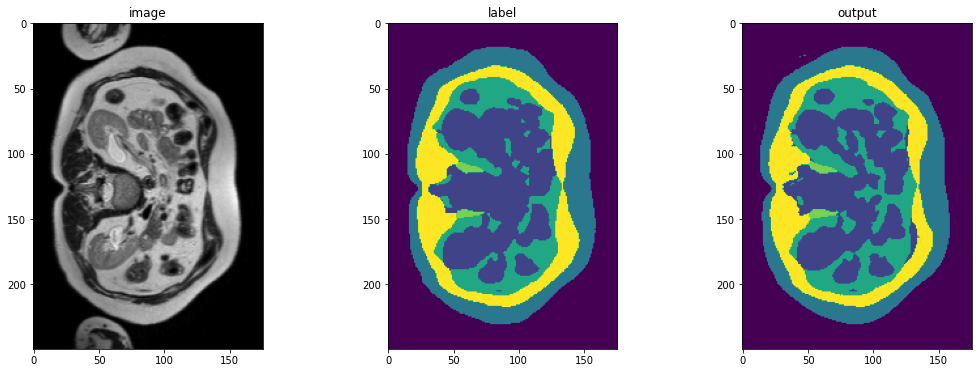

In [13]:
case_num = 0
model.load_state_dict(torch.load(os.path.join(data_dir, "TestMR04_multiclassUNetR_Sep23.pth")))
model.eval()
with torch.no_grad():
    img_name = os.path.split(val_ds[case_num]["image_meta_dict"]["filename_or_obj"])[1]
    img = val_ds[case_num]["image"]
    label = val_ds[case_num]["label"]
    val_inputs = torch.unsqueeze(img, 1).to(device)
    val_labels = torch.unsqueeze(label, 1).to(device)
    val_outputs = sliding_window_inference(
        val_inputs, (96, 96, 16), 4, model, overlap=0.8
    )
    plt.figure("check", (18, 6))
    plt.subplot(1, 3, 1)
    plt.title("image")
    plt.imshow(val_inputs.cpu().numpy()[0, 0, :, :, 5], cmap="gray")
    plt.subplot(1, 3, 2)
    plt.title("label")
    plt.imshow(val_labels.cpu().numpy()[0, 0, :, :, 5])
    plt.subplot(1, 3, 3)
    plt.title("output")
    plt.imshow(
        torch.argmax(val_outputs, dim=1).detach().cpu()[0, :, :, 5]
    )
    plt.show()
    

In [ ]:
# val_inputs.shape

### Inference on test images

In [ ]:
# if directory is None:
#     shutil.rmtree(root_dir)

In [15]:
import glob
from monai.data import Dataset
from monai.handlers.utils import from_engine
from monai.transforms import (
    AsDiscrete,
    AsDiscreted,
    EnsureChannelFirstd,
    Compose,
    CropForegroundd,
    LoadImaged,
    Orientationd,
    RandCropByPosNegLabeld,
    SaveImaged,
    ScaleIntensityRanged,
    Spacingd,
    EnsureTyped,
    EnsureType,
    Invertd,
)

test_images = sorted(
    glob.glob(os.path.join(data_dir, "imagesTs/AllVisits", "*.nii.gz")))

test_data = [{"image": image} for image in test_images]


test_org_transforms = Compose(
    [
        LoadImaged(keys="image"),
        EnsureChannelFirstd(keys="image"),
        Orientationd(keys=["image"], axcodes="RAS"),
        Spacingd(keys=["image"], pixdim=(
            1.5, 1.5, 4.0), mode="bilinear"),
        ScaleIntensityRanged(
            keys=["image"], a_min=0, a_max=250,
            b_min=0.0, b_max=1.0, clip=True,
        ),
        CropForegroundd(keys=["image"], source_key="image"),
        EnsureTyped(keys="image"),
    ]
)

test_org_ds = Dataset(
    data=test_data, transform=test_org_transforms)

test_org_loader = DataLoader(test_org_ds, batch_size=1, num_workers=4)

post_transforms = Compose([
    EnsureTyped(keys="pred"),
    Invertd(
        keys="pred",
        transform=test_org_transforms,
        orig_keys="image",
        meta_keys="pred_meta_dict",
        orig_meta_keys="image_meta_dict",
        meta_key_postfix="meta_dict",
        nearest_interp=False,
        to_tensor=True,
    ),
    AsDiscreted(keys="pred", argmax=True, to_onehot=6),
    SaveImaged(keys="pred", meta_keys="pred_meta_dict", output_dir="./outMR04_Sep23", output_postfix="seg", resample=False, separate_folder=False),
])

In [ ]:
# print(data_dir)

2023-09-14 05:50:07,652 INFO image_writer.py:194 - writing: outMR04_Sep23/A002_v1_T2W_seg.nii.gz


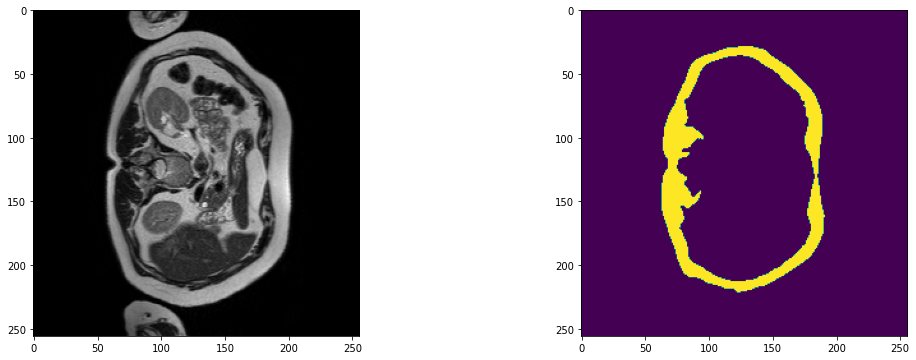

2023-09-14 05:50:09,912 INFO image_writer.py:194 - writing: outMR04_Sep23/A002_v2_T2W_seg.nii.gz


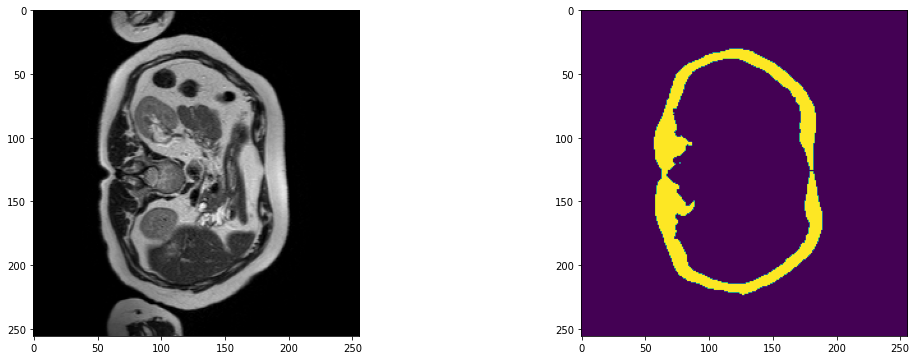

2023-09-14 05:50:12,128 INFO image_writer.py:194 - writing: outMR04_Sep23/A002_v3_T2W_seg.nii.gz


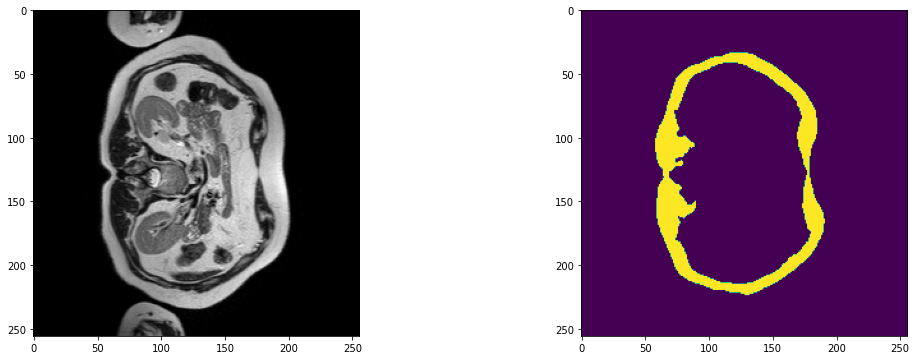

2023-09-14 05:50:14,306 INFO image_writer.py:194 - writing: outMR04_Sep23/A002_v4_T2W_seg.nii.gz


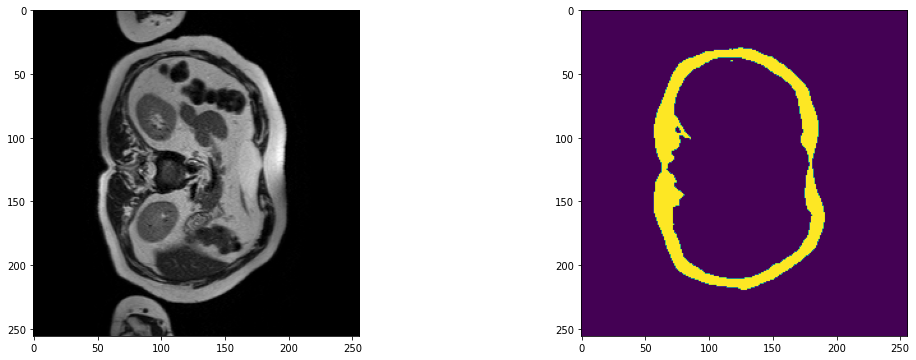

2023-09-14 05:50:16,541 INFO image_writer.py:194 - writing: outMR04_Sep23/A002_v5_T2W_seg.nii.gz


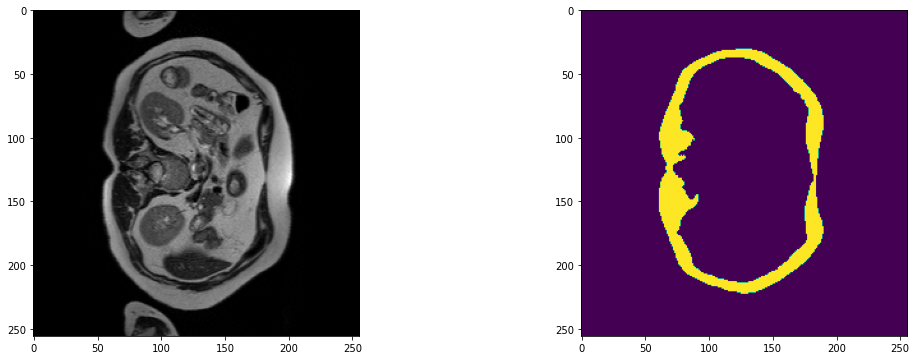

2023-09-14 05:50:18,793 INFO image_writer.py:194 - writing: outMR04_Sep23/A003_v1_T2W_seg.nii.gz


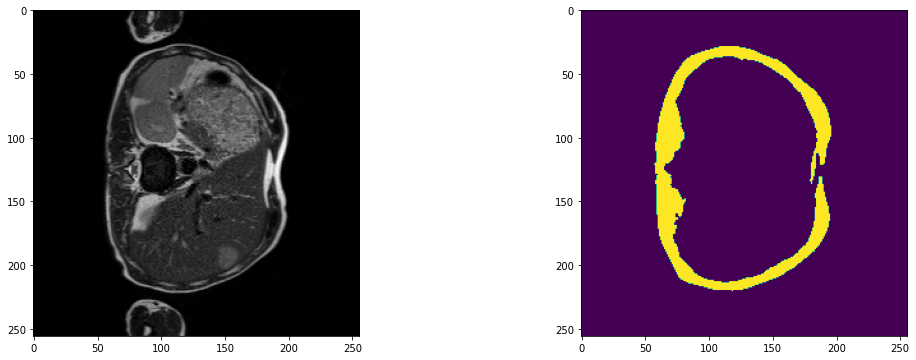

2023-09-14 05:50:21,029 INFO image_writer.py:194 - writing: outMR04_Sep23/A003_v2_T2W_seg.nii.gz


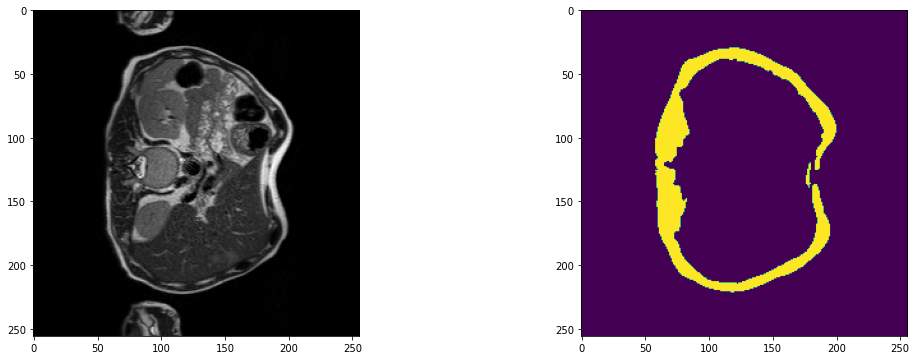

2023-09-14 05:50:23,225 INFO image_writer.py:194 - writing: outMR04_Sep23/A003_v3_T2W_seg.nii.gz


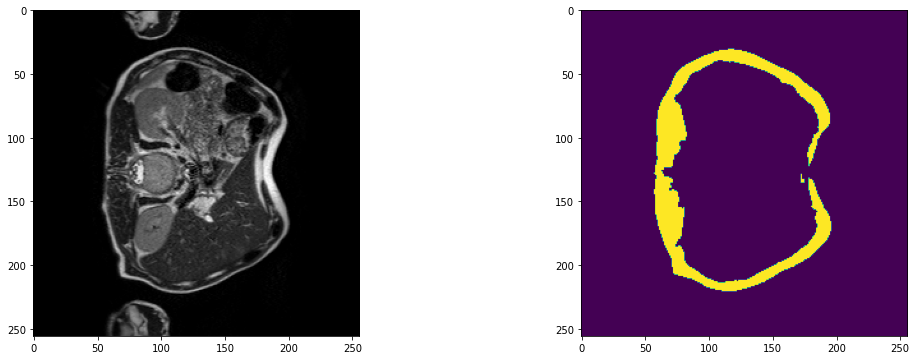

2023-09-14 05:50:25,438 INFO image_writer.py:194 - writing: outMR04_Sep23/A003_v4_T2W_seg.nii.gz


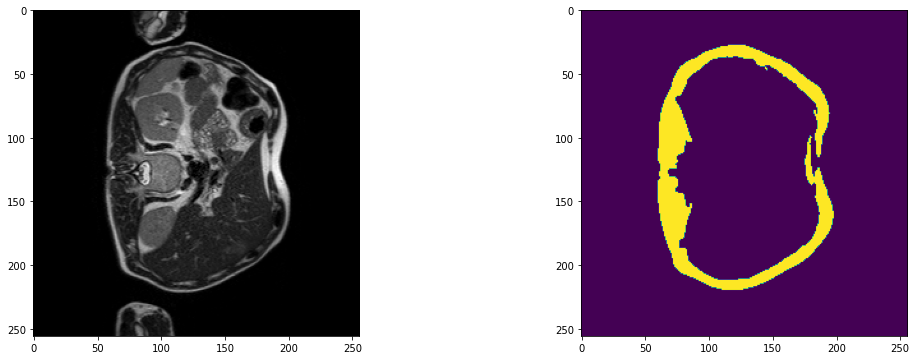

2023-09-14 05:50:27,841 INFO image_writer.py:194 - writing: outMR04_Sep23/A003_v5_T2W_seg.nii.gz


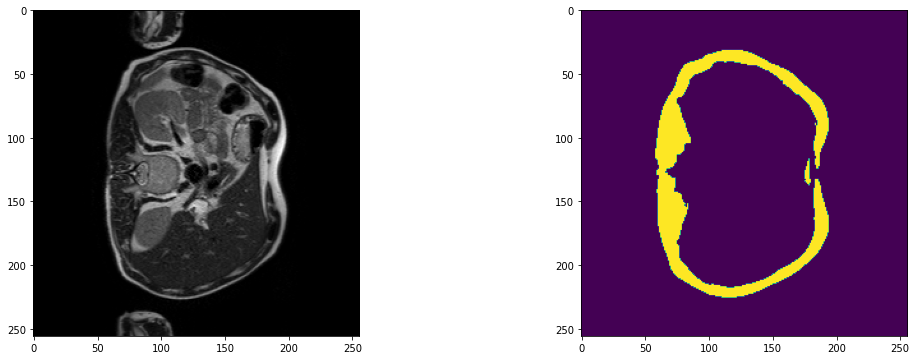

2023-09-14 05:50:30,050 INFO image_writer.py:194 - writing: outMR04_Sep23/A003_v6_T2W_seg.nii.gz


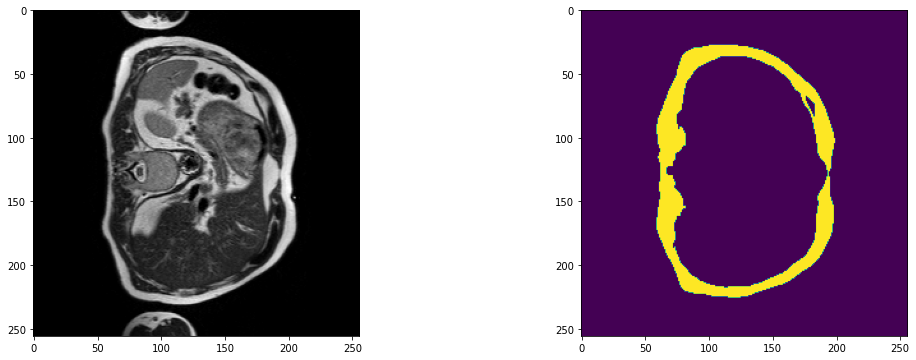

2023-09-14 05:50:32,266 INFO image_writer.py:194 - writing: outMR04_Sep23/A003_v7_T2W_seg.nii.gz


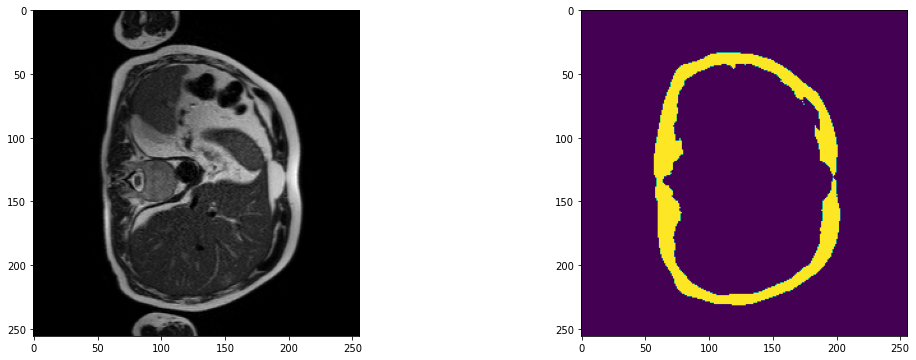

2023-09-14 05:50:34,504 INFO image_writer.py:194 - writing: outMR04_Sep23/A009_v1_T2W_seg.nii.gz


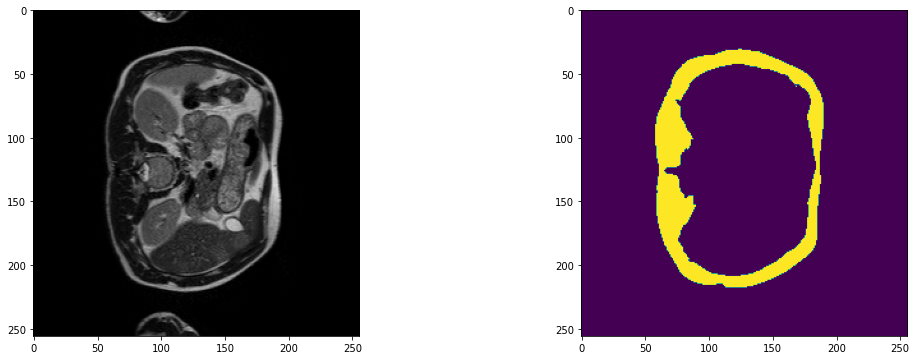

2023-09-14 05:50:36,740 INFO image_writer.py:194 - writing: outMR04_Sep23/A009_v2_T2W_seg.nii.gz


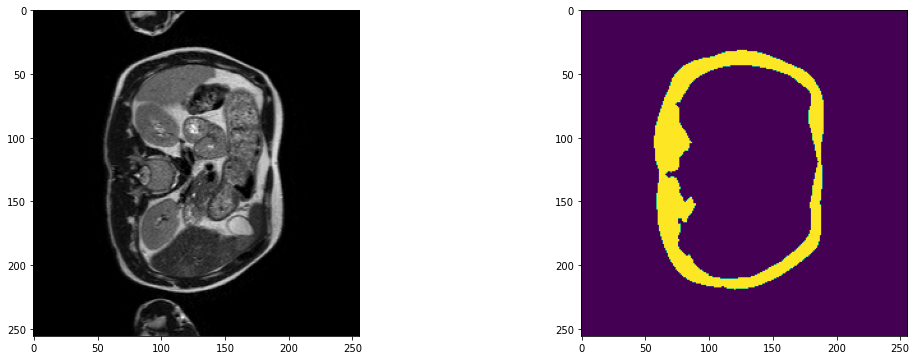

2023-09-14 05:50:38,967 INFO image_writer.py:194 - writing: outMR04_Sep23/A009_v3_T2W_seg.nii.gz


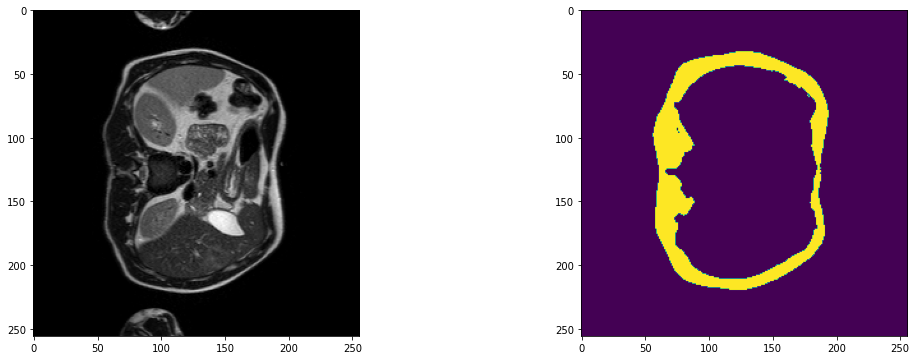

2023-09-14 05:50:41,215 INFO image_writer.py:194 - writing: outMR04_Sep23/A009_v4_T2W_seg.nii.gz


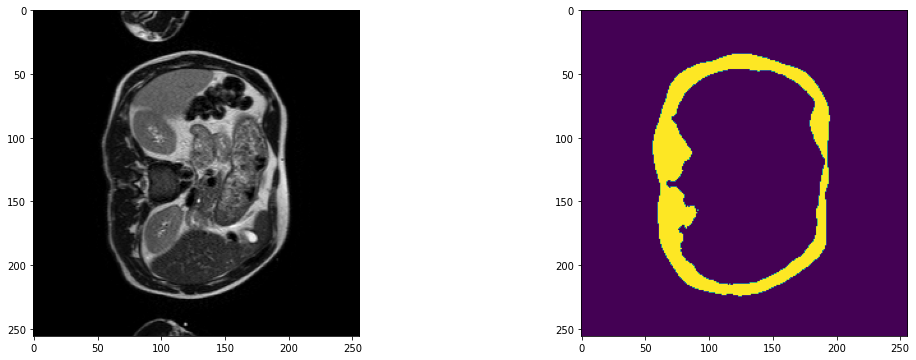

2023-09-14 05:50:43,450 INFO image_writer.py:194 - writing: outMR04_Sep23/A009_v5_T2W_seg.nii.gz


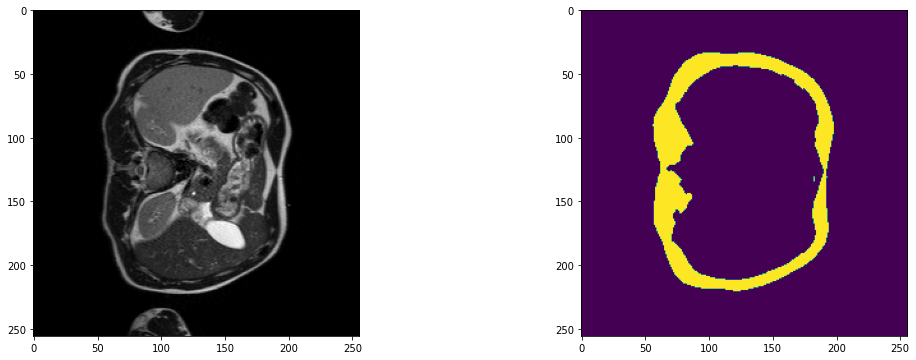

2023-09-14 05:50:45,687 INFO image_writer.py:194 - writing: outMR04_Sep23/A009_v6_T2W_seg.nii.gz


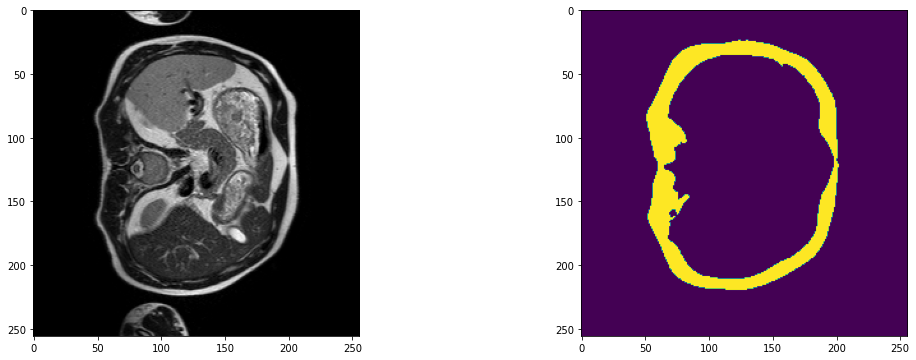

2023-09-14 05:50:47,917 INFO image_writer.py:194 - writing: outMR04_Sep23/A011_v1_T2W_seg.nii.gz


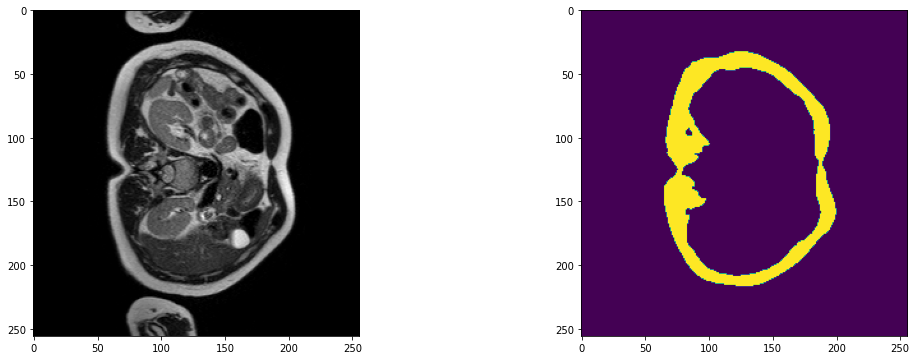

2023-09-14 05:50:50,160 INFO image_writer.py:194 - writing: outMR04_Sep23/A011_v2_T2W_seg.nii.gz


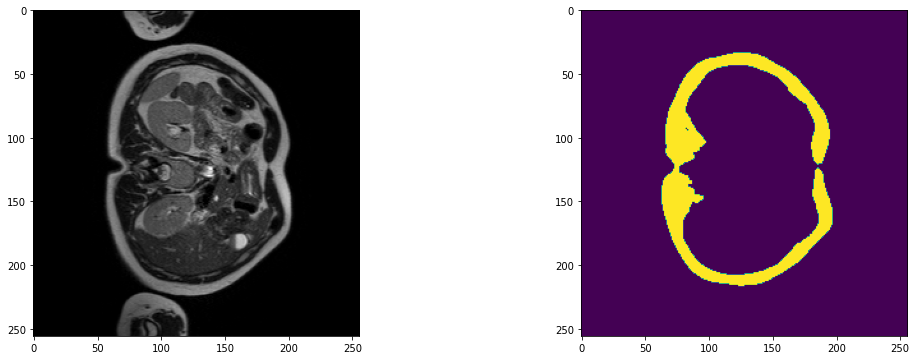

2023-09-14 05:50:52,429 INFO image_writer.py:194 - writing: outMR04_Sep23/A011_v3_T2W_seg.nii.gz


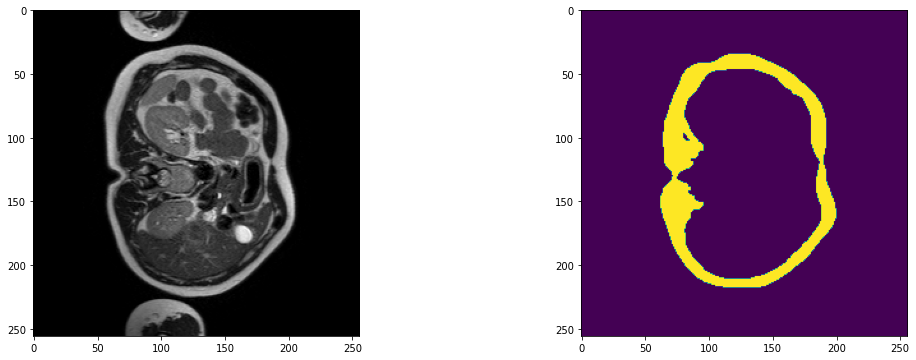

2023-09-14 05:50:54,662 INFO image_writer.py:194 - writing: outMR04_Sep23/A011_v4_T2W_seg.nii.gz


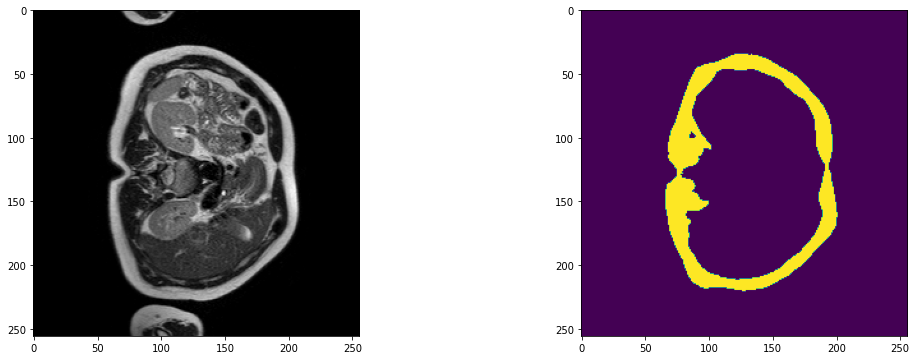

2023-09-14 05:50:57,057 INFO image_writer.py:194 - writing: outMR04_Sep23/A011_v5_T2W_seg.nii.gz


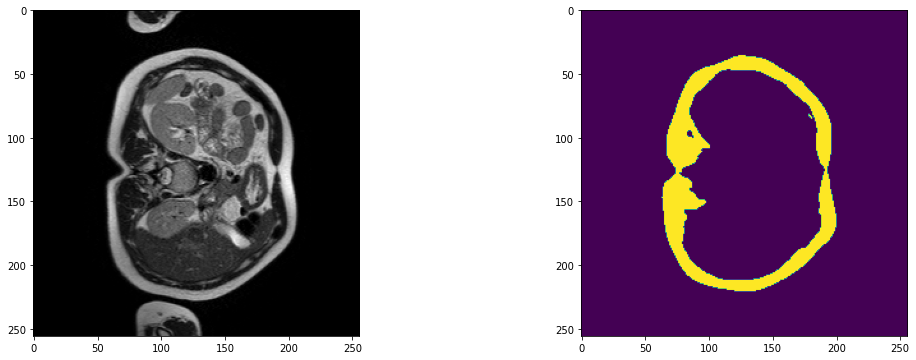

2023-09-14 05:50:59,294 INFO image_writer.py:194 - writing: outMR04_Sep23/A011_v6_T2W_seg.nii.gz


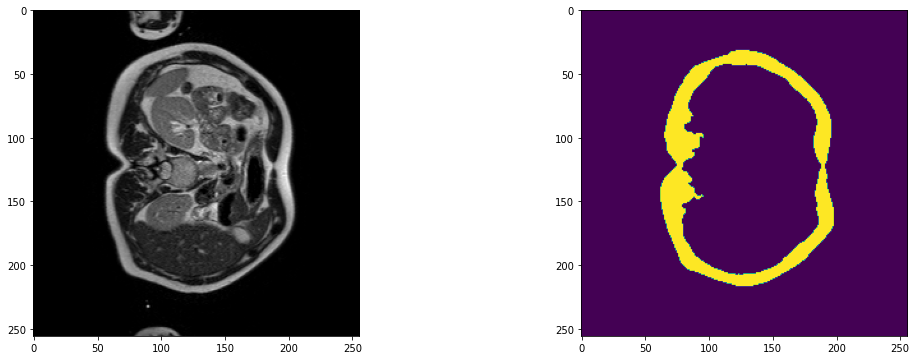

2023-09-14 05:51:01,604 INFO image_writer.py:194 - writing: outMR04_Sep23/A011_v7_T2W_seg.nii.gz


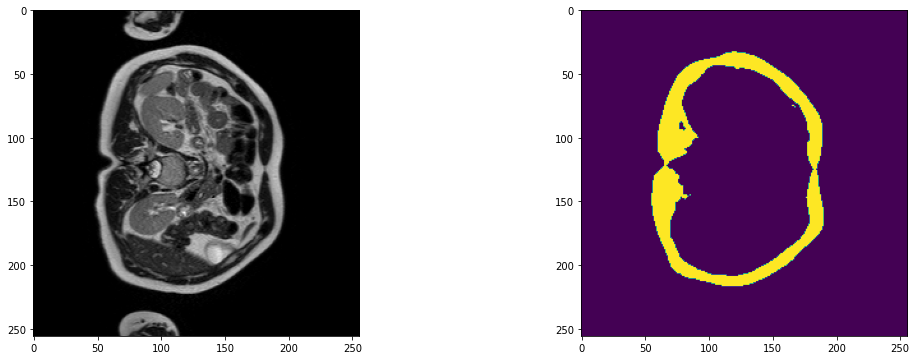

2023-09-14 05:51:03,919 INFO image_writer.py:194 - writing: outMR04_Sep23/A011_v8_T2W_seg.nii.gz


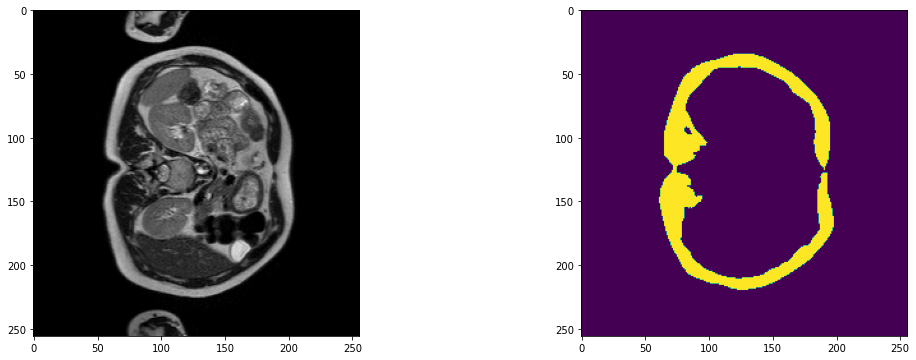

2023-09-14 05:51:06,172 INFO image_writer.py:194 - writing: outMR04_Sep23/A011_v9_T2W_seg.nii.gz


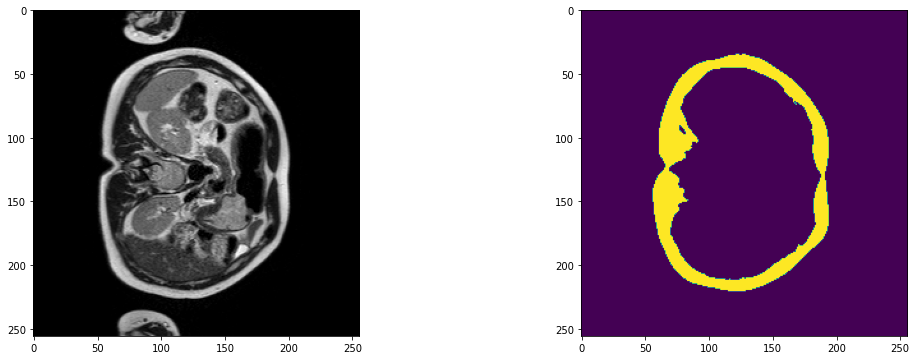

2023-09-14 05:51:08,439 INFO image_writer.py:194 - writing: outMR04_Sep23/A013_v1_T2W_seg.nii.gz


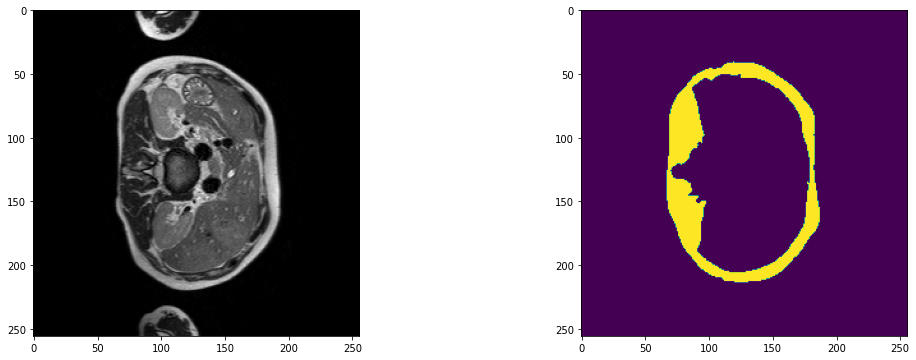

2023-09-14 05:51:10,427 INFO image_writer.py:194 - writing: outMR04_Sep23/A013_v2_T2W_seg.nii.gz


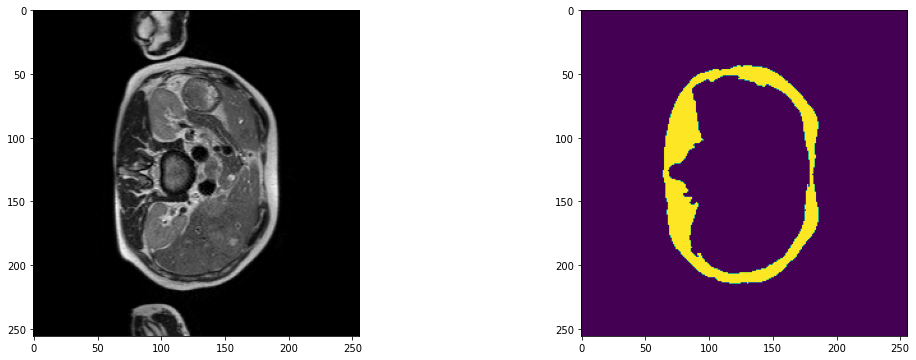

2023-09-14 05:51:12,431 INFO image_writer.py:194 - writing: outMR04_Sep23/A013_v3_T2W_seg.nii.gz


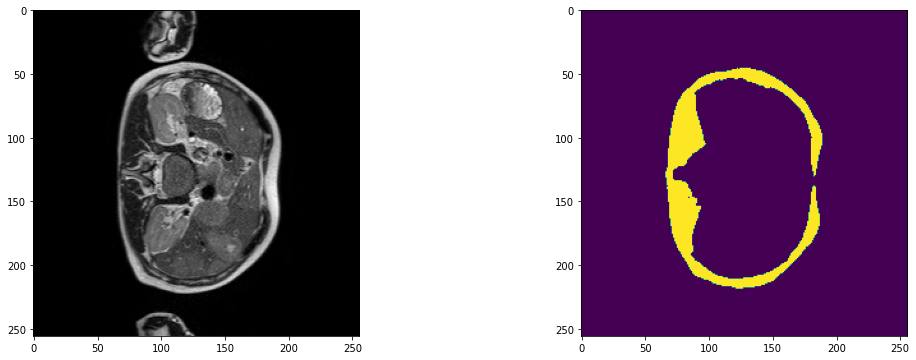

2023-09-14 05:51:14,441 INFO image_writer.py:194 - writing: outMR04_Sep23/A013_v4_T2W_seg.nii.gz


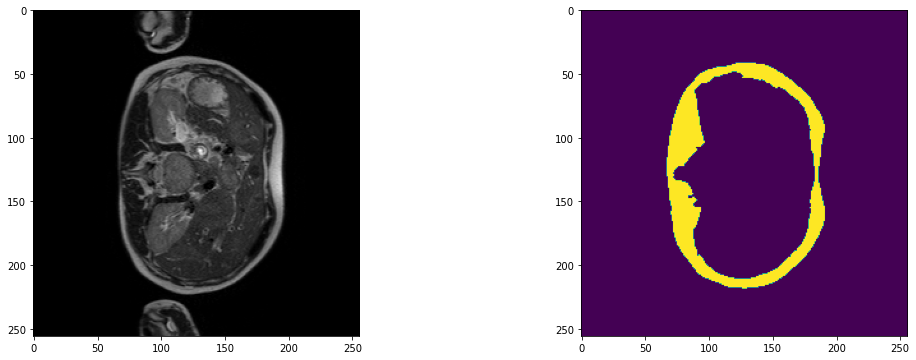

2023-09-14 05:51:16,485 INFO image_writer.py:194 - writing: outMR04_Sep23/A013_v5_T2W_seg.nii.gz


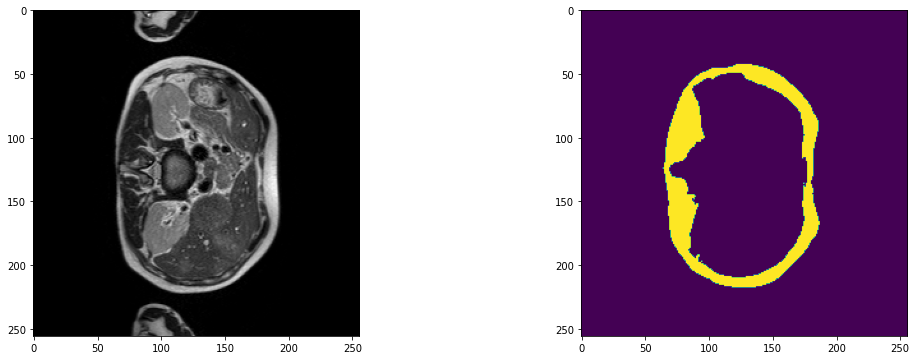

2023-09-14 05:51:18,766 INFO image_writer.py:194 - writing: outMR04_Sep23/A014_v1_T2W_seg.nii.gz


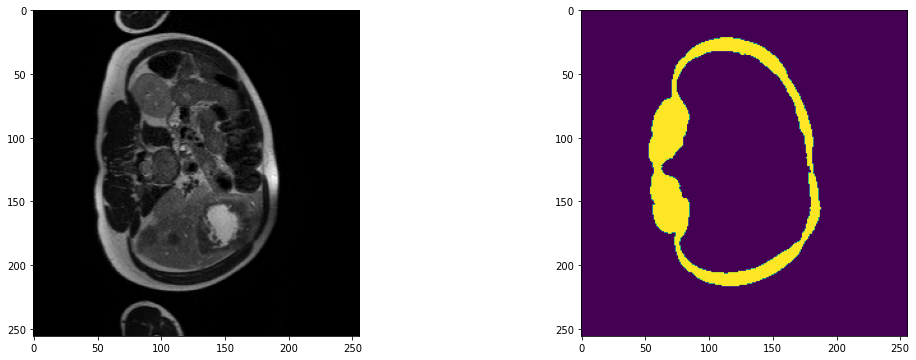

2023-09-14 05:51:21,082 INFO image_writer.py:194 - writing: outMR04_Sep23/A014_v2_T2W_seg.nii.gz


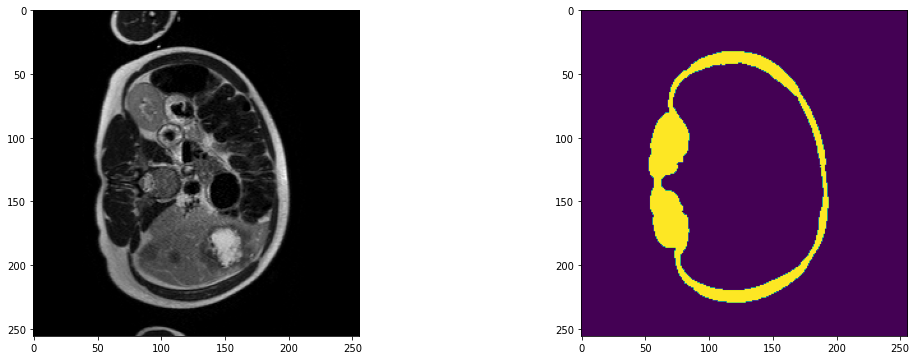

2023-09-14 05:51:23,353 INFO image_writer.py:194 - writing: outMR04_Sep23/A014_v3_T2W_seg.nii.gz


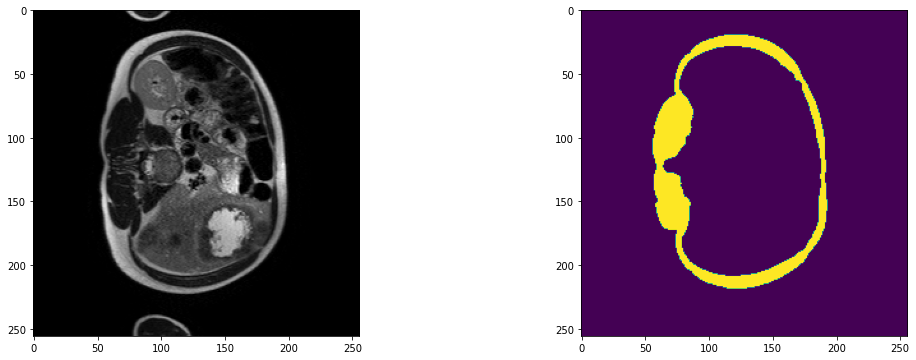

2023-09-14 05:51:25,758 INFO image_writer.py:194 - writing: outMR04_Sep23/A014_v4_T2W_seg.nii.gz


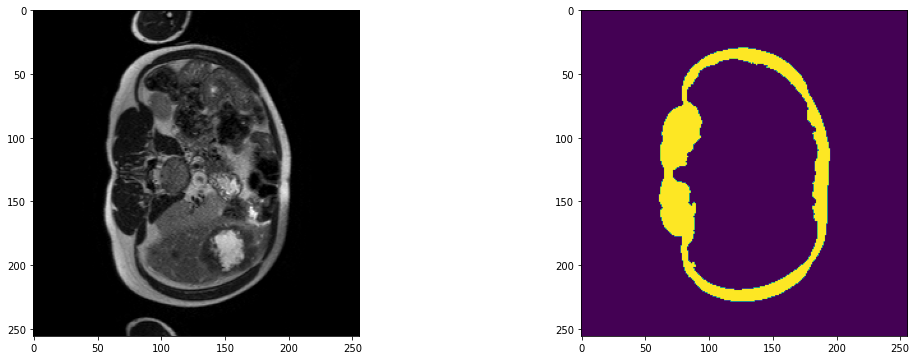

2023-09-14 05:51:28,045 INFO image_writer.py:194 - writing: outMR04_Sep23/A014_v5_T2W_seg.nii.gz


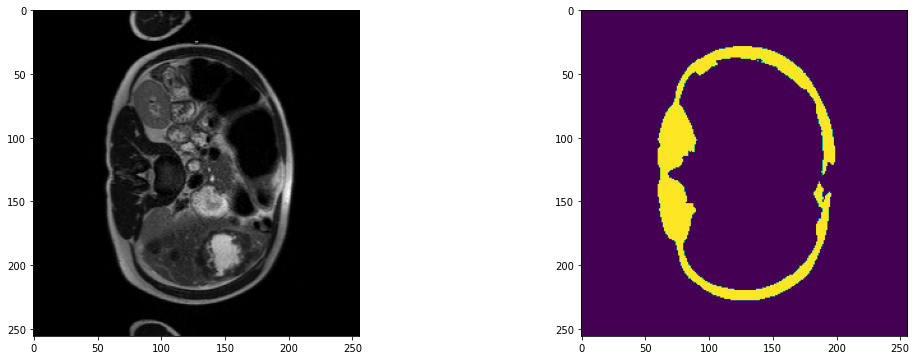

2023-09-14 05:51:30,049 INFO image_writer.py:194 - writing: outMR04_Sep23/A014_v6_T2W_seg.nii.gz


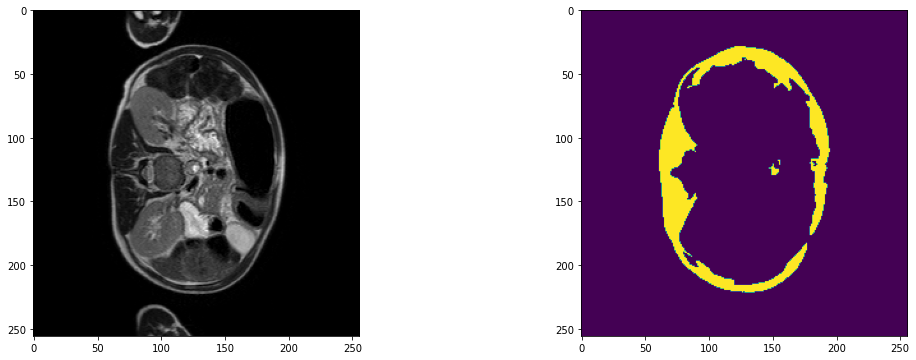

2023-09-14 05:51:32,317 INFO image_writer.py:194 - writing: outMR04_Sep23/A014_v7_T2W_seg.nii.gz


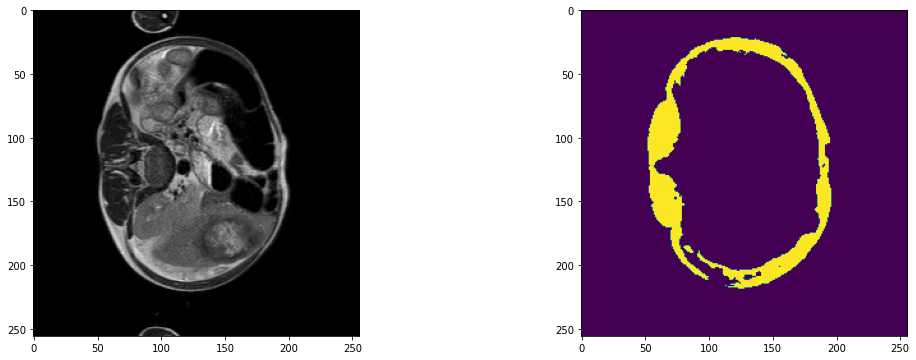

2023-09-14 05:51:34,599 INFO image_writer.py:194 - writing: outMR04_Sep23/A015_v1_T2W_seg.nii.gz


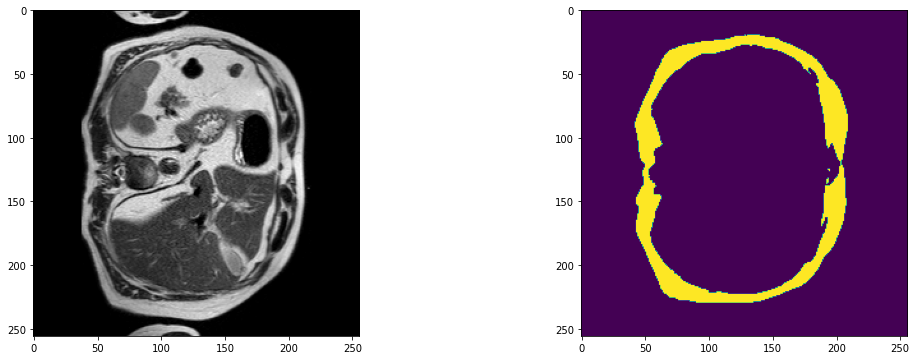

2023-09-14 05:51:36,871 INFO image_writer.py:194 - writing: outMR04_Sep23/A015_v2_T2W_seg.nii.gz


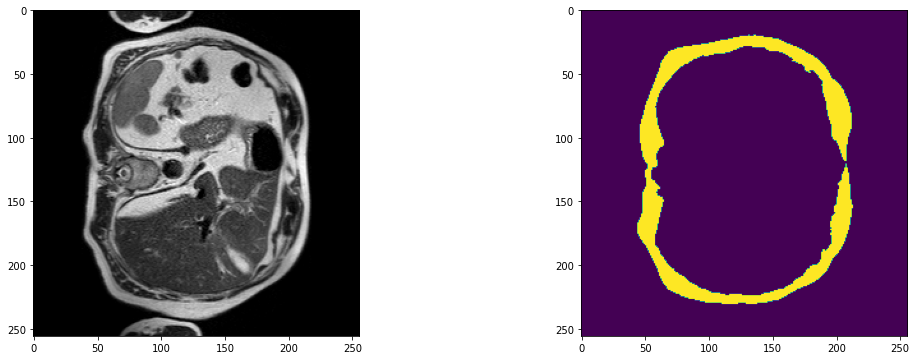

2023-09-14 05:51:39,144 INFO image_writer.py:194 - writing: outMR04_Sep23/A015_v3_T2W_seg.nii.gz


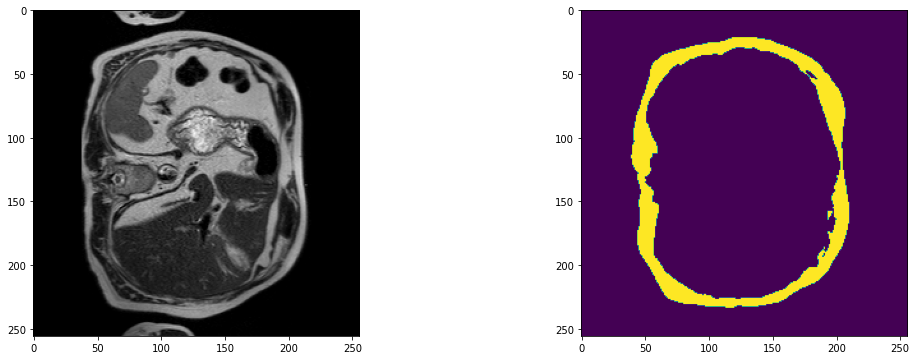

2023-09-14 05:51:41,431 INFO image_writer.py:194 - writing: outMR04_Sep23/A015_v4_T2W_seg.nii.gz


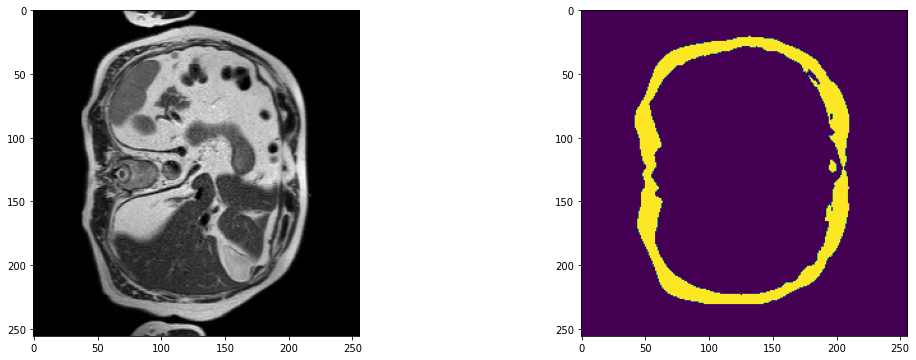

2023-09-14 05:51:43,710 INFO image_writer.py:194 - writing: outMR04_Sep23/A015_v5_T2W_seg.nii.gz


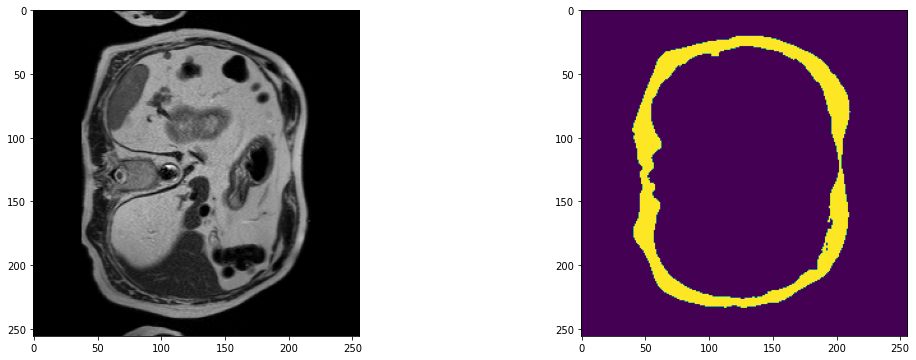

2023-09-14 05:51:45,973 INFO image_writer.py:194 - writing: outMR04_Sep23/A015_v6_T2W_seg.nii.gz


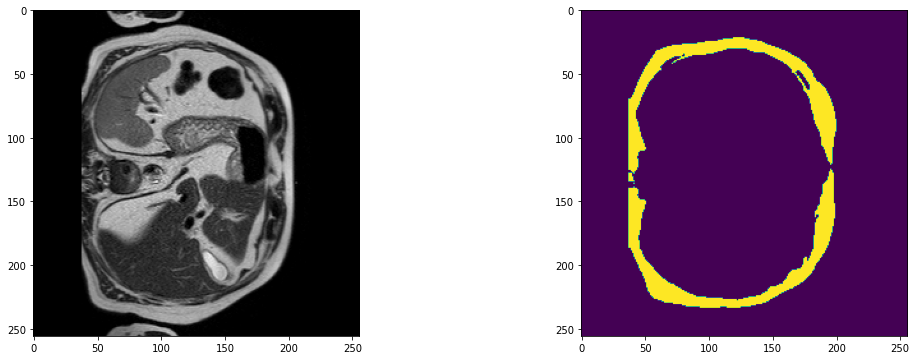

2023-09-14 05:51:48,278 INFO image_writer.py:194 - writing: outMR04_Sep23/A015_v7_T2W_seg.nii.gz


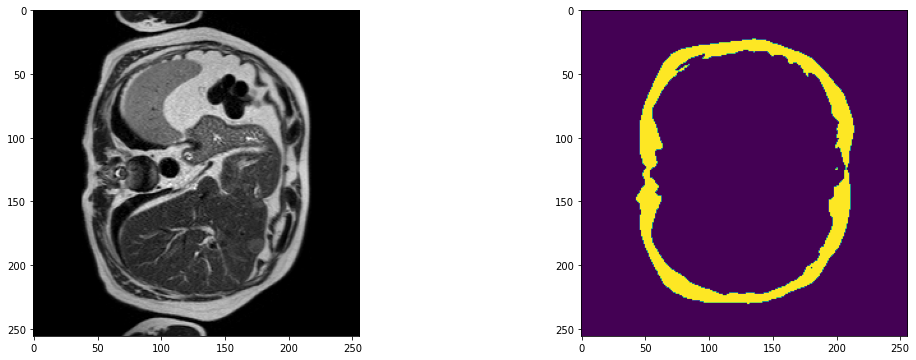

2023-09-14 05:51:50,576 INFO image_writer.py:194 - writing: outMR04_Sep23/A015_v8_T2W_seg.nii.gz


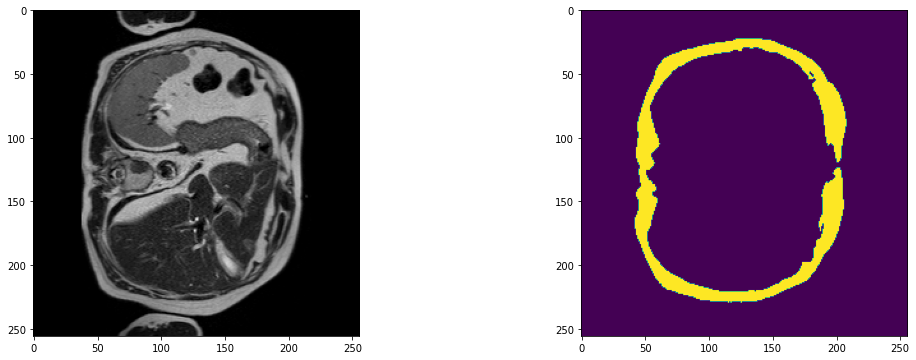

2023-09-14 05:51:52,868 INFO image_writer.py:194 - writing: outMR04_Sep23/A016_v1_T2W_seg.nii.gz


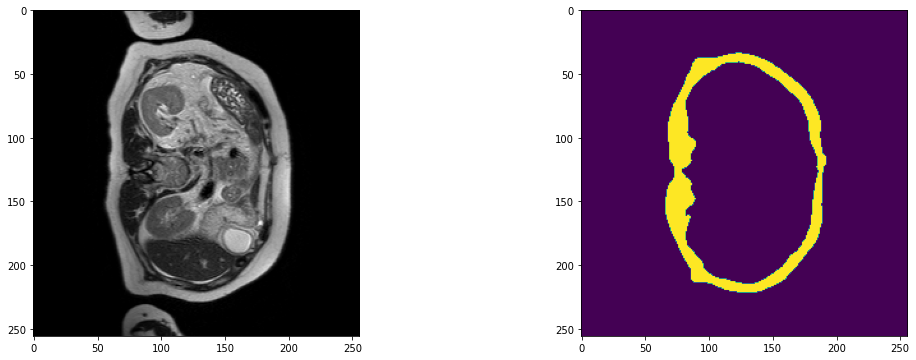

2023-09-14 05:51:55,303 INFO image_writer.py:194 - writing: outMR04_Sep23/A016_v2_T2W_seg.nii.gz


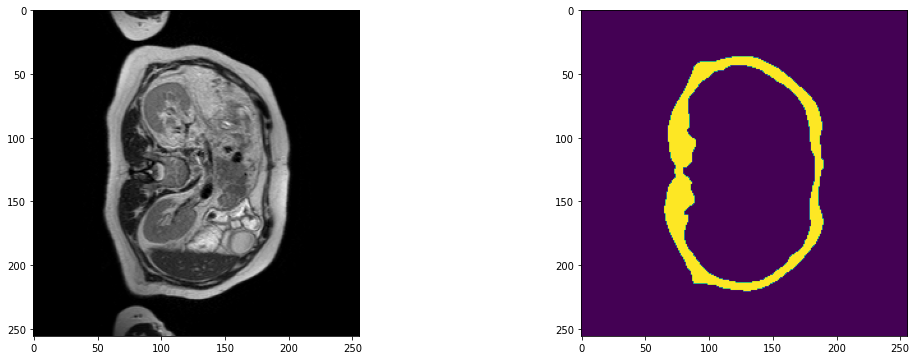

2023-09-14 05:51:57,580 INFO image_writer.py:194 - writing: outMR04_Sep23/A016_v3_T2W_seg.nii.gz


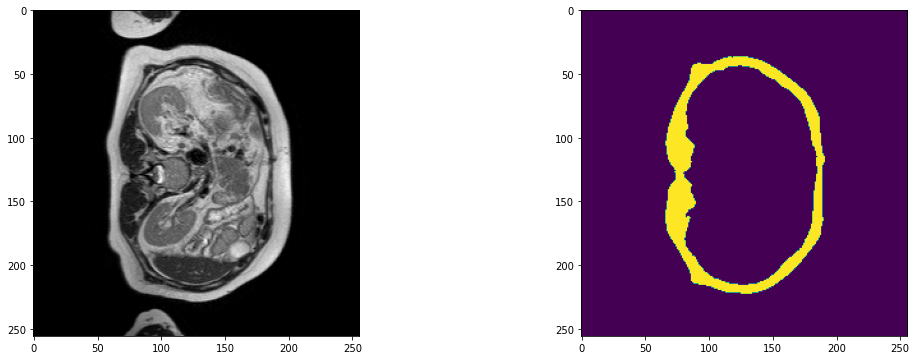

2023-09-14 05:51:59,868 INFO image_writer.py:194 - writing: outMR04_Sep23/A016_v4_T2W_seg.nii.gz


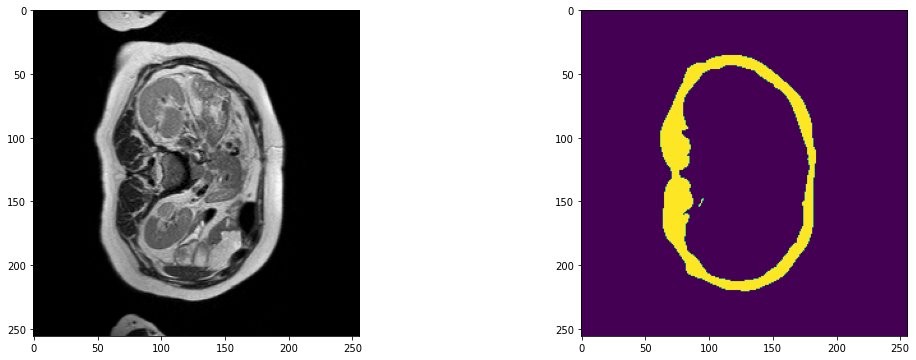

2023-09-14 05:52:02,152 INFO image_writer.py:194 - writing: outMR04_Sep23/A016_v5_T2W_seg.nii.gz


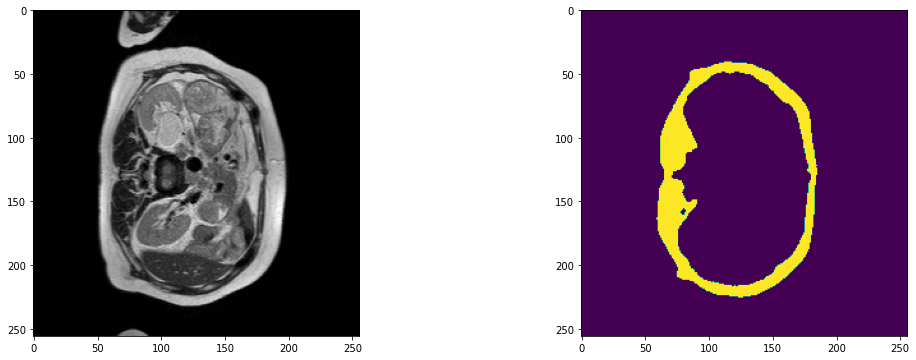

2023-09-14 05:52:04,448 INFO image_writer.py:194 - writing: outMR04_Sep23/A016_v6_T2W_seg.nii.gz


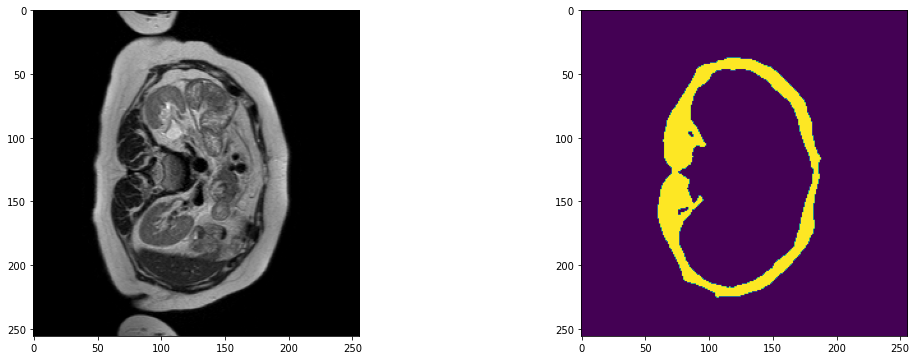

2023-09-14 05:52:06,739 INFO image_writer.py:194 - writing: outMR04_Sep23/A016_v7_T2W_seg.nii.gz


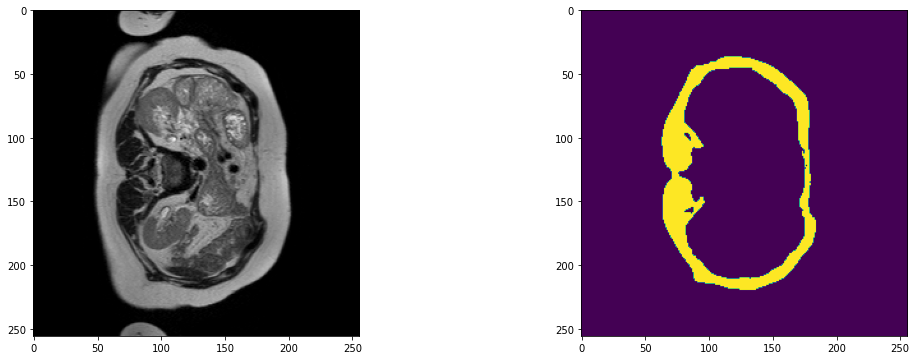

2023-09-14 05:52:09,015 INFO image_writer.py:194 - writing: outMR04_Sep23/A017_v1_T2W_seg.nii.gz


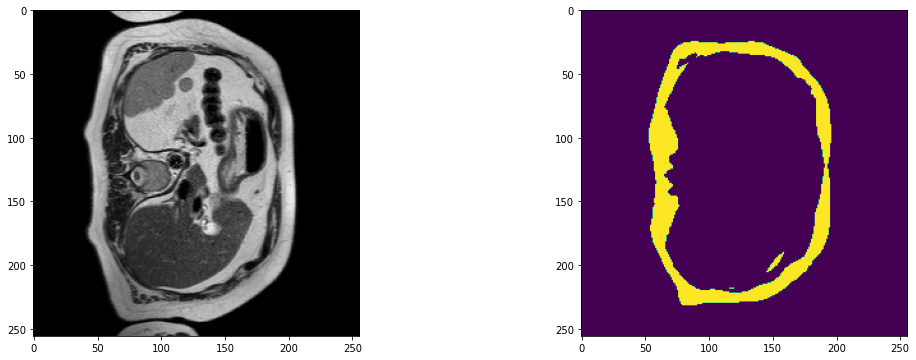

2023-09-14 05:52:11,301 INFO image_writer.py:194 - writing: outMR04_Sep23/A017_v2_T2W_seg.nii.gz


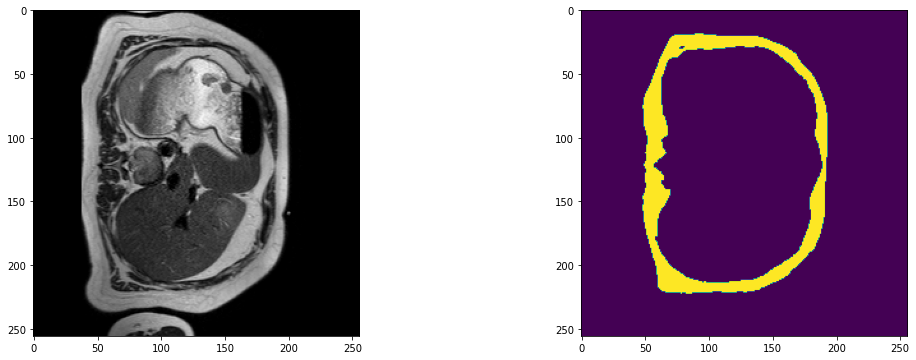

2023-09-14 05:52:13,599 INFO image_writer.py:194 - writing: outMR04_Sep23/A017_v3_T2W_seg.nii.gz


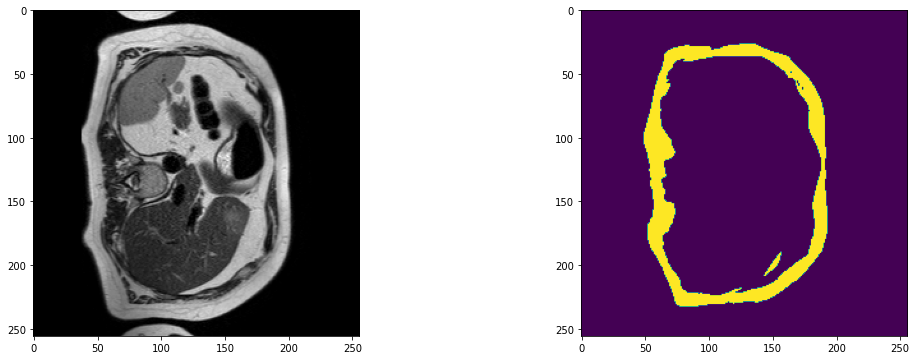

2023-09-14 05:52:15,895 INFO image_writer.py:194 - writing: outMR04_Sep23/A017_v4_T2W_seg.nii.gz


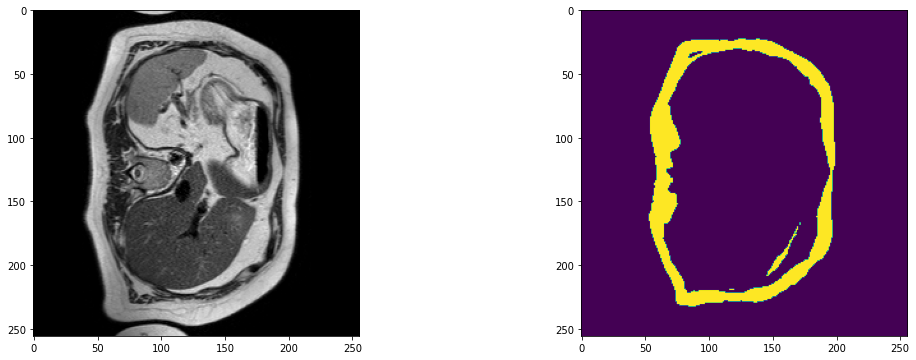

2023-09-14 05:52:18,165 INFO image_writer.py:194 - writing: outMR04_Sep23/A017_v5_T2W_seg.nii.gz


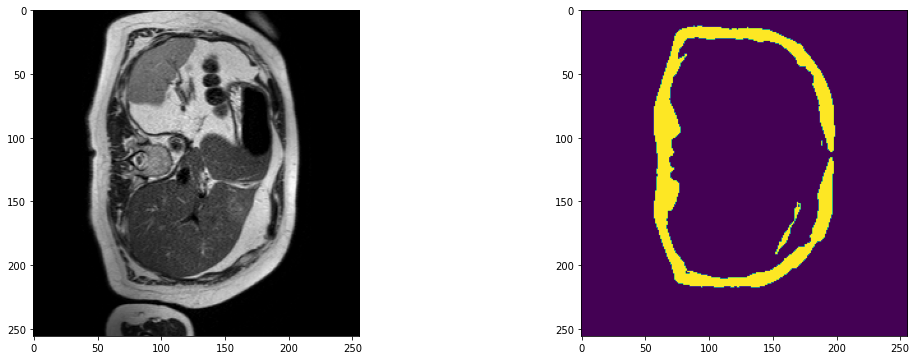

2023-09-14 05:52:20,457 INFO image_writer.py:194 - writing: outMR04_Sep23/A017_v6_T2W_seg.nii.gz


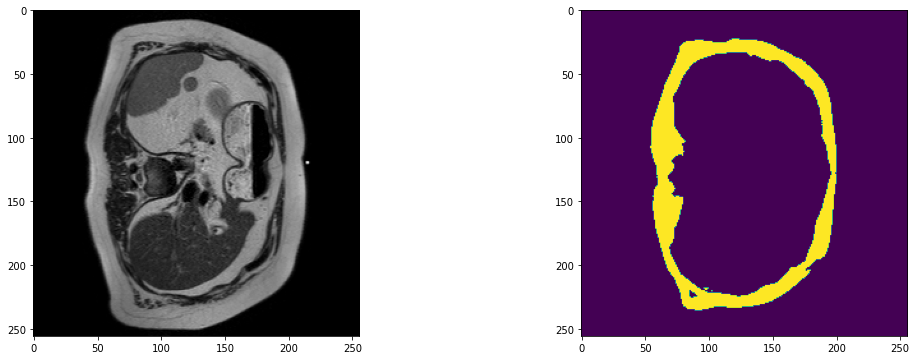

2023-09-14 05:52:22,762 INFO image_writer.py:194 - writing: outMR04_Sep23/A017_v7_T2W_seg.nii.gz


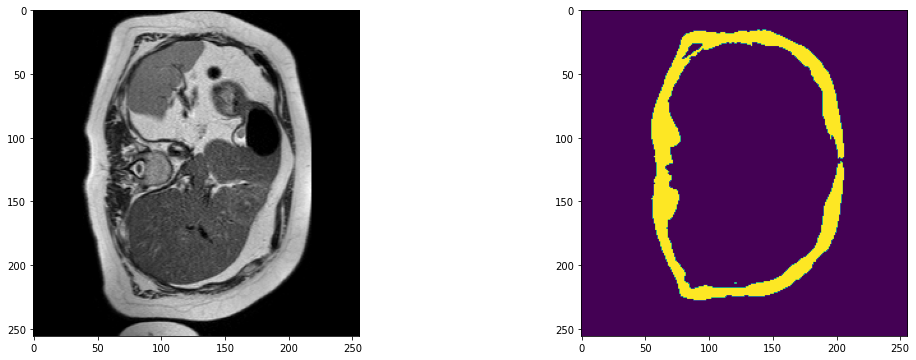

2023-09-14 05:52:25,184 INFO image_writer.py:194 - writing: outMR04_Sep23/A018_v1_T2W_seg.nii.gz


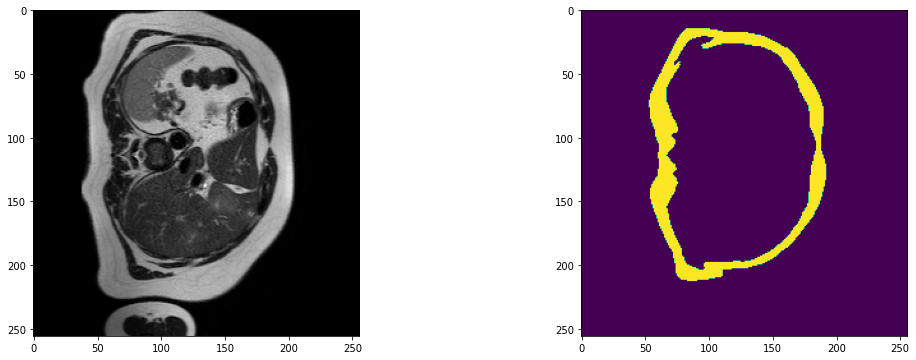

2023-09-14 05:52:27,473 INFO image_writer.py:194 - writing: outMR04_Sep23/A018_v2_T2W_seg.nii.gz


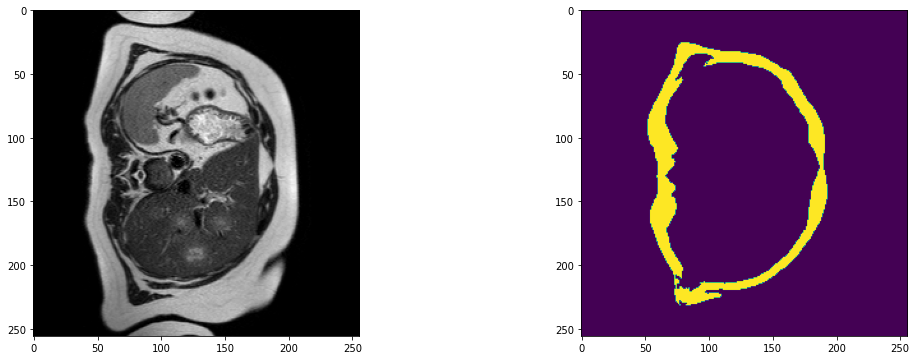

2023-09-14 05:52:29,789 INFO image_writer.py:194 - writing: outMR04_Sep23/A018_v3_T2W_seg.nii.gz


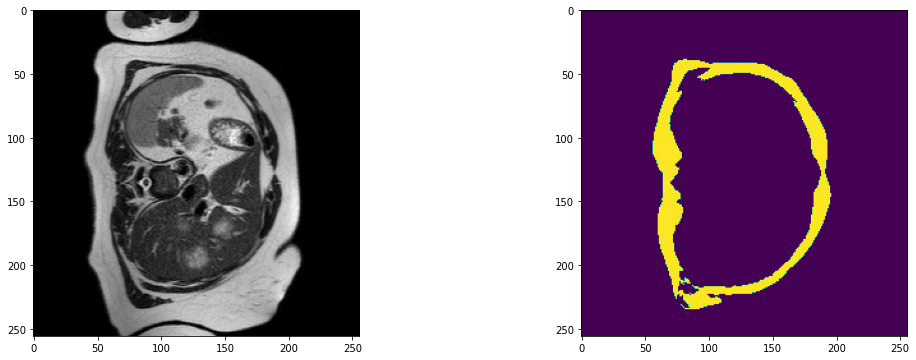

2023-09-14 05:52:32,073 INFO image_writer.py:194 - writing: outMR04_Sep23/A018_v4_T2W_seg.nii.gz


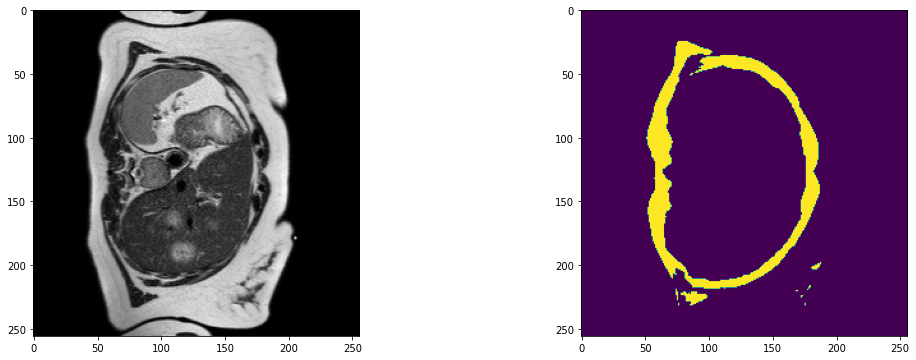

2023-09-14 05:52:34,364 INFO image_writer.py:194 - writing: outMR04_Sep23/A018_v5_T2W_seg.nii.gz


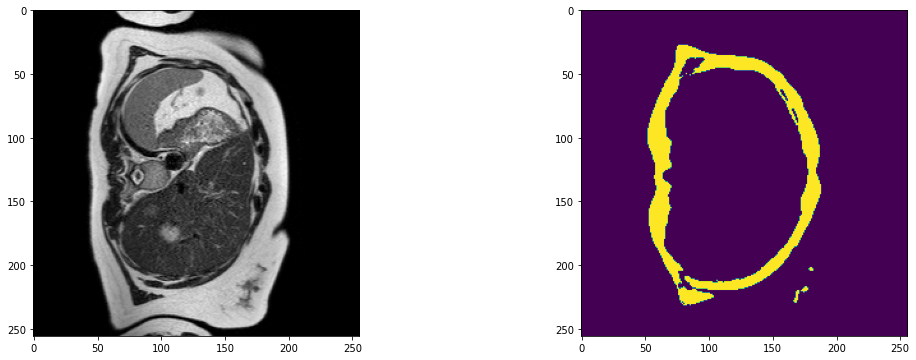

2023-09-14 05:52:36,640 INFO image_writer.py:194 - writing: outMR04_Sep23/A018_v6_T2W_seg.nii.gz


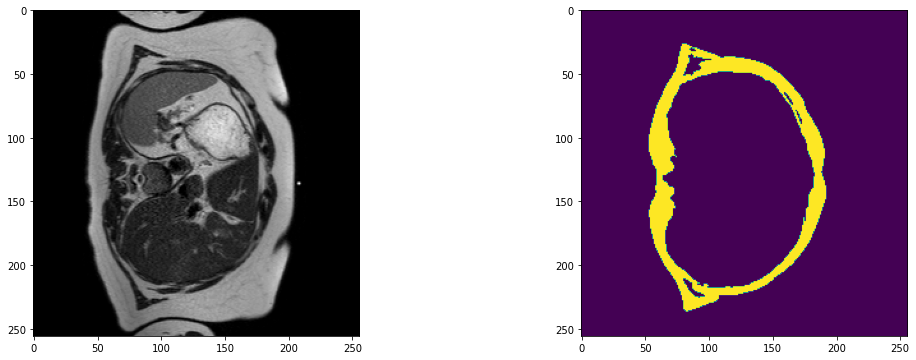

2023-09-14 05:52:38,936 INFO image_writer.py:194 - writing: outMR04_Sep23/A018_v7_T2W_seg.nii.gz


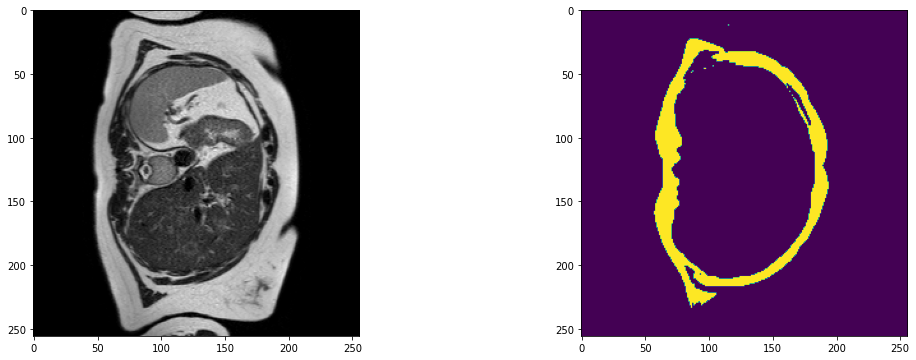

2023-09-14 05:52:41,241 INFO image_writer.py:194 - writing: outMR04_Sep23/A021_v1_T2W_seg.nii.gz


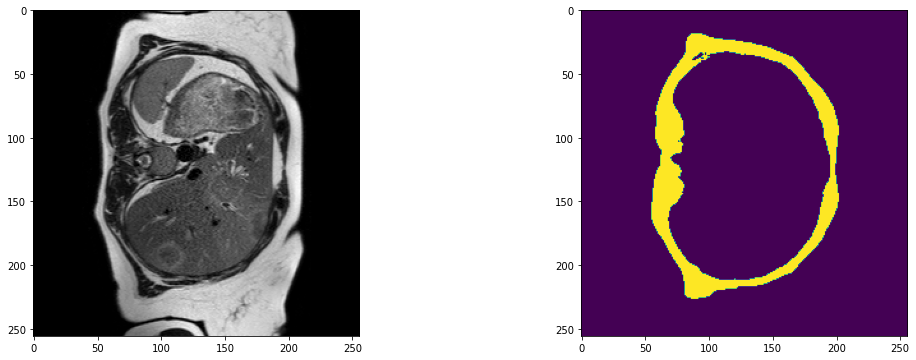

2023-09-14 05:52:43,554 INFO image_writer.py:194 - writing: outMR04_Sep23/A021_v2_T2W_seg.nii.gz


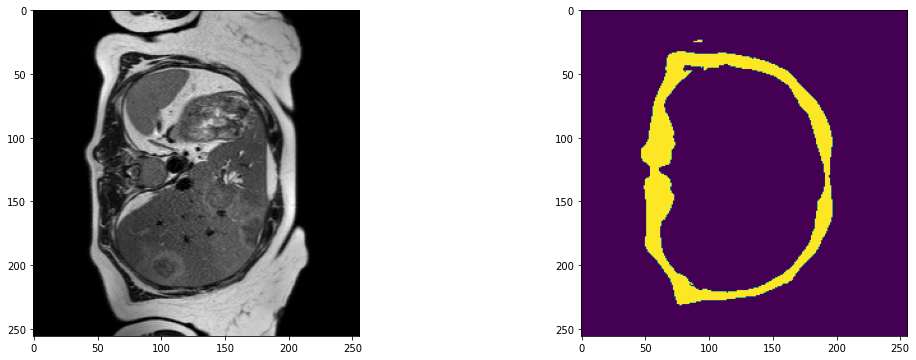

2023-09-14 05:52:45,872 INFO image_writer.py:194 - writing: outMR04_Sep23/A021_v3_T2W_seg.nii.gz


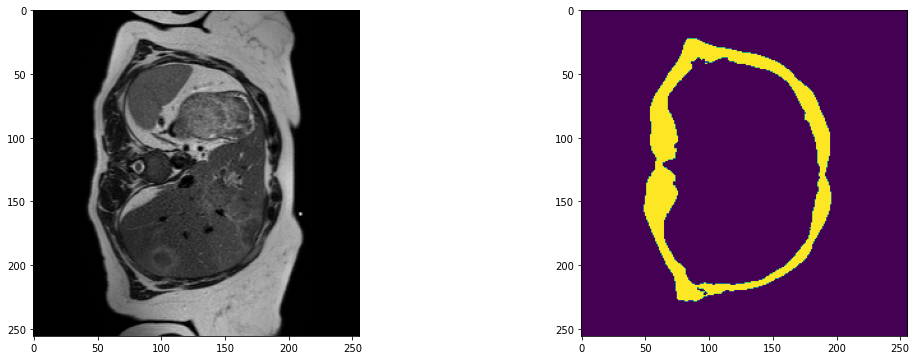

2023-09-14 05:52:48,162 INFO image_writer.py:194 - writing: outMR04_Sep23/A021_v4_T2W_seg.nii.gz


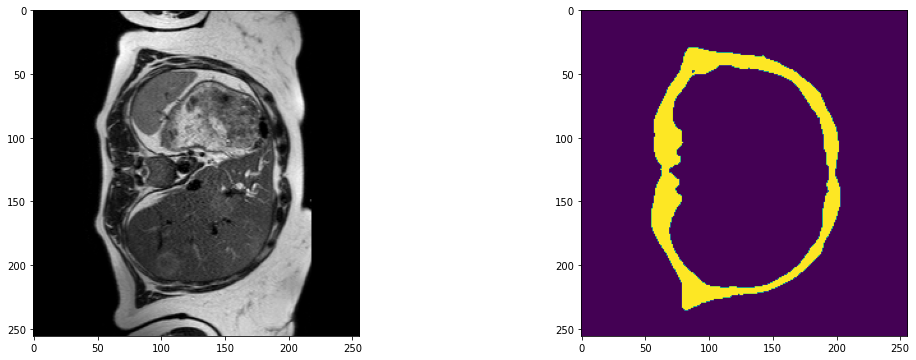

2023-09-14 05:52:50,480 INFO image_writer.py:194 - writing: outMR04_Sep23/A021_v5_T2W_seg.nii.gz


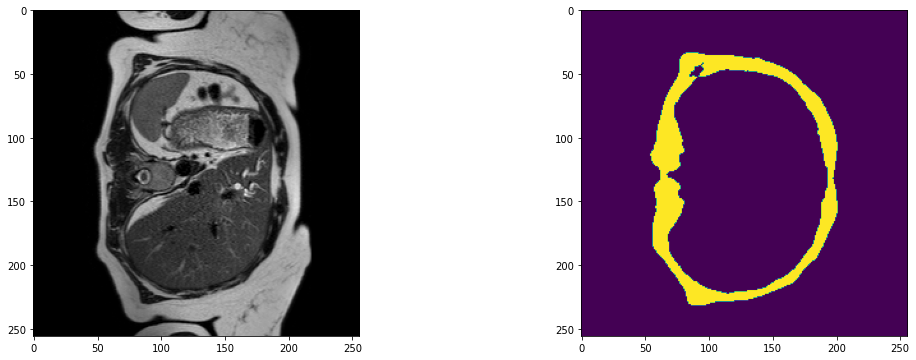

2023-09-14 05:52:52,792 INFO image_writer.py:194 - writing: outMR04_Sep23/A021_v6_T2W_seg.nii.gz


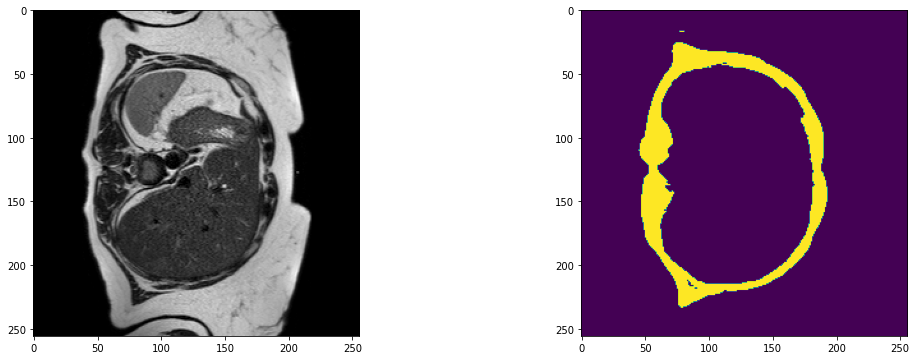

2023-09-14 05:52:55,220 INFO image_writer.py:194 - writing: outMR04_Sep23/A021_v7_T2W_seg.nii.gz


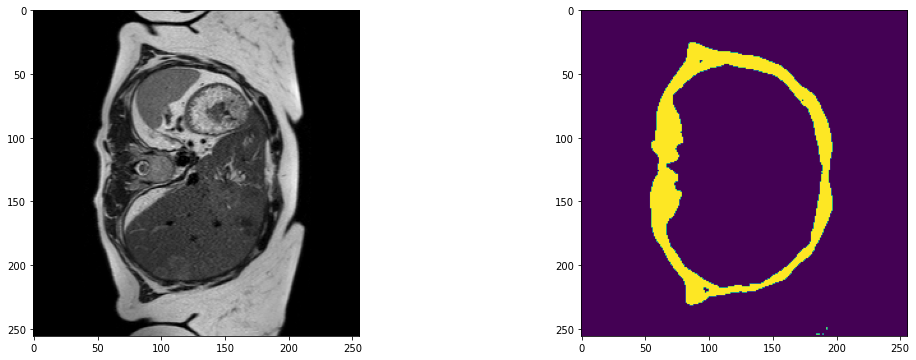

2023-09-14 05:53:00,874 INFO image_writer.py:194 - writing: outMR04_Sep23/A022_v1_T2W_seg.nii.gz


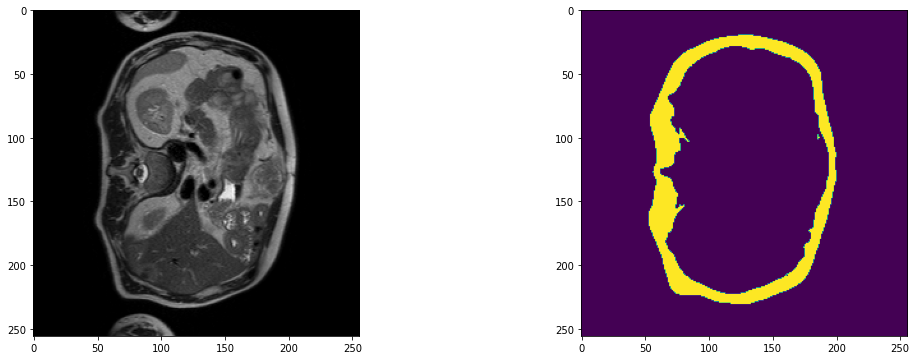

2023-09-14 05:53:06,578 INFO image_writer.py:194 - writing: outMR04_Sep23/A022_v2_T2W_seg.nii.gz


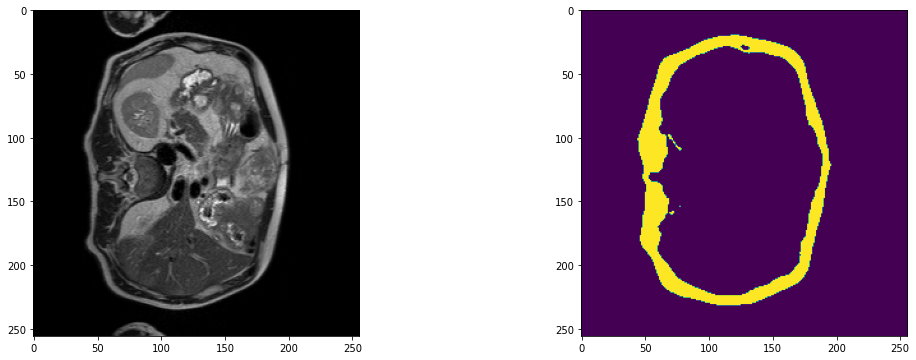

2023-09-14 05:53:12,229 INFO image_writer.py:194 - writing: outMR04_Sep23/A022_v3_T2W_seg.nii.gz


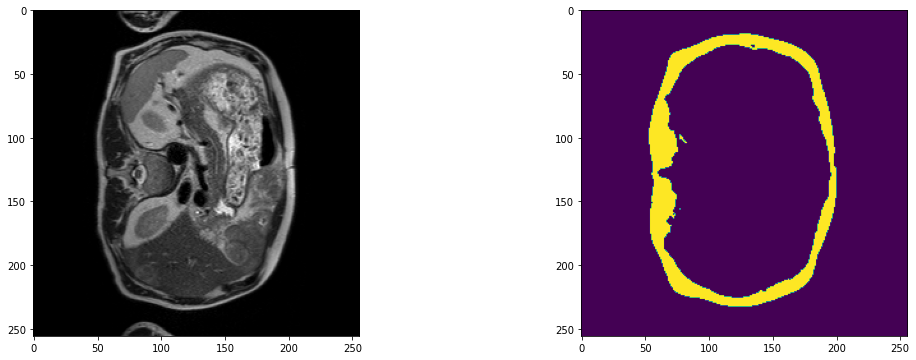

2023-09-14 05:53:17,892 INFO image_writer.py:194 - writing: outMR04_Sep23/A022_v4_T2W_seg.nii.gz


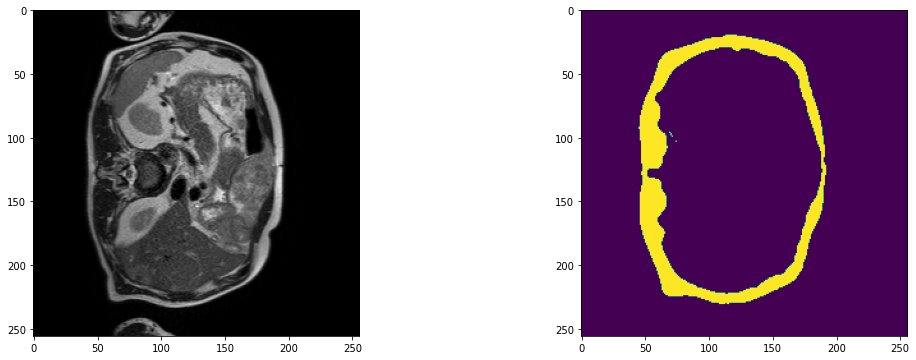

2023-09-14 05:53:23,565 INFO image_writer.py:194 - writing: outMR04_Sep23/A022_v5_T2W_seg.nii.gz


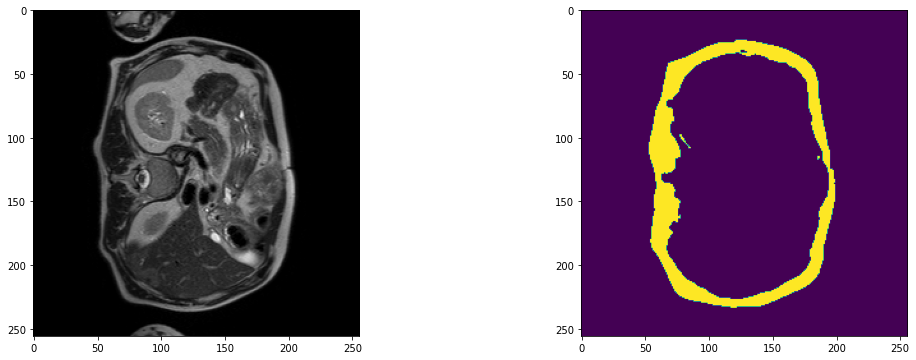

2023-09-14 05:53:29,254 INFO image_writer.py:194 - writing: outMR04_Sep23/A022_v6_T2W_seg.nii.gz


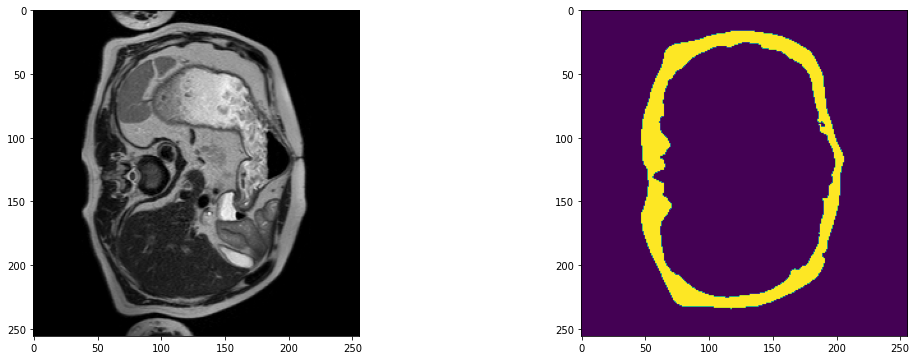

2023-09-14 05:53:34,949 INFO image_writer.py:194 - writing: outMR04_Sep23/A022_v7_T2W_seg.nii.gz


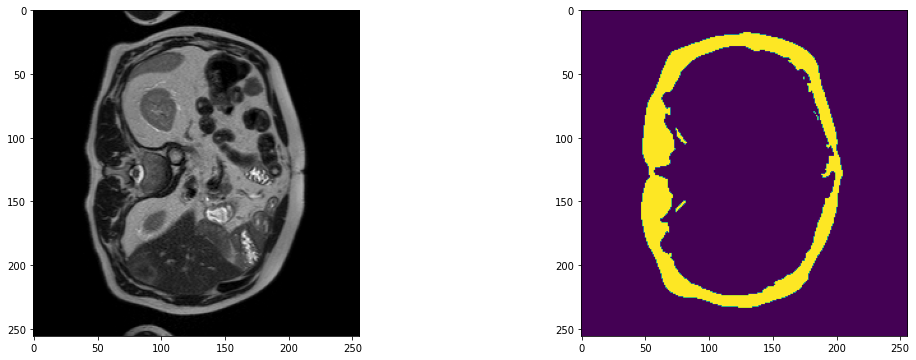

2023-09-14 05:53:40,647 INFO image_writer.py:194 - writing: outMR04_Sep23/A022_v8_T2W_seg.nii.gz


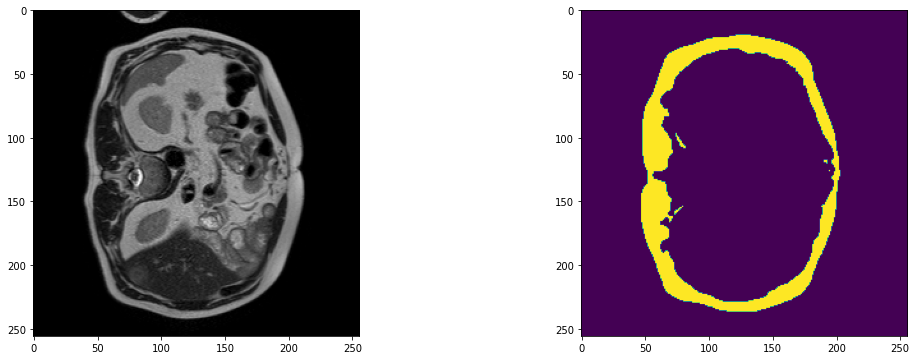

2023-09-14 05:53:46,397 INFO image_writer.py:194 - writing: outMR04_Sep23/A022_v9_T2W_seg.nii.gz


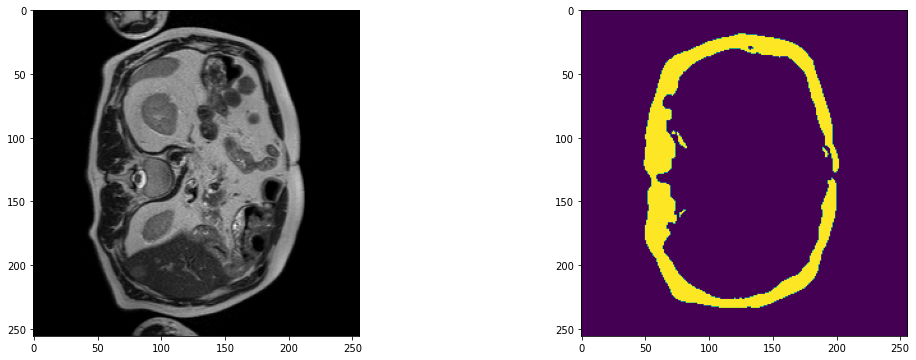

2023-09-14 05:53:48,737 INFO image_writer.py:194 - writing: outMR04_Sep23/A024_v1_T2W_seg.nii.gz


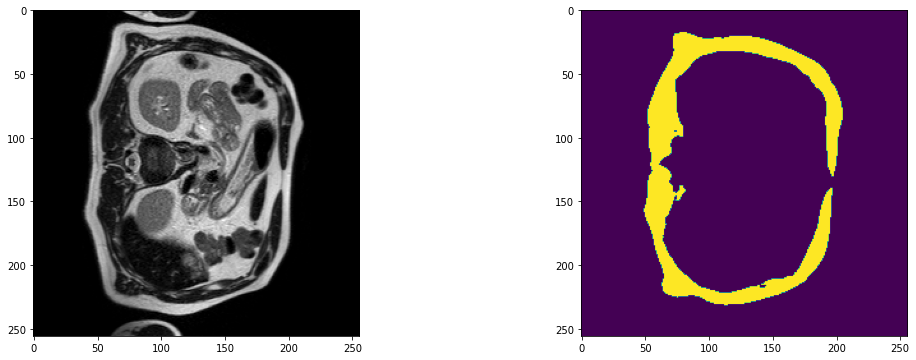

2023-09-14 05:53:51,038 INFO image_writer.py:194 - writing: outMR04_Sep23/A024_v2_T2W_seg.nii.gz


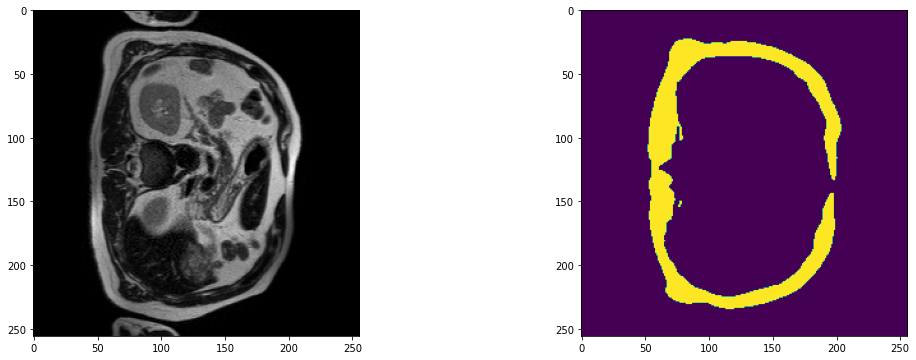

2023-09-14 05:53:53,371 INFO image_writer.py:194 - writing: outMR04_Sep23/A024_v3_T2W_seg.nii.gz


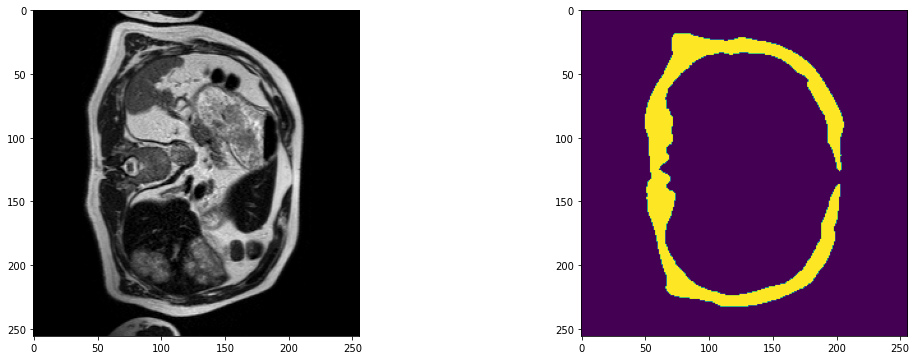

2023-09-14 05:53:55,814 INFO image_writer.py:194 - writing: outMR04_Sep23/A024_v4_T2W_seg.nii.gz


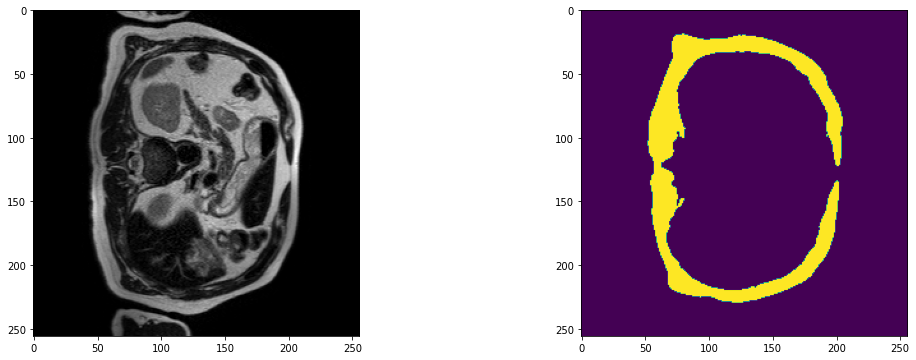

2023-09-14 05:53:58,130 INFO image_writer.py:194 - writing: outMR04_Sep23/A024_v5_T2W_seg.nii.gz


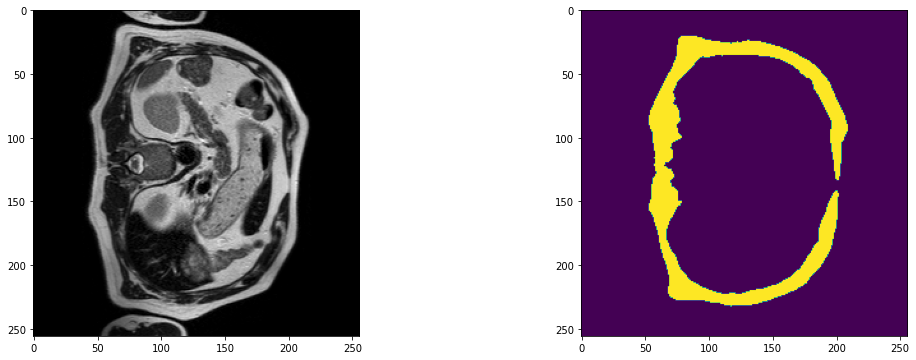

2023-09-14 05:54:00,435 INFO image_writer.py:194 - writing: outMR04_Sep23/A024_v6_T2W_seg.nii.gz


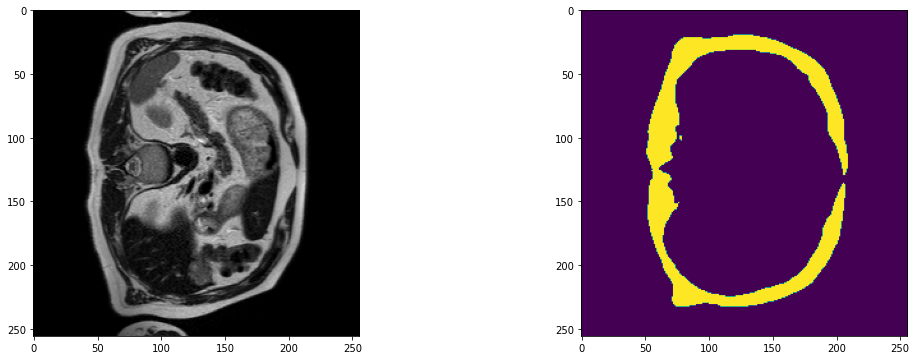

2023-09-14 05:54:02,732 INFO image_writer.py:194 - writing: outMR04_Sep23/A024_v7_T2W_seg.nii.gz


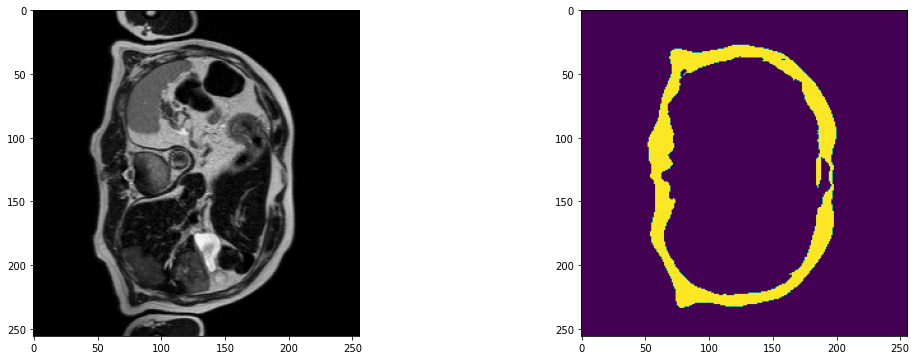

2023-09-14 05:54:05,029 INFO image_writer.py:194 - writing: outMR04_Sep23/A024_v8_T2W_seg.nii.gz


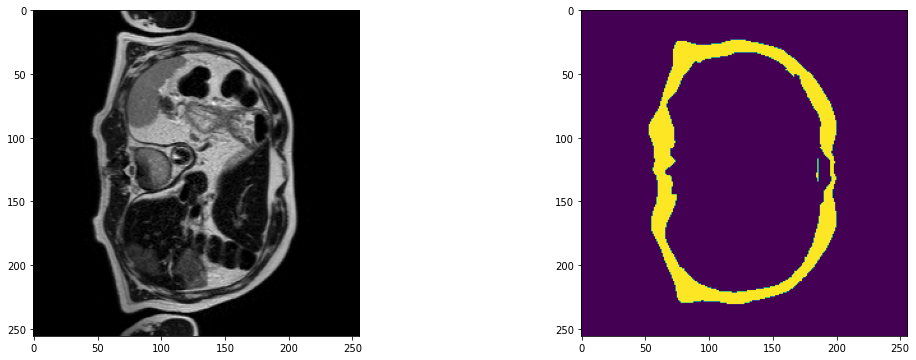

2023-09-14 05:54:07,324 INFO image_writer.py:194 - writing: outMR04_Sep23/A024_v9_T2W_seg.nii.gz


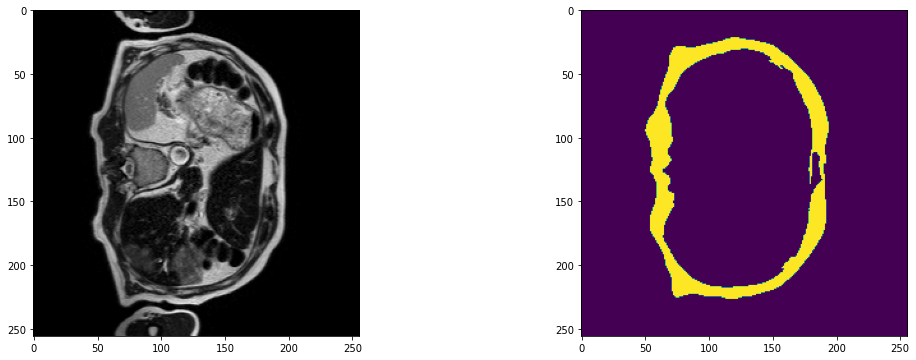

2023-09-14 05:54:12,969 INFO image_writer.py:194 - writing: outMR04_Sep23/A026_v1_T2W_seg.nii.gz


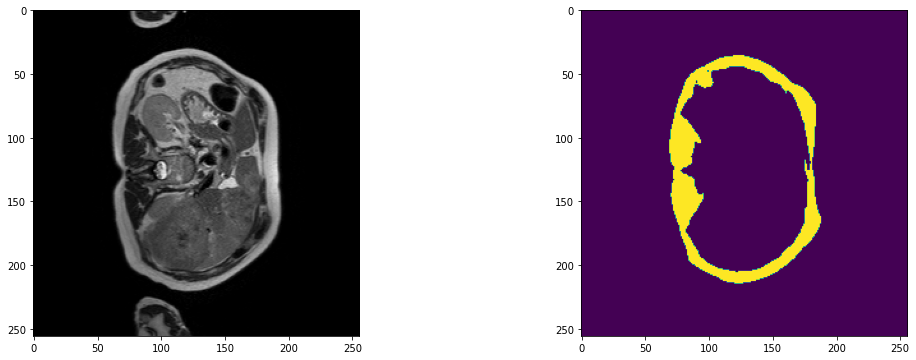

2023-09-14 05:54:18,664 INFO image_writer.py:194 - writing: outMR04_Sep23/A026_v2_T2W_seg.nii.gz


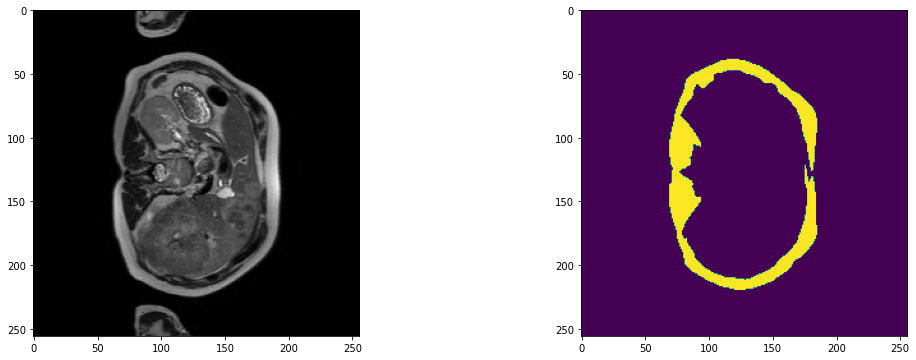

2023-09-14 05:54:24,329 INFO image_writer.py:194 - writing: outMR04_Sep23/A026_v3_T2W_seg.nii.gz


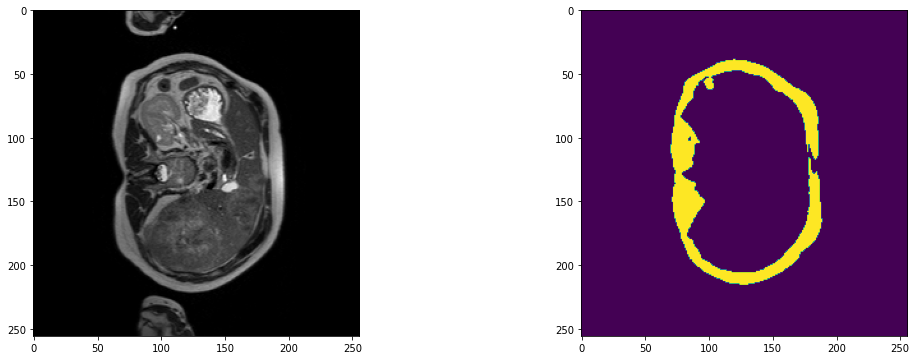

2023-09-14 05:54:30,031 INFO image_writer.py:194 - writing: outMR04_Sep23/A026_v4_T2W_seg.nii.gz


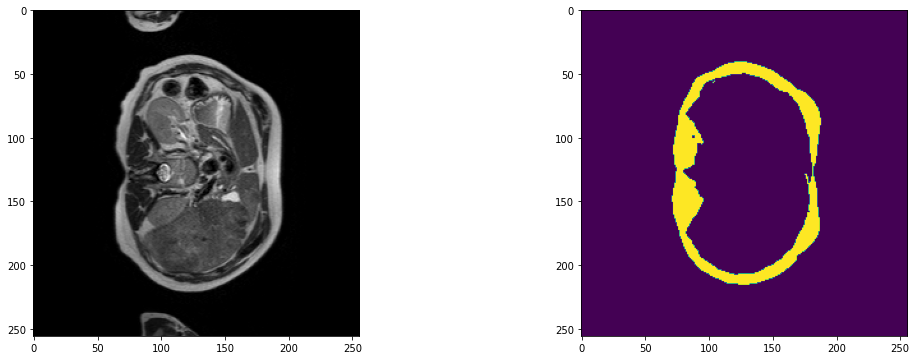

2023-09-14 05:54:35,680 INFO image_writer.py:194 - writing: outMR04_Sep23/A026_v5_T2W_seg.nii.gz


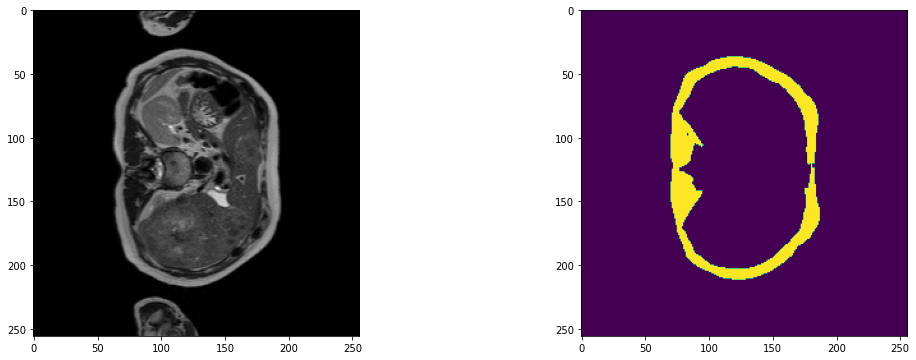

2023-09-14 05:54:37,990 INFO image_writer.py:194 - writing: outMR04_Sep23/A029_v1_T2W_seg.nii.gz


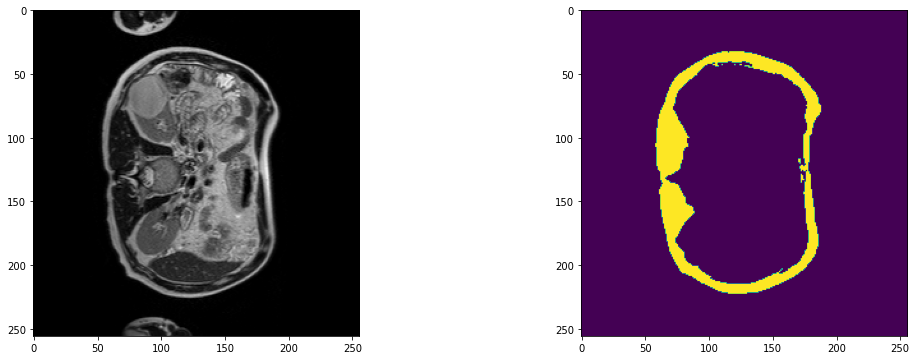

2023-09-14 05:54:40,018 INFO image_writer.py:194 - writing: outMR04_Sep23/A029_v2_T2W_seg.nii.gz


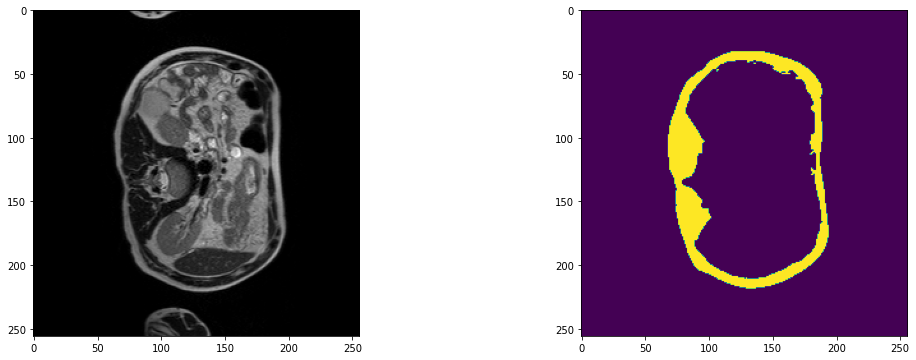

2023-09-14 05:54:42,452 INFO image_writer.py:194 - writing: outMR04_Sep23/A029_v3_T2W_seg.nii.gz


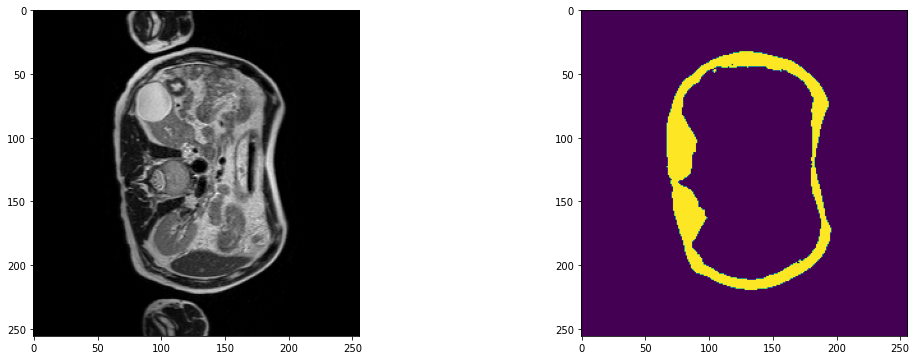

2023-09-14 05:54:44,473 INFO image_writer.py:194 - writing: outMR04_Sep23/A029_v4_T2W_seg.nii.gz


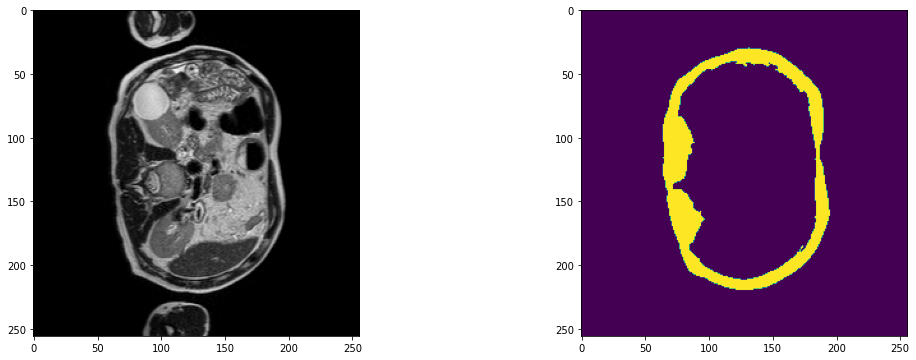

2023-09-14 05:54:46,498 INFO image_writer.py:194 - writing: outMR04_Sep23/A029_v5_T2W_seg.nii.gz


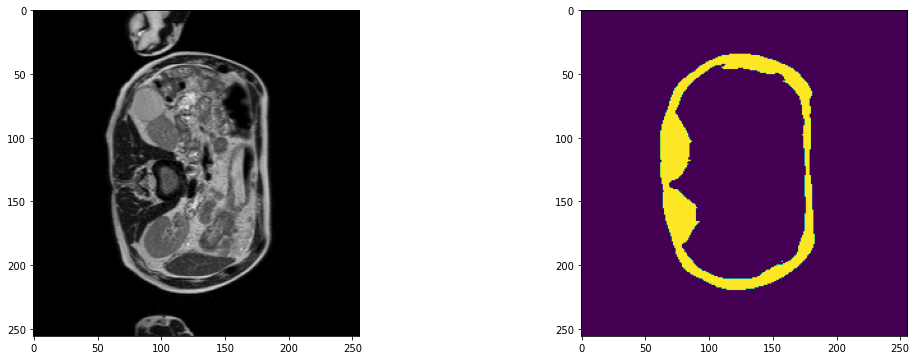

2023-09-14 05:54:48,817 INFO image_writer.py:194 - writing: outMR04_Sep23/A030_v1_T2W_seg.nii.gz


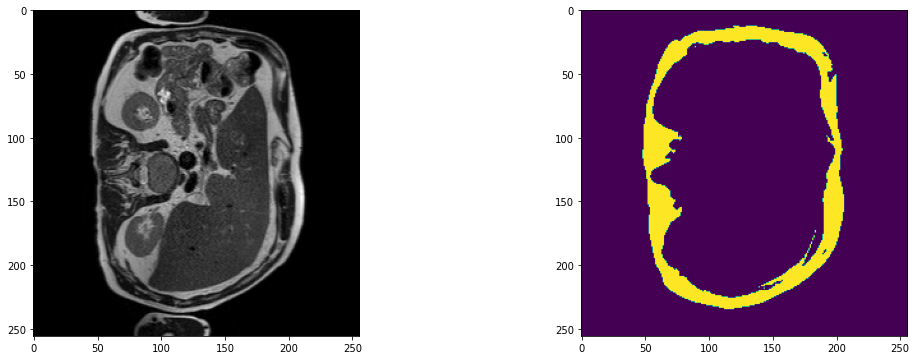

2023-09-14 05:54:51,126 INFO image_writer.py:194 - writing: outMR04_Sep23/A030_v2_T2W_seg.nii.gz


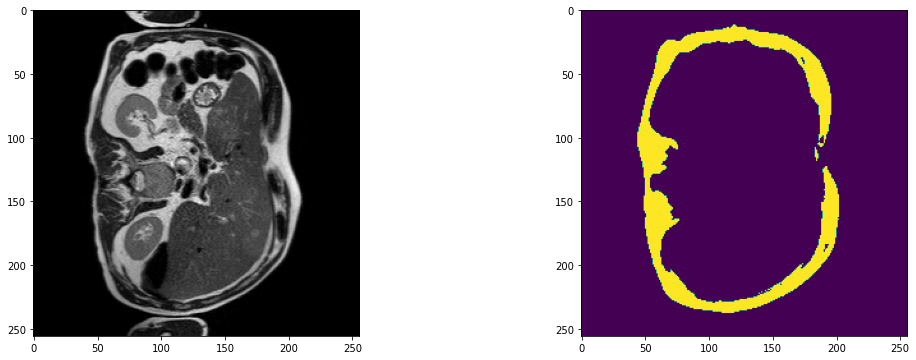

2023-09-14 05:54:53,428 INFO image_writer.py:194 - writing: outMR04_Sep23/A030_v3_T2W_seg.nii.gz


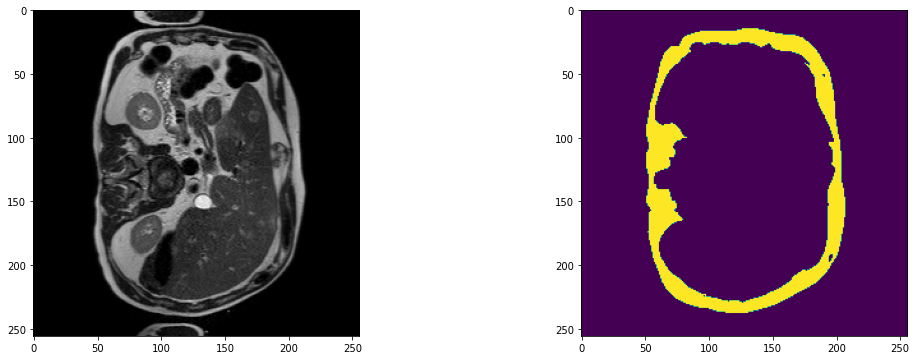

2023-09-14 05:54:55,736 INFO image_writer.py:194 - writing: outMR04_Sep23/A030_v4_T2W_seg.nii.gz


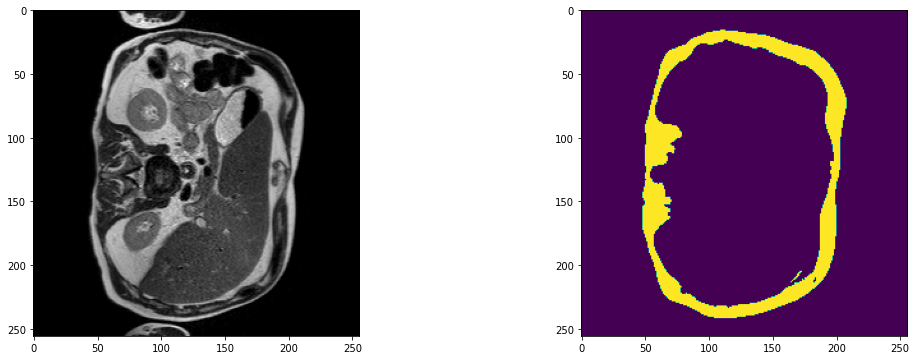

2023-09-14 05:54:58,014 INFO image_writer.py:194 - writing: outMR04_Sep23/A030_v5_T2W_seg.nii.gz


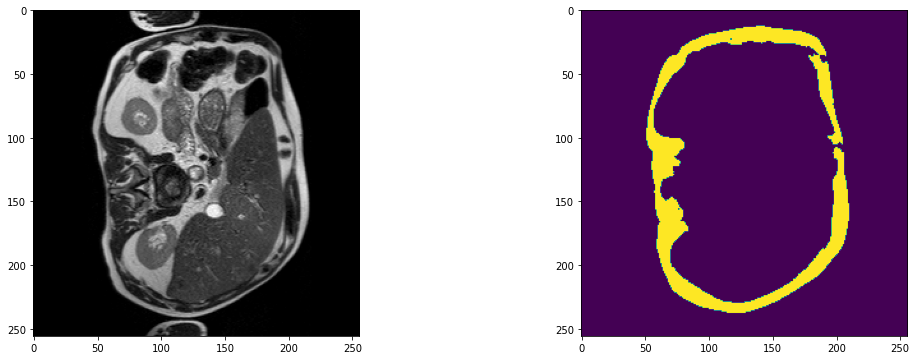

2023-09-14 05:55:00,295 INFO image_writer.py:194 - writing: outMR04_Sep23/A030_v6_T2W_seg.nii.gz


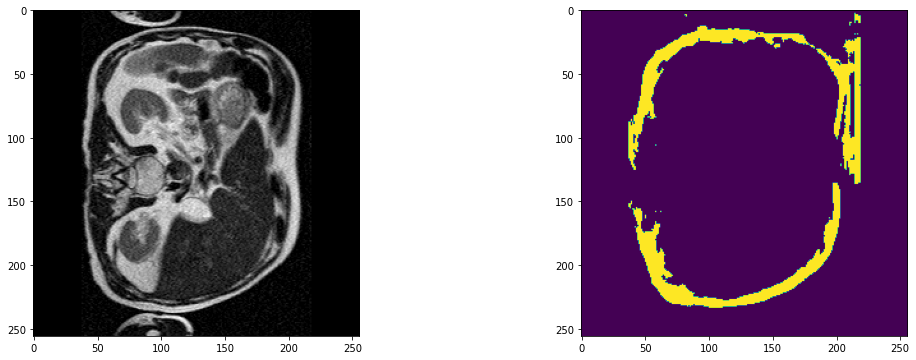

2023-09-14 05:55:02,575 INFO image_writer.py:194 - writing: outMR04_Sep23/A030_v7_T2W_seg.nii.gz


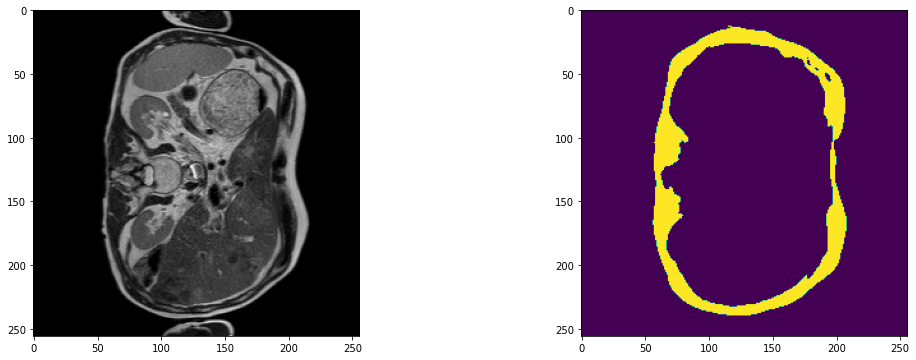

2023-09-14 05:55:04,608 INFO image_writer.py:194 - writing: outMR04_Sep23/A031_v1_T2W_seg.nii.gz


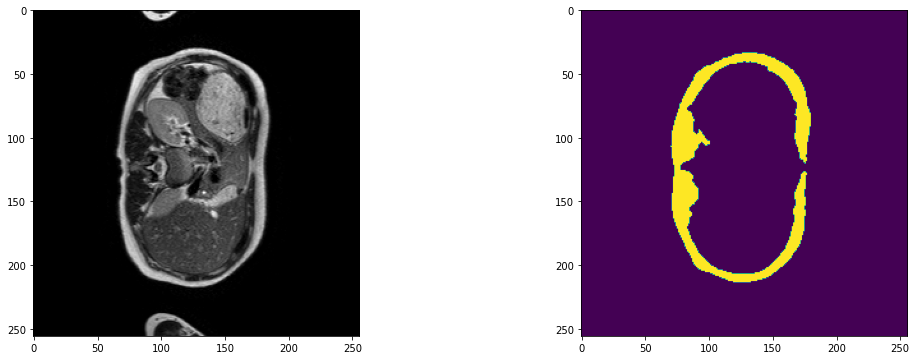

2023-09-14 05:55:06,634 INFO image_writer.py:194 - writing: outMR04_Sep23/A031_v2_T2W_seg.nii.gz


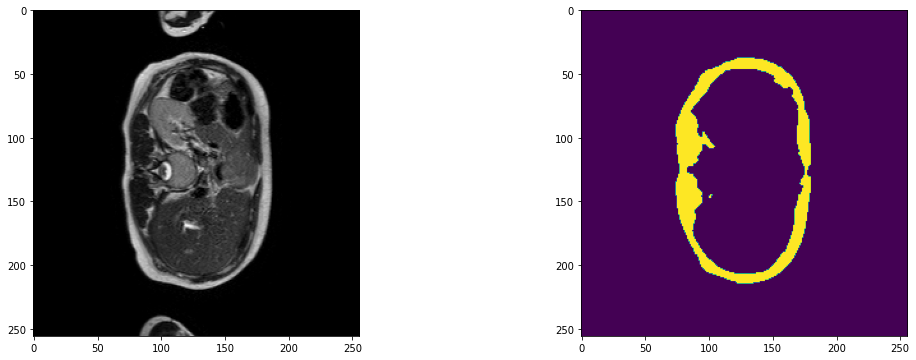

2023-09-14 05:55:08,644 INFO image_writer.py:194 - writing: outMR04_Sep23/A031_v3_T2W_seg.nii.gz


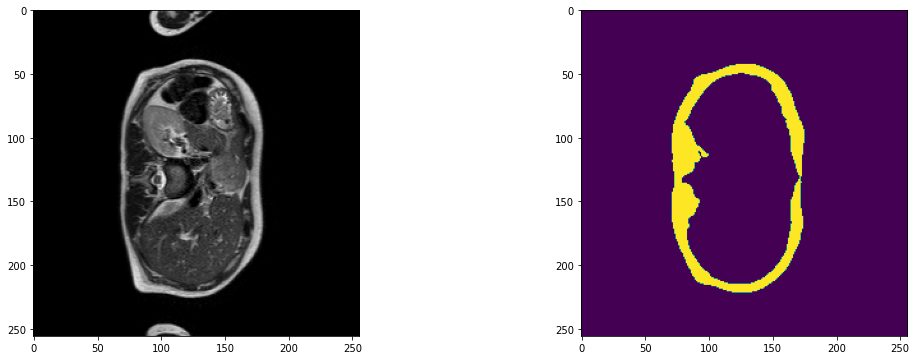

2023-09-14 05:55:10,820 INFO image_writer.py:194 - writing: outMR04_Sep23/A031_v4_T2W_seg.nii.gz


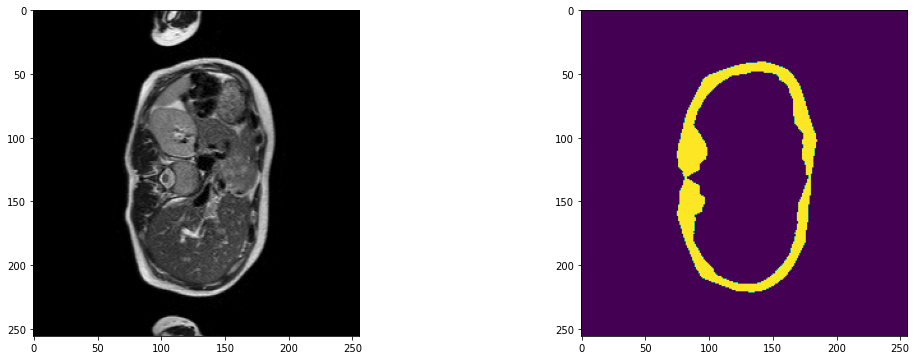

2023-09-14 05:55:12,831 INFO image_writer.py:194 - writing: outMR04_Sep23/A031_v5_T2W_seg.nii.gz


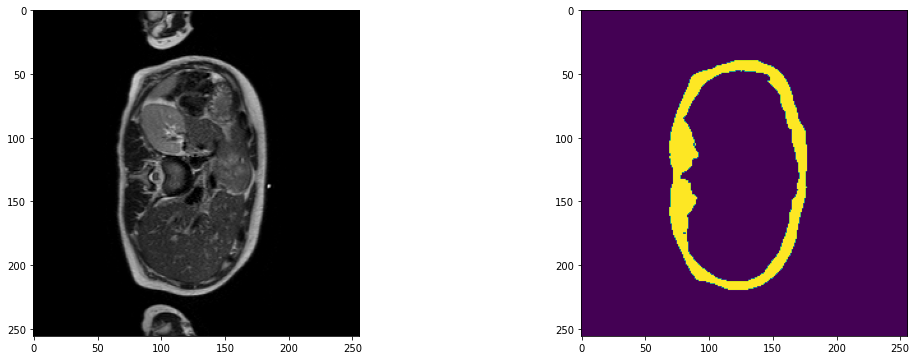

2023-09-14 05:55:14,854 INFO image_writer.py:194 - writing: outMR04_Sep23/A031_v6_T2W_seg.nii.gz


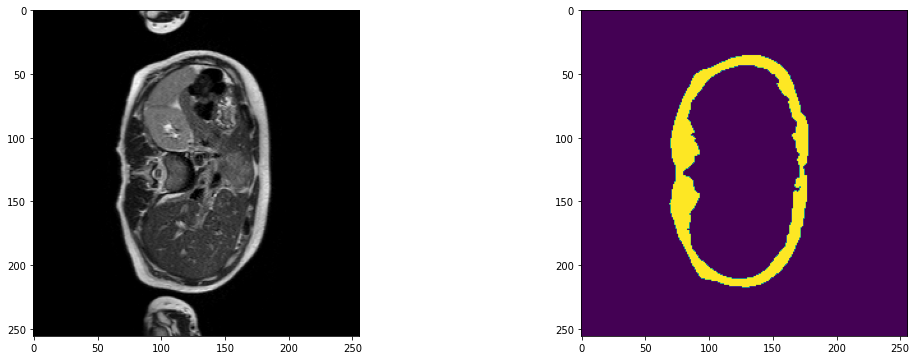

2023-09-14 05:55:20,598 INFO image_writer.py:194 - writing: outMR04_Sep23/A032_v1_T2W_seg.nii.gz


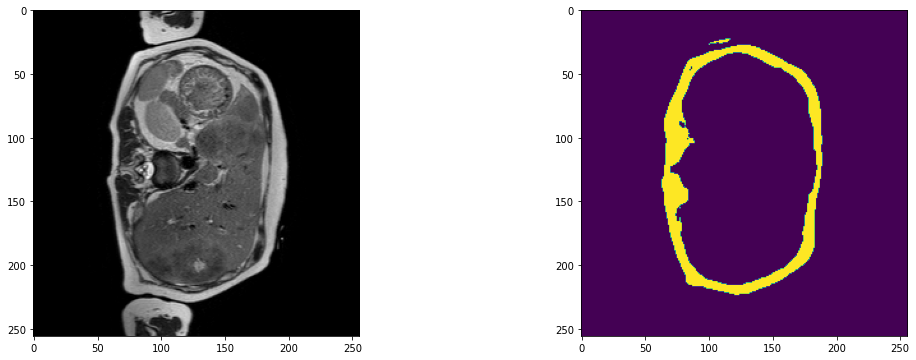

2023-09-14 05:55:26,243 INFO image_writer.py:194 - writing: outMR04_Sep23/A032_v2_T2W_seg.nii.gz


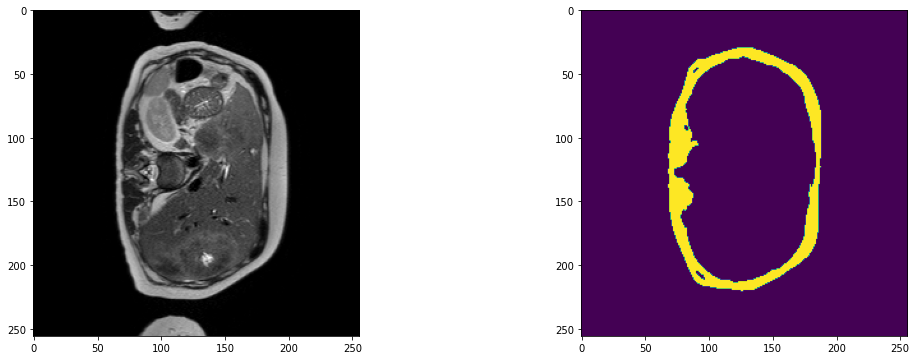

2023-09-14 05:55:31,911 INFO image_writer.py:194 - writing: outMR04_Sep23/A032_v3_T2W_seg.nii.gz


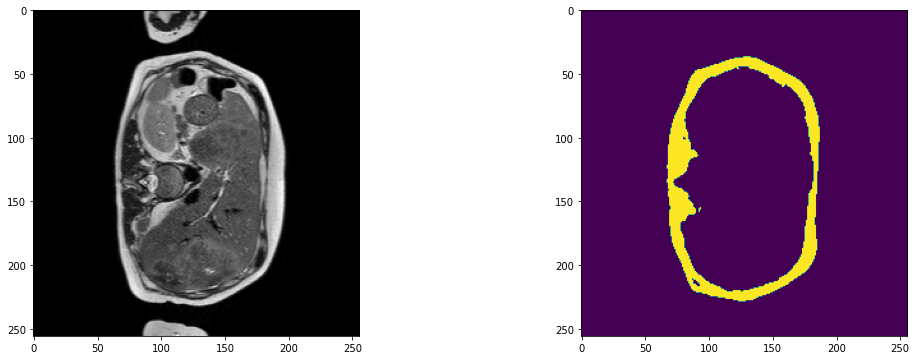

2023-09-14 05:55:37,559 INFO image_writer.py:194 - writing: outMR04_Sep23/A032_v4_T2W_seg.nii.gz


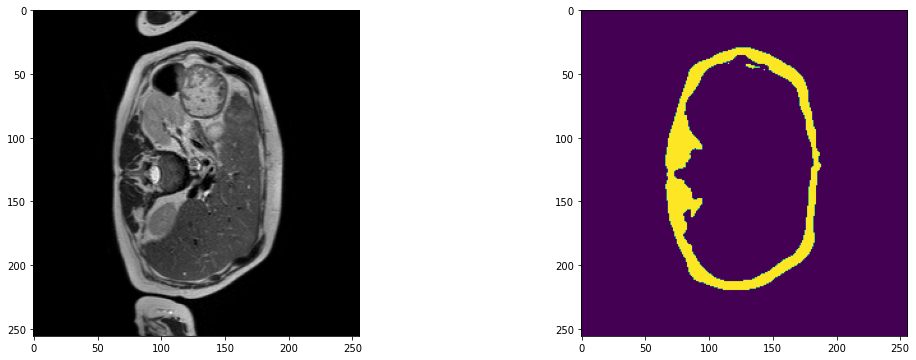

2023-09-14 05:55:43,250 INFO image_writer.py:194 - writing: outMR04_Sep23/A032_v5_T2W_seg.nii.gz


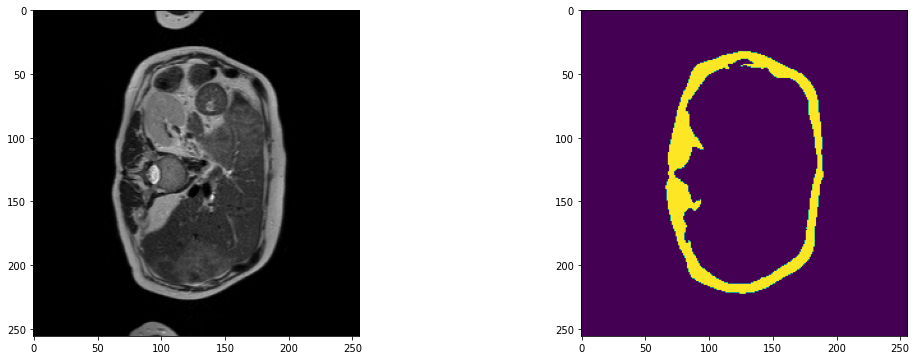

2023-09-14 05:55:48,089 INFO image_writer.py:194 - writing: outMR04_Sep23/A032_v6_T2W_seg.nii.gz


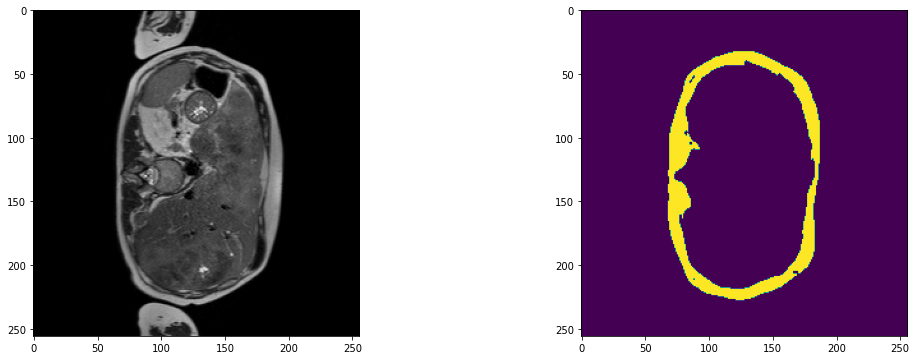

2023-09-14 05:55:52,964 INFO image_writer.py:194 - writing: outMR04_Sep23/A032_v7_T2W_seg.nii.gz


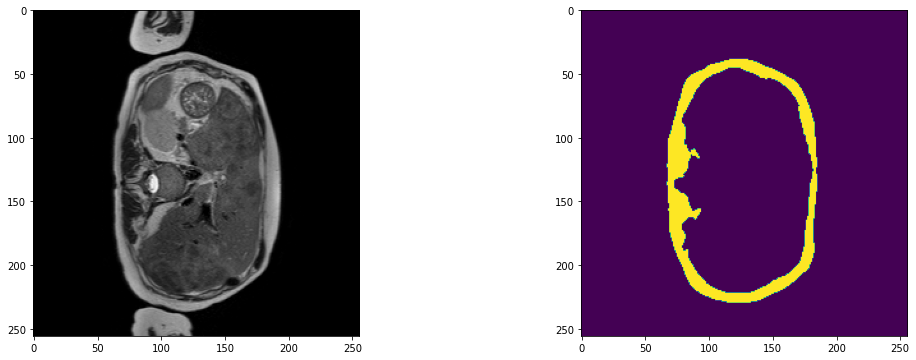

2023-09-14 05:55:57,811 INFO image_writer.py:194 - writing: outMR04_Sep23/A032_v8_T2W_seg.nii.gz


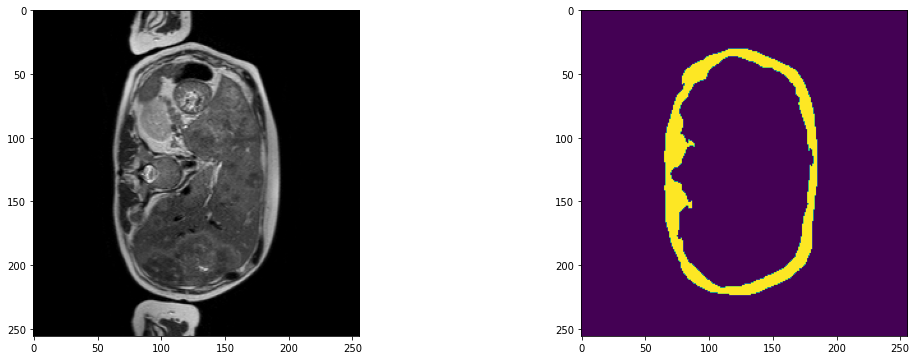

2023-09-14 05:56:03,502 INFO image_writer.py:194 - writing: outMR04_Sep23/A032_v9_T2W_seg.nii.gz


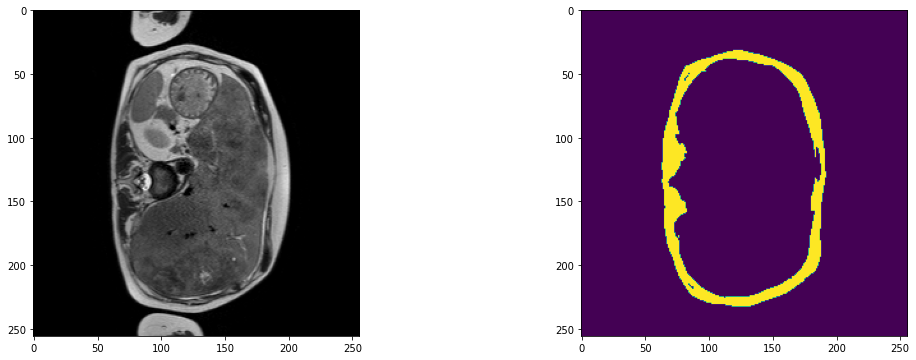

2023-09-14 05:56:09,165 INFO image_writer.py:194 - writing: outMR04_Sep23/A033_v1_T2W_seg.nii.gz


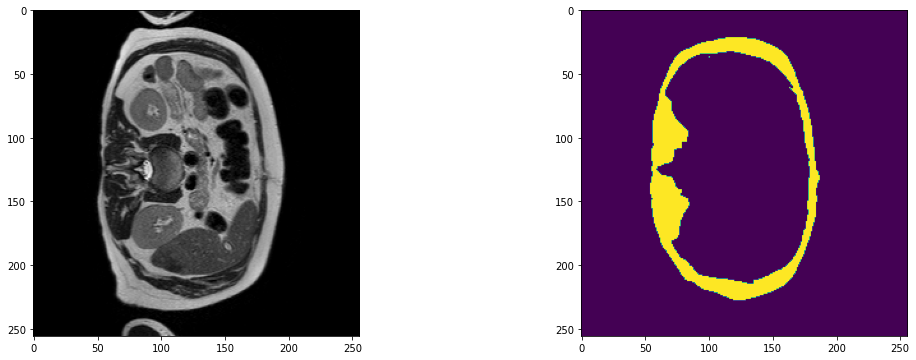

2023-09-14 05:56:14,866 INFO image_writer.py:194 - writing: outMR04_Sep23/A033_v2_T2W_seg.nii.gz


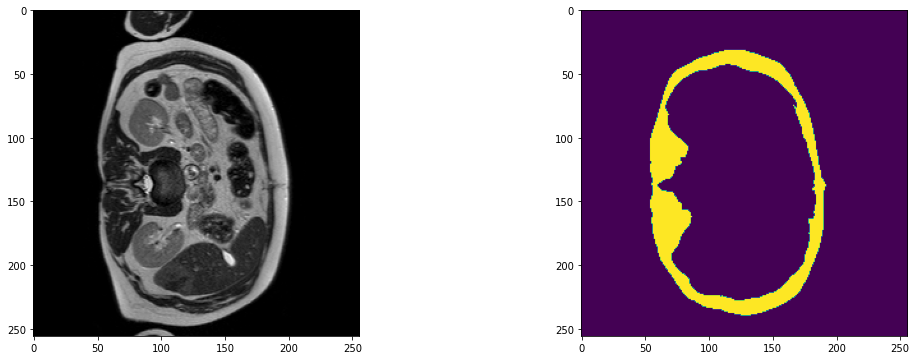

2023-09-14 05:56:20,683 INFO image_writer.py:194 - writing: outMR04_Sep23/A033_v3_T2W_seg.nii.gz


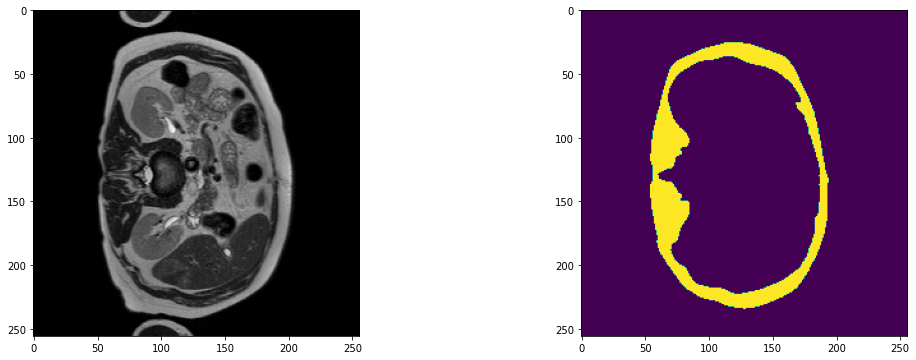

2023-09-14 05:56:26,395 INFO image_writer.py:194 - writing: outMR04_Sep23/A033_v4_T2W_seg.nii.gz


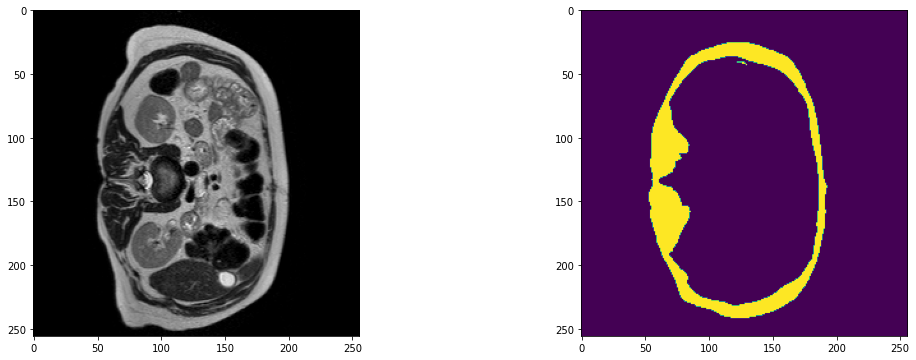

2023-09-14 05:56:32,081 INFO image_writer.py:194 - writing: outMR04_Sep23/A033_v5_T2W_seg.nii.gz


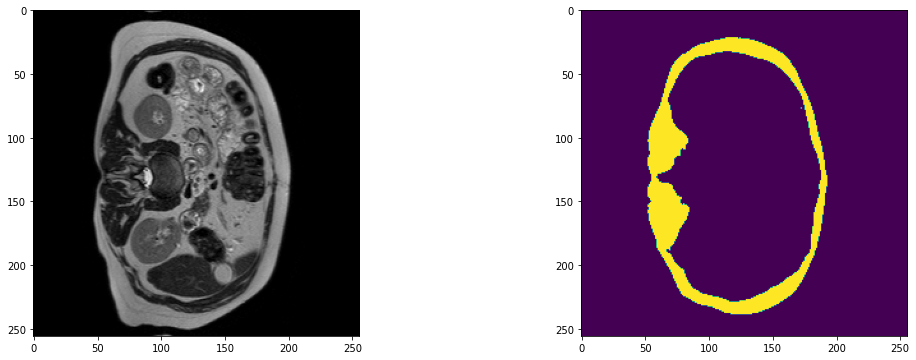

2023-09-14 05:56:37,786 INFO image_writer.py:194 - writing: outMR04_Sep23/A034_v1_T2W_seg.nii.gz


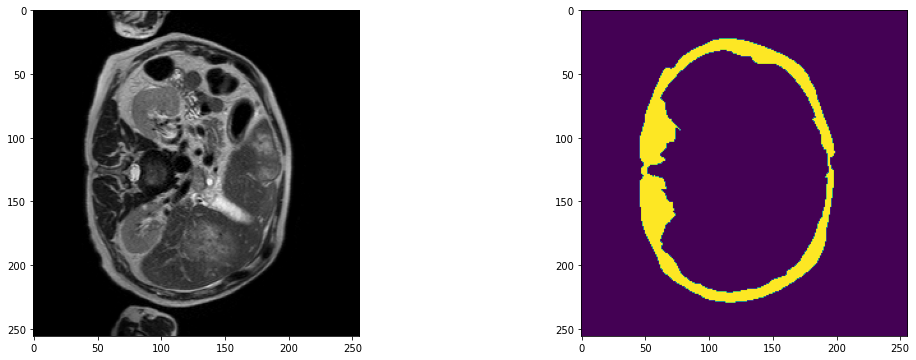

2023-09-14 05:56:43,479 INFO image_writer.py:194 - writing: outMR04_Sep23/A034_v2_T2W_seg.nii.gz


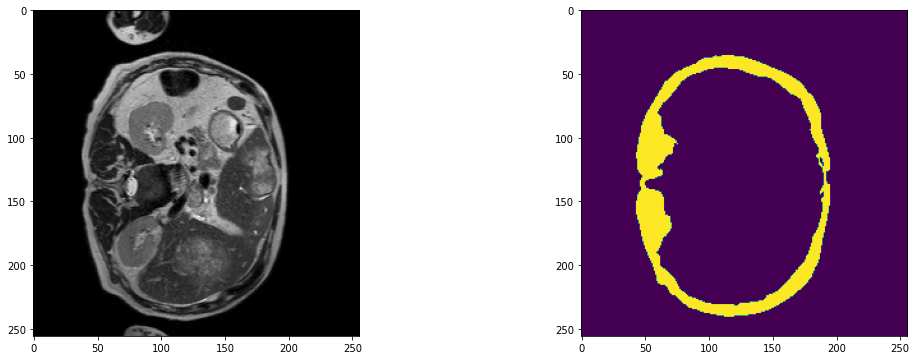

2023-09-14 05:56:49,184 INFO image_writer.py:194 - writing: outMR04_Sep23/A034_v3_T2W_seg.nii.gz


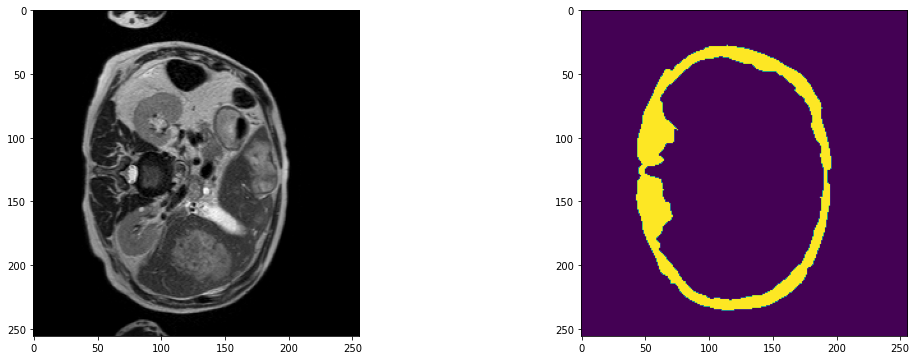

2023-09-14 05:56:54,888 INFO image_writer.py:194 - writing: outMR04_Sep23/A034_v4_T2W_seg.nii.gz


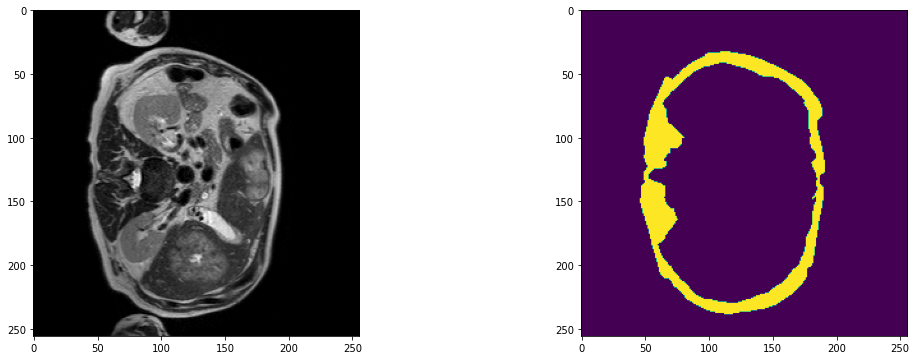

2023-09-14 05:57:00,595 INFO image_writer.py:194 - writing: outMR04_Sep23/A034_v5_T2W_seg.nii.gz


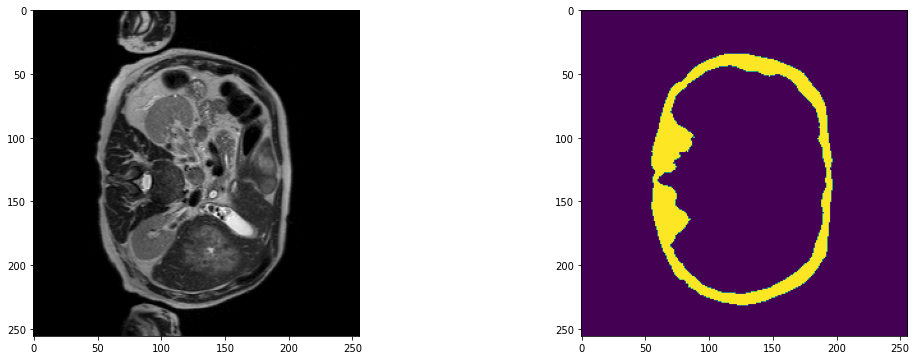

2023-09-14 05:57:06,294 INFO image_writer.py:194 - writing: outMR04_Sep23/A034_v6_T2W_seg.nii.gz


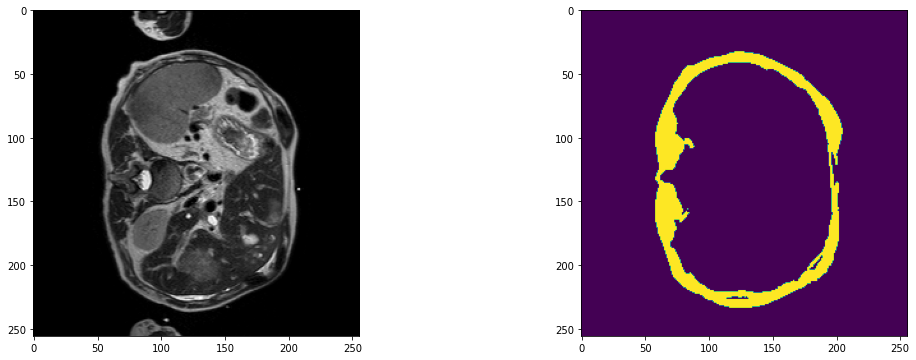

2023-09-14 05:57:12,011 INFO image_writer.py:194 - writing: outMR04_Sep23/A034_v7_T2W_seg.nii.gz


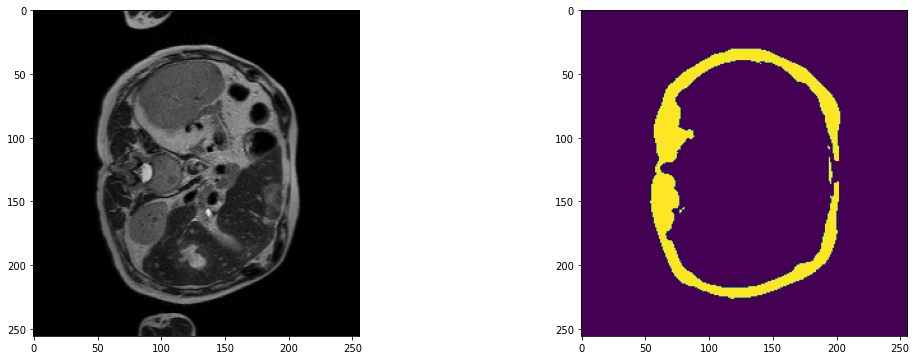

2023-09-14 05:57:17,728 INFO image_writer.py:194 - writing: outMR04_Sep23/A034_v8_T2W_seg.nii.gz


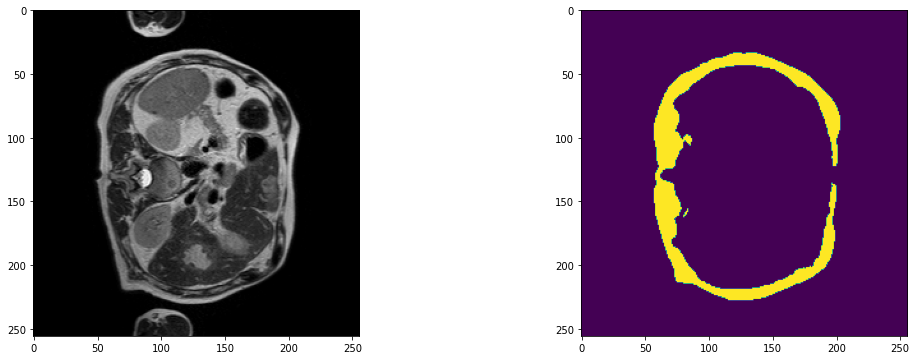

2023-09-14 05:57:23,451 INFO image_writer.py:194 - writing: outMR04_Sep23/A034_v9_T2W_seg.nii.gz


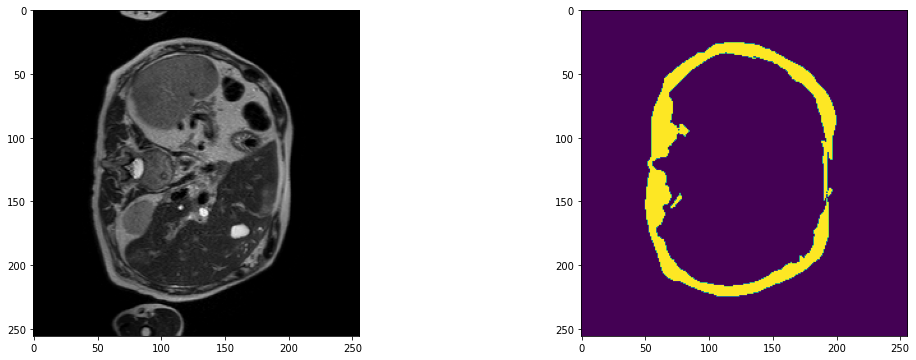

2023-09-14 05:57:28,285 INFO image_writer.py:194 - writing: outMR04_Sep23/A037_v1_T2W_seg.nii.gz


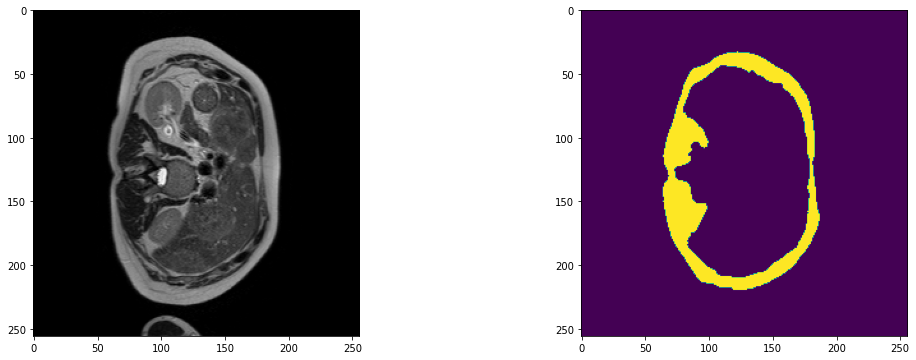

2023-09-14 05:57:33,990 INFO image_writer.py:194 - writing: outMR04_Sep23/A037_v2_T2W_seg.nii.gz


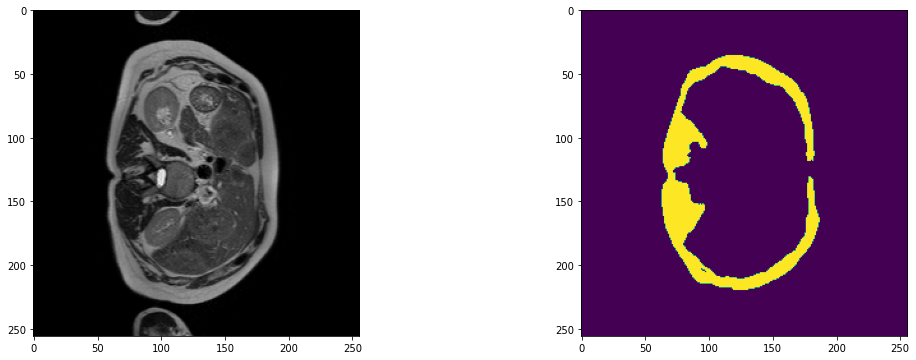

2023-09-14 05:57:39,835 INFO image_writer.py:194 - writing: outMR04_Sep23/A037_v3_T2W_seg.nii.gz


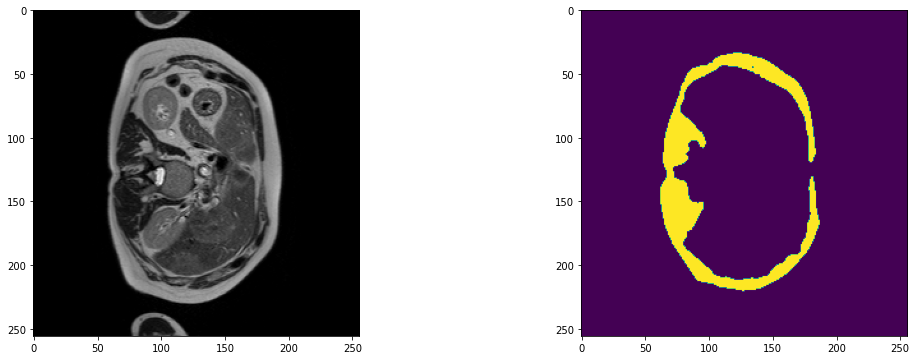

2023-09-14 05:57:44,740 INFO image_writer.py:194 - writing: outMR04_Sep23/A037_v6_T2W_seg.nii.gz


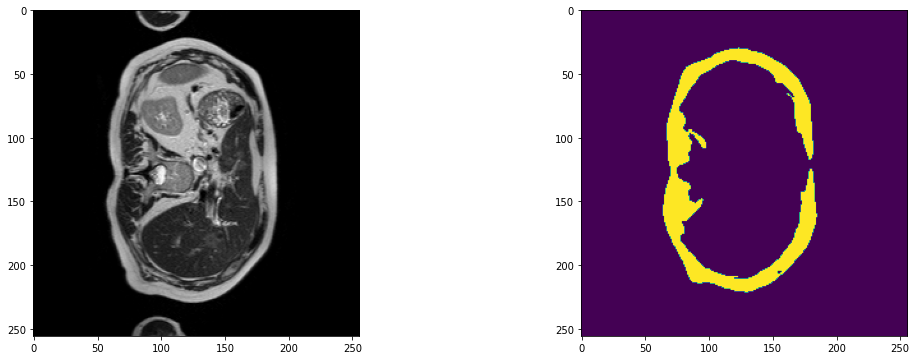

2023-09-14 05:57:49,610 INFO image_writer.py:194 - writing: outMR04_Sep23/A037_v7_T2W_seg.nii.gz


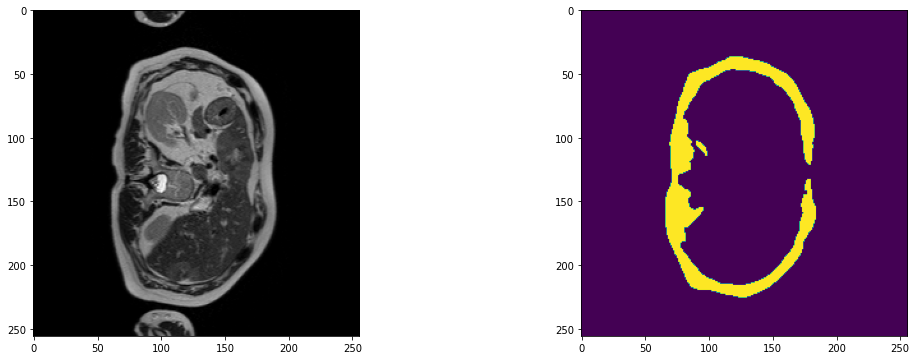

2023-09-14 05:57:51,913 INFO image_writer.py:194 - writing: outMR04_Sep23/A038_v1_T2W_seg.nii.gz


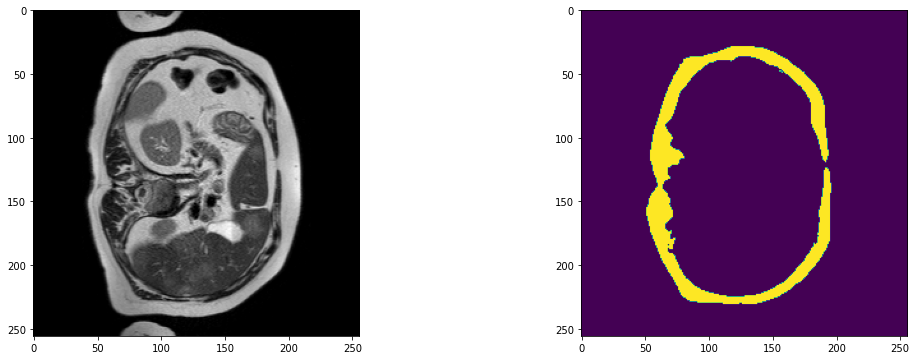

2023-09-14 05:57:54,231 INFO image_writer.py:194 - writing: outMR04_Sep23/A038_v2_T2W_seg.nii.gz


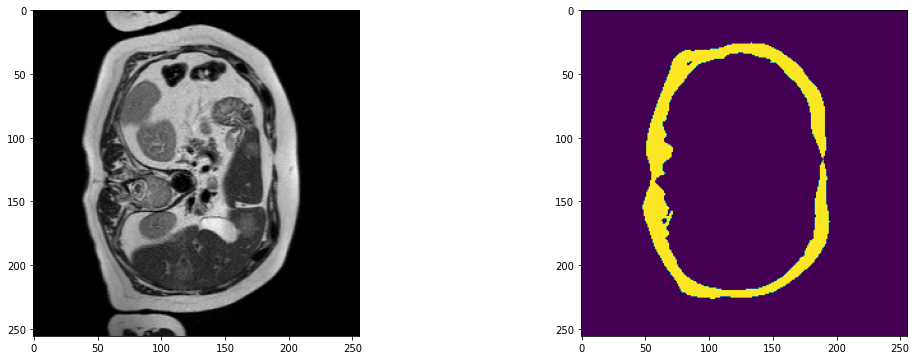

2023-09-14 05:57:56,585 INFO image_writer.py:194 - writing: outMR04_Sep23/A038_v3_T2W_seg.nii.gz


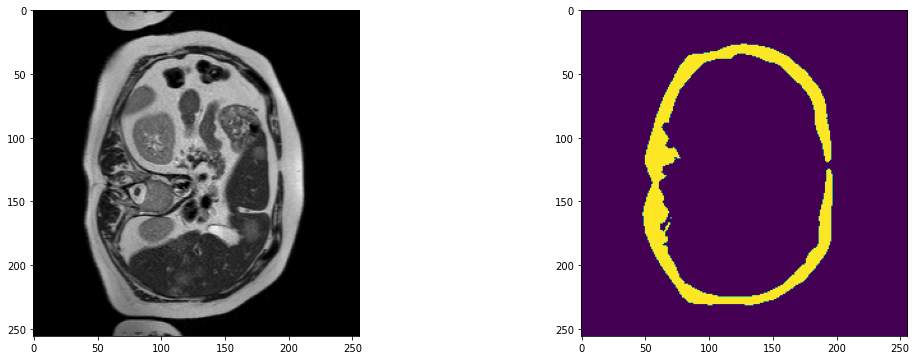

2023-09-14 05:57:58,882 INFO image_writer.py:194 - writing: outMR04_Sep23/A038_v4_T2W_seg.nii.gz


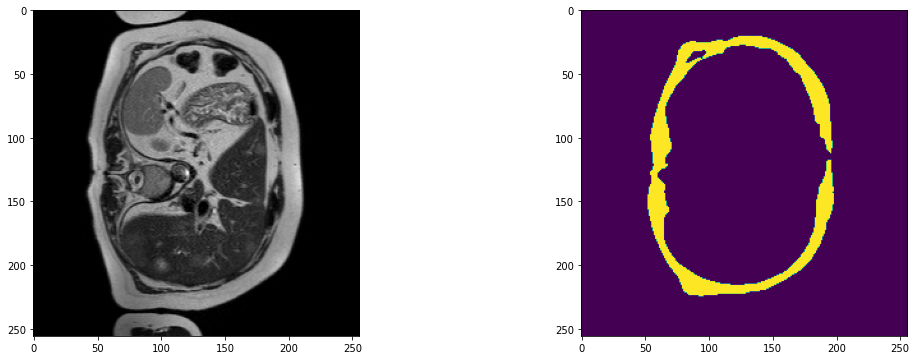

2023-09-14 05:58:01,186 INFO image_writer.py:194 - writing: outMR04_Sep23/A038_v5_T2W_seg.nii.gz


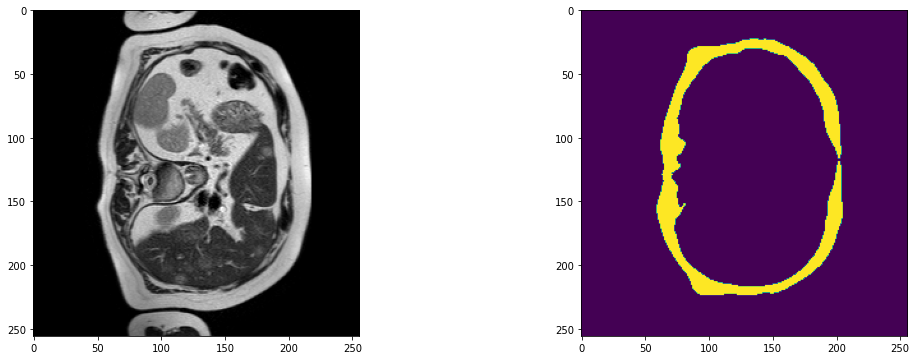

2023-09-14 05:58:03,496 INFO image_writer.py:194 - writing: outMR04_Sep23/A038_v6_T2W_seg.nii.gz


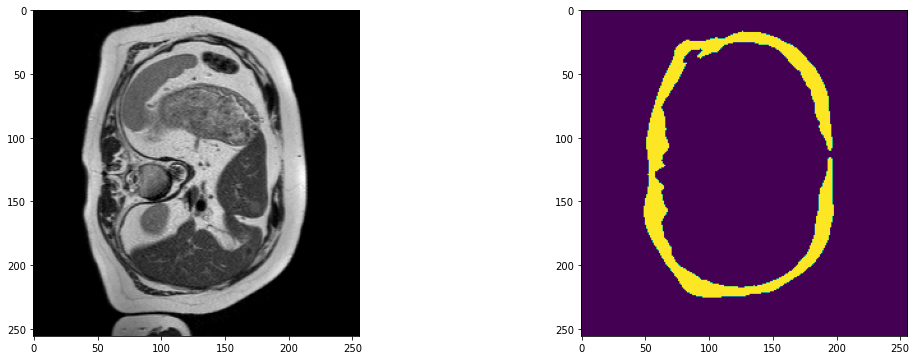

2023-09-14 05:58:05,802 INFO image_writer.py:194 - writing: outMR04_Sep23/A038_v7_T2W_seg.nii.gz


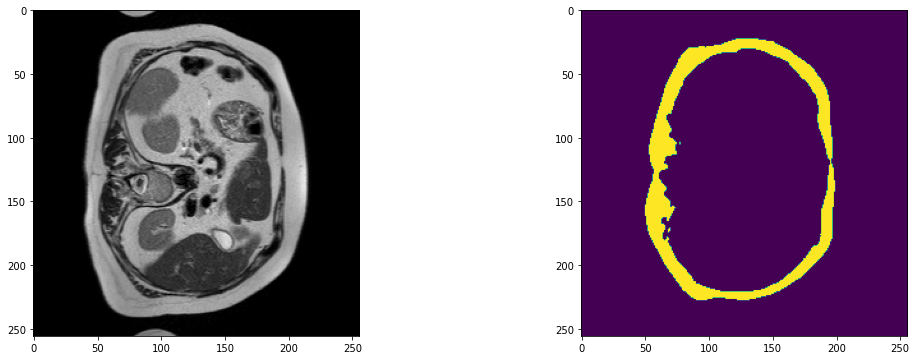

2023-09-14 05:58:08,116 INFO image_writer.py:194 - writing: outMR04_Sep23/A038_v8_T2W_seg.nii.gz


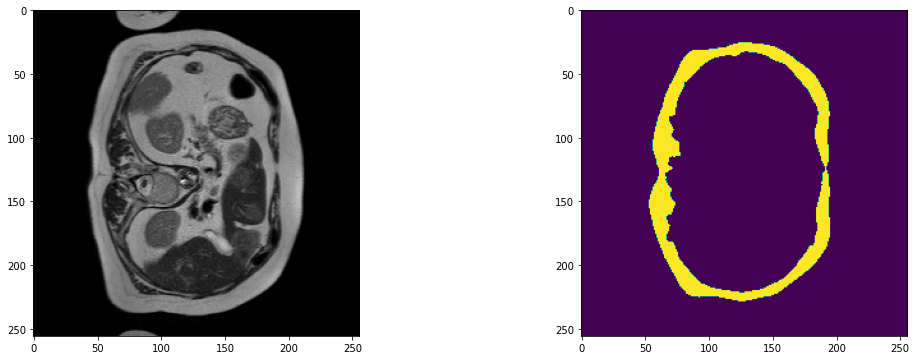

2023-09-14 05:58:10,435 INFO image_writer.py:194 - writing: outMR04_Sep23/A038_v9_T2W_seg.nii.gz


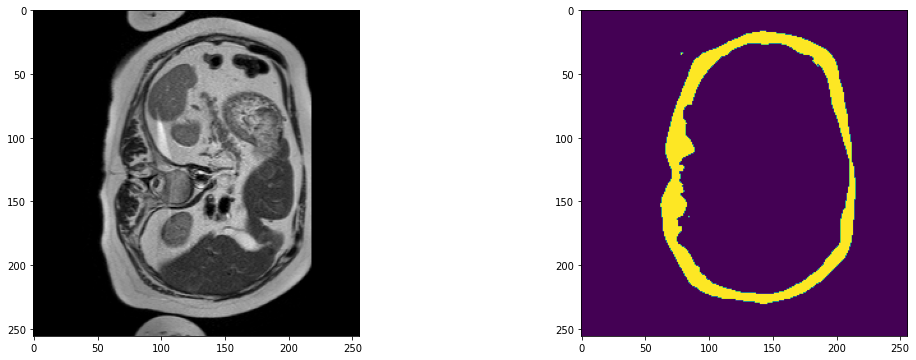

2023-09-14 05:58:12,497 INFO image_writer.py:194 - writing: outMR04_Sep23/A039_v1_T2W_seg.nii.gz


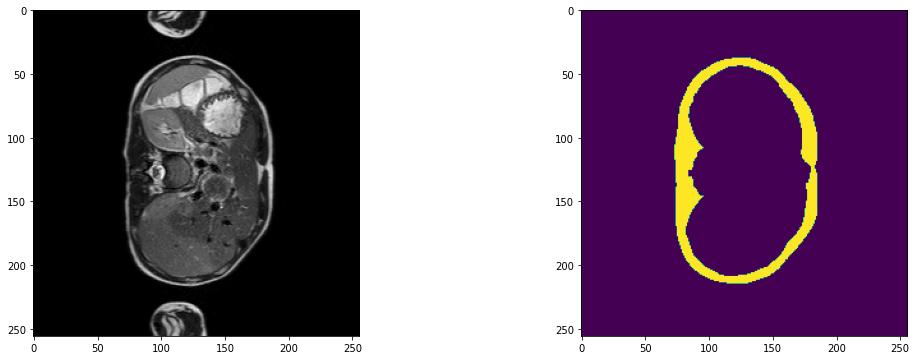

2023-09-14 05:58:14,368 INFO image_writer.py:194 - writing: outMR04_Sep23/A039_v2_T2W_seg.nii.gz


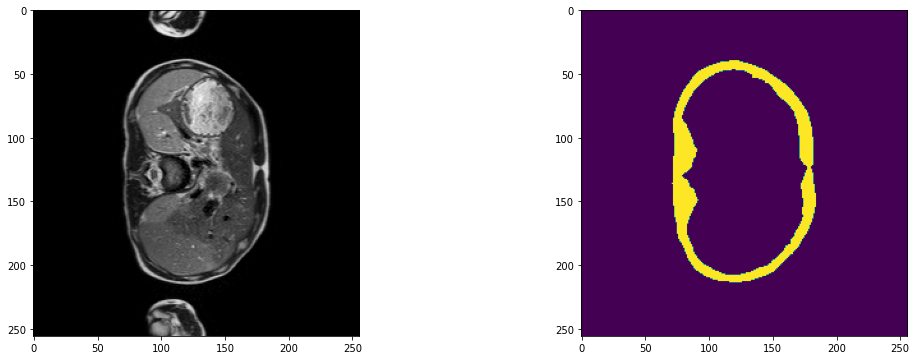

2023-09-14 05:58:16,107 INFO image_writer.py:194 - writing: outMR04_Sep23/A039_v3_T2W_seg.nii.gz


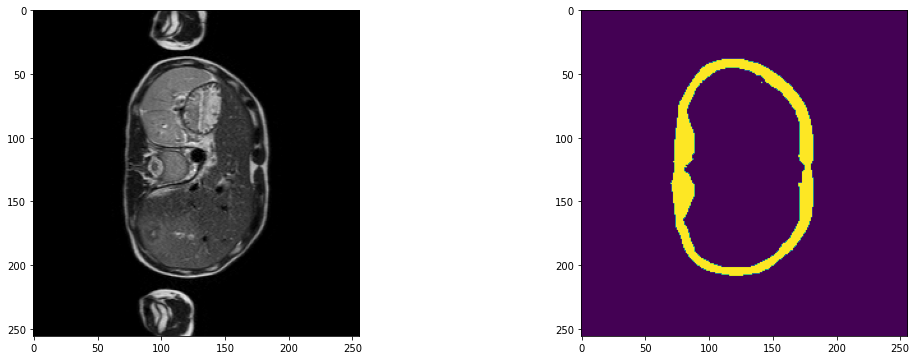

2023-09-14 05:58:17,882 INFO image_writer.py:194 - writing: outMR04_Sep23/A039_v4_T2W_seg.nii.gz


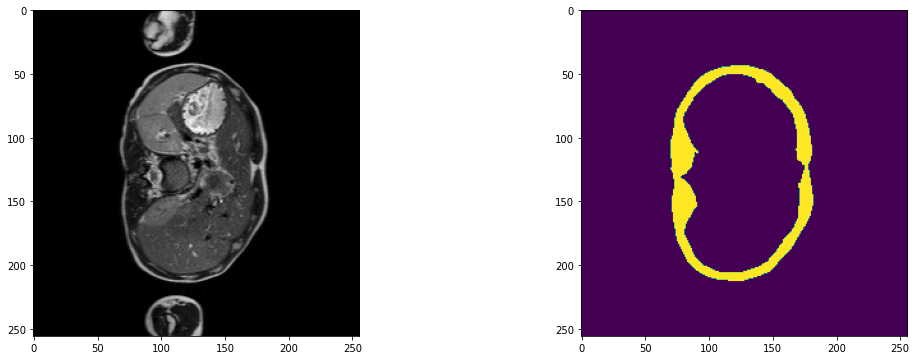

2023-09-14 05:58:19,593 INFO image_writer.py:194 - writing: outMR04_Sep23/A039_v5_T2W_seg.nii.gz


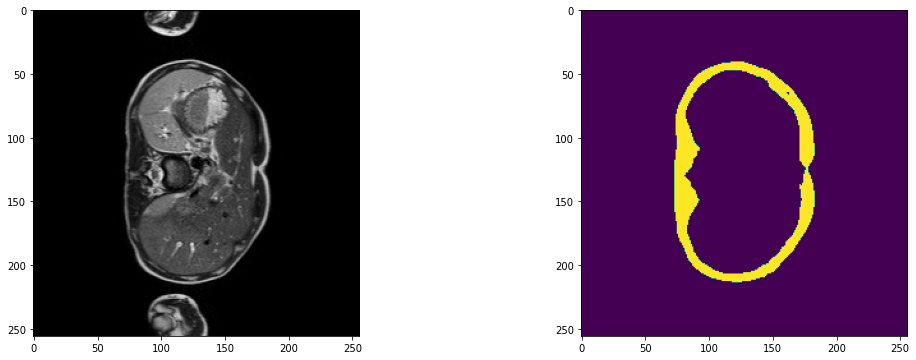

2023-09-14 05:58:21,598 INFO image_writer.py:194 - writing: outMR04_Sep23/A039_v6_T2W_seg.nii.gz


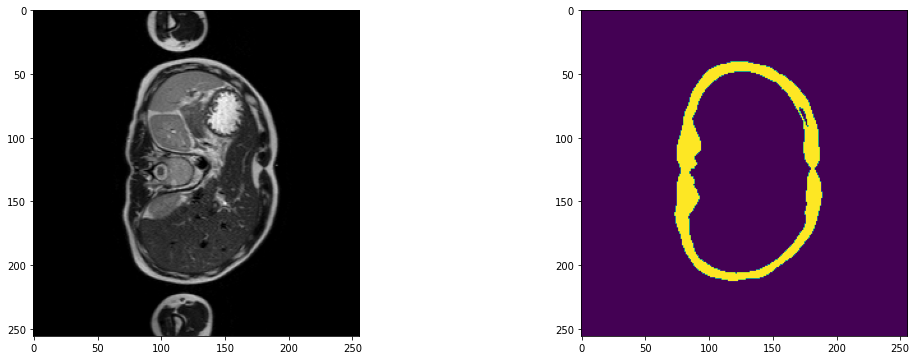

2023-09-14 05:58:23,303 INFO image_writer.py:194 - writing: outMR04_Sep23/A039_v7_T2W_seg.nii.gz


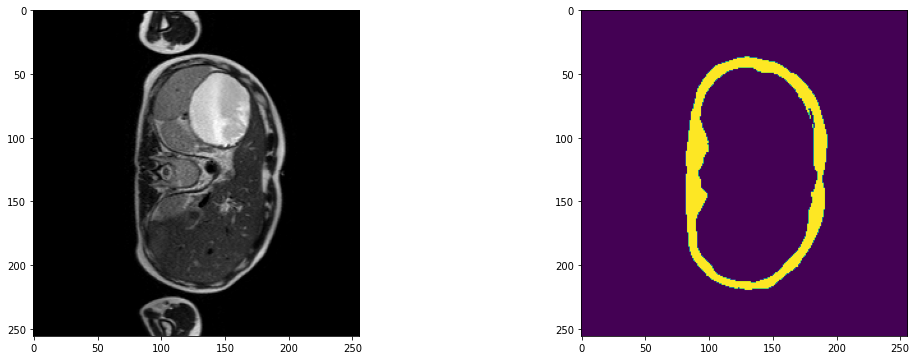

2023-09-14 05:58:25,314 INFO image_writer.py:194 - writing: outMR04_Sep23/A039_v9_T2W_seg.nii.gz


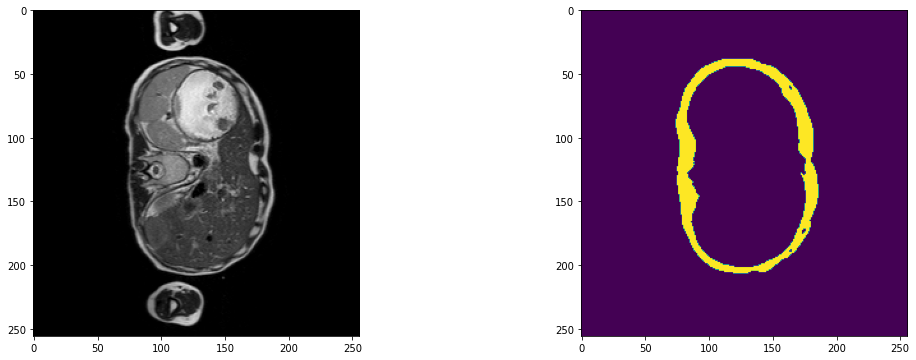

2023-09-14 05:58:30,970 INFO image_writer.py:194 - writing: outMR04_Sep23/A040_v1_T2W_seg.nii.gz


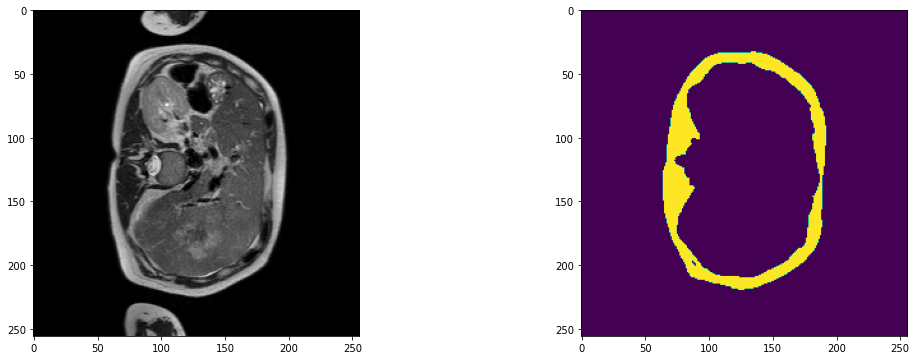

2023-09-14 05:58:36,680 INFO image_writer.py:194 - writing: outMR04_Sep23/A040_v2_T2W_seg.nii.gz


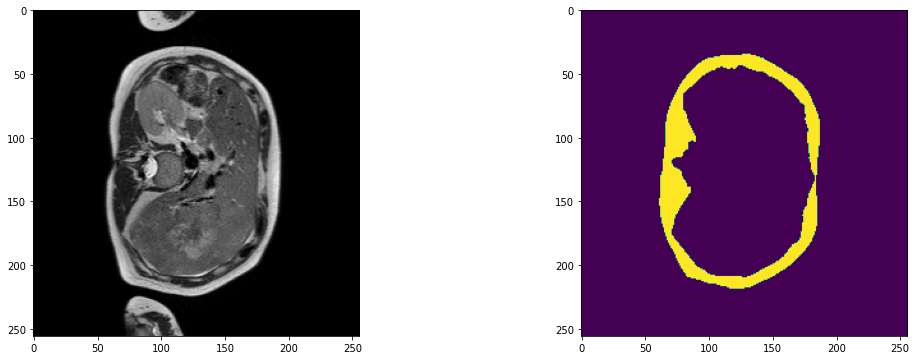

2023-09-14 05:58:42,334 INFO image_writer.py:194 - writing: outMR04_Sep23/A040_v3_T2W_seg.nii.gz


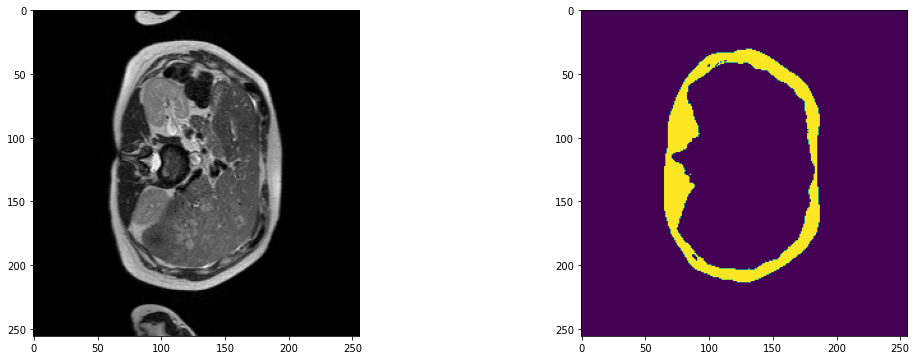

2023-09-14 05:58:47,195 INFO image_writer.py:194 - writing: outMR04_Sep23/A040_v4_T2W_seg.nii.gz


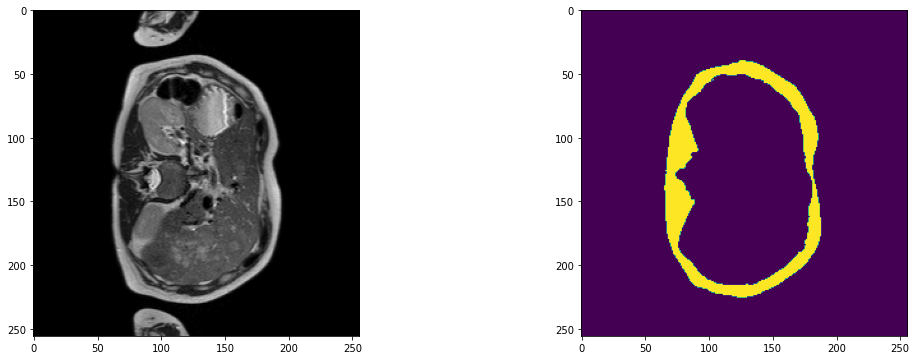

2023-09-14 05:58:52,040 INFO image_writer.py:194 - writing: outMR04_Sep23/A040_v5_T2W_seg.nii.gz


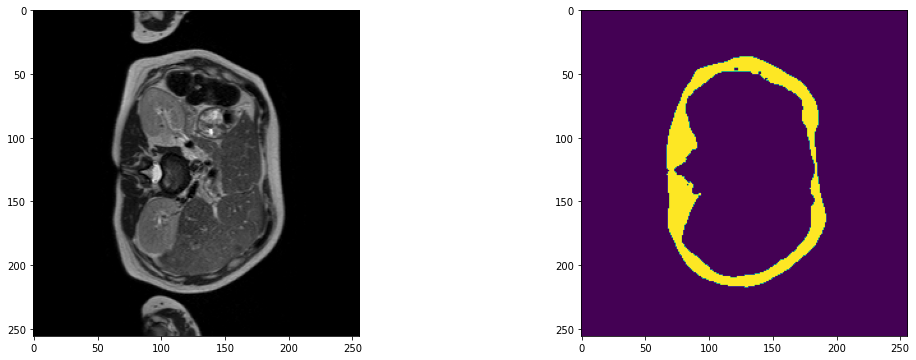

2023-09-14 05:58:54,401 INFO image_writer.py:194 - writing: outMR04_Sep23/A041_v1_T2W_seg.nii.gz


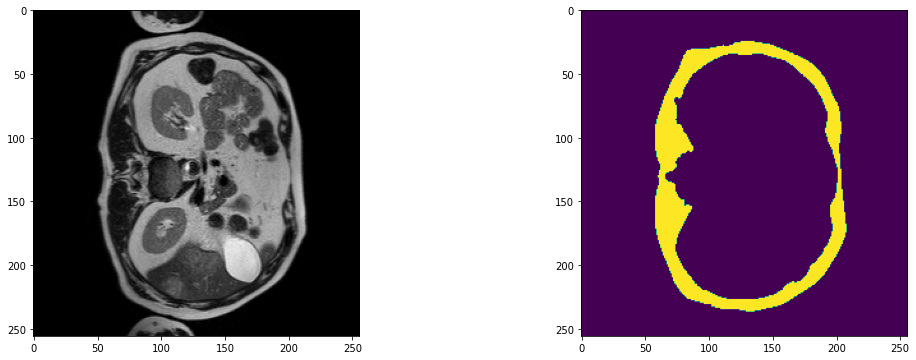

2023-09-14 05:58:56,826 INFO image_writer.py:194 - writing: outMR04_Sep23/A041_v2_T2W_seg.nii.gz


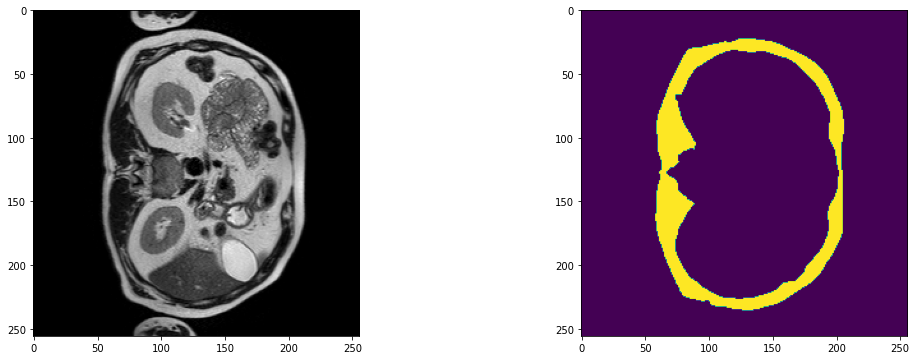

2023-09-14 05:58:59,155 INFO image_writer.py:194 - writing: outMR04_Sep23/A041_v4_T2W_seg.nii.gz


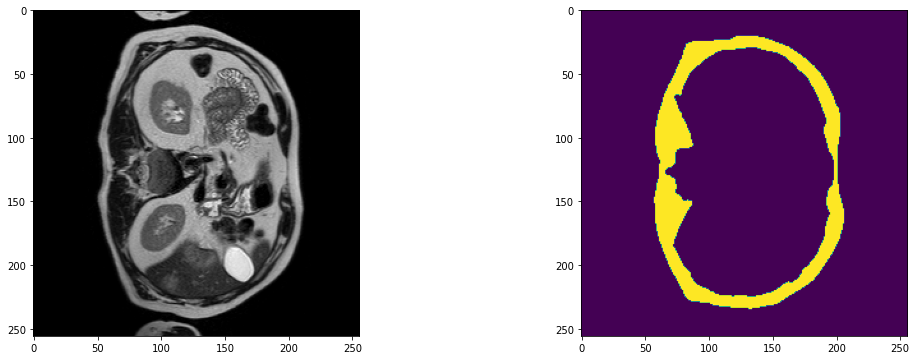

2023-09-14 05:59:01,489 INFO image_writer.py:194 - writing: outMR04_Sep23/A041_v5_T2W_seg.nii.gz


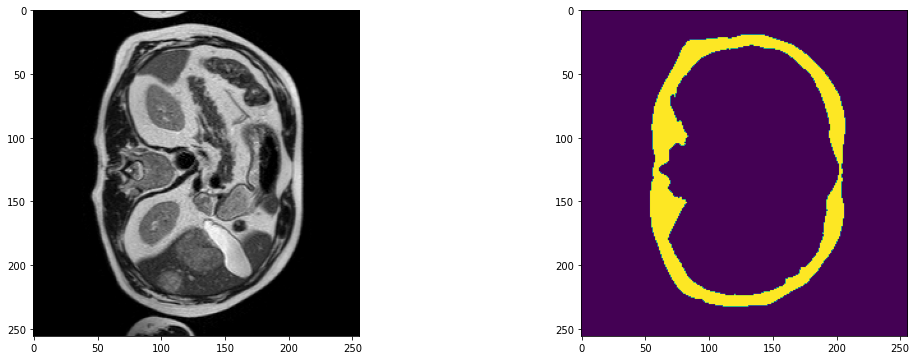

2023-09-14 05:59:03,823 INFO image_writer.py:194 - writing: outMR04_Sep23/A041_v6_T2W_seg.nii.gz


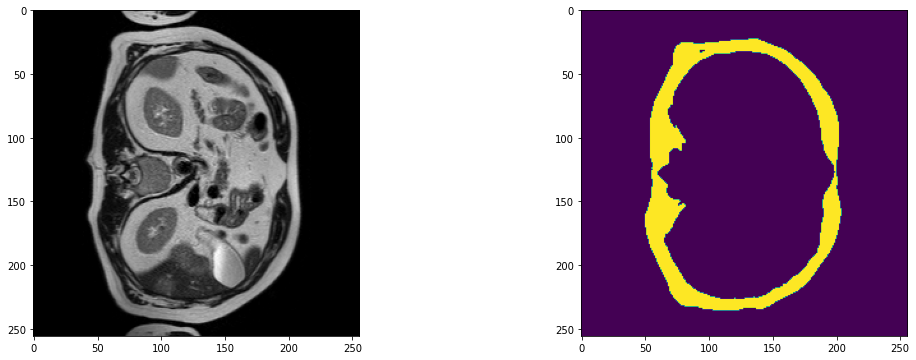

2023-09-14 05:59:06,139 INFO image_writer.py:194 - writing: outMR04_Sep23/A046_v1_T2W_seg.nii.gz


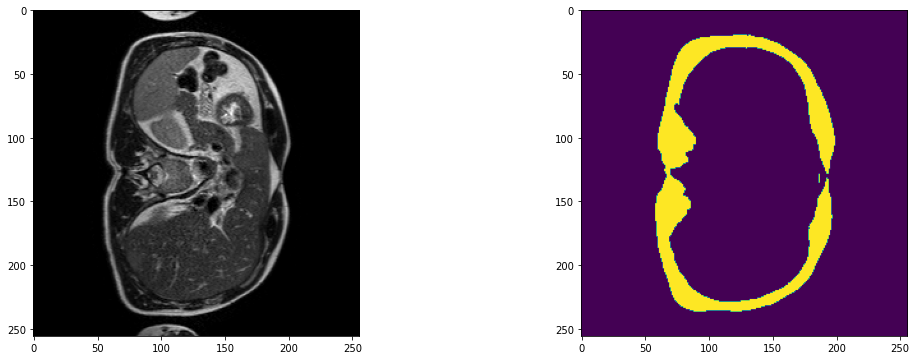

2023-09-14 05:59:08,424 INFO image_writer.py:194 - writing: outMR04_Sep23/A046_v2_T2W_seg.nii.gz


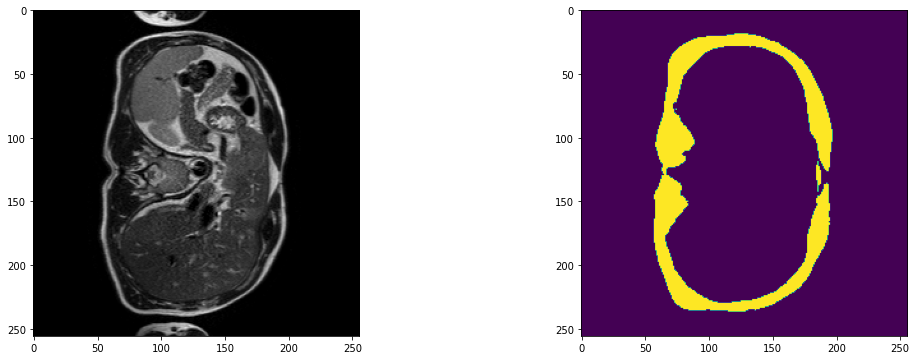

2023-09-14 05:59:10,446 INFO image_writer.py:194 - writing: outMR04_Sep23/A046_v3_T2W_seg.nii.gz


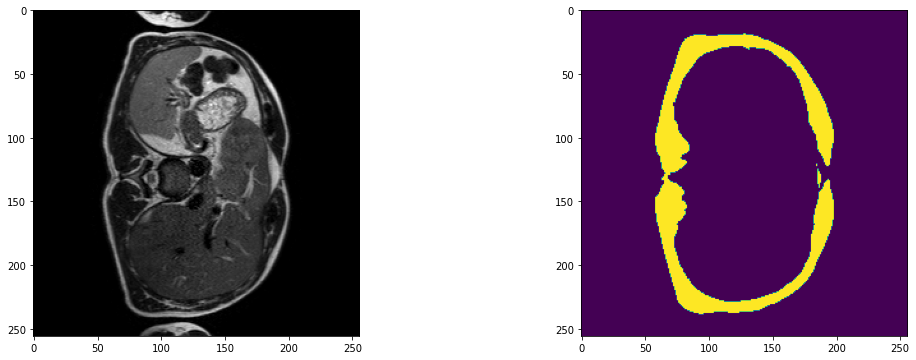

2023-09-14 05:59:12,746 INFO image_writer.py:194 - writing: outMR04_Sep23/A046_v4_T2W_seg.nii.gz


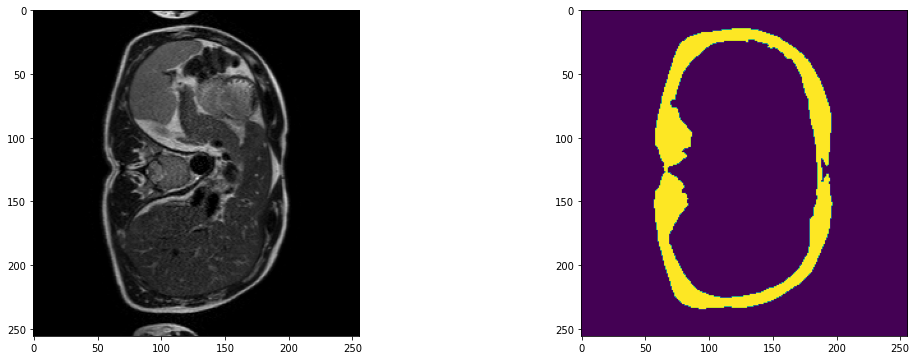

2023-09-14 05:59:15,063 INFO image_writer.py:194 - writing: outMR04_Sep23/A046_v5_T2W_seg.nii.gz


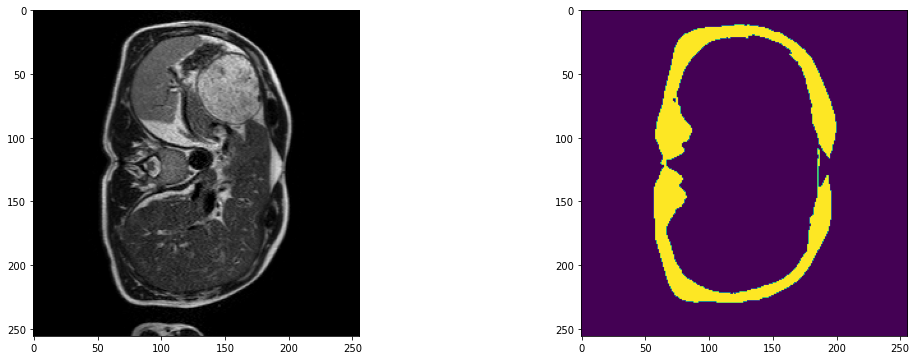

2023-09-14 05:59:17,380 INFO image_writer.py:194 - writing: outMR04_Sep23/A046_v6_T2W_seg.nii.gz


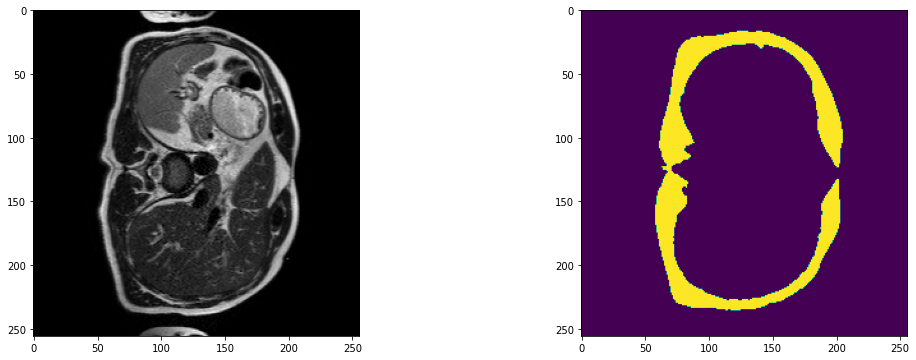

2023-09-14 05:59:19,688 INFO image_writer.py:194 - writing: outMR04_Sep23/A046_v7_T2W_seg.nii.gz


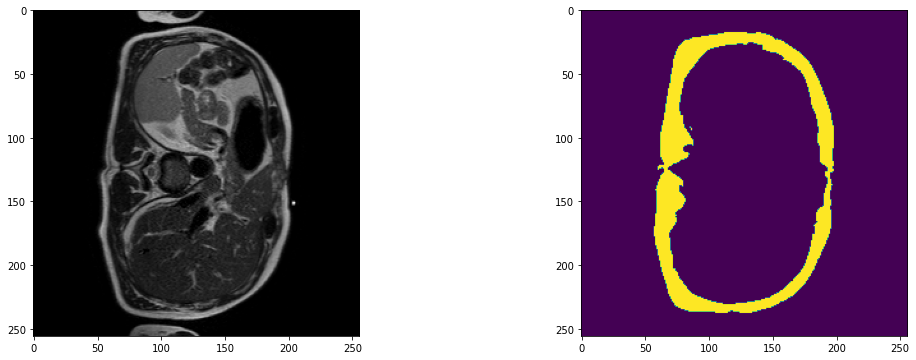

2023-09-14 05:59:21,997 INFO image_writer.py:194 - writing: outMR04_Sep23/A048_v1_T2W_seg.nii.gz


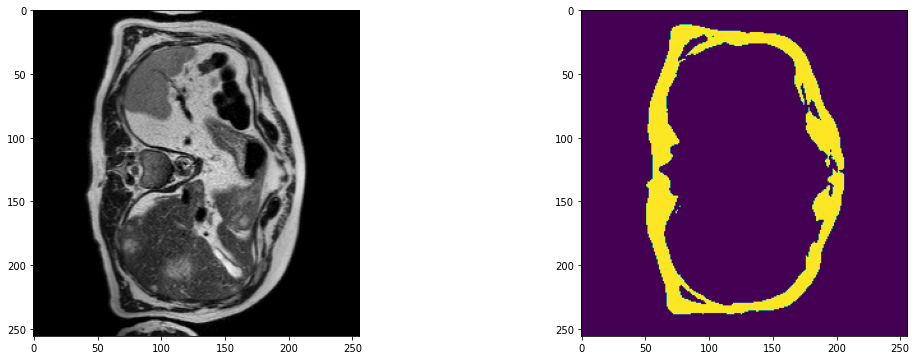

2023-09-14 05:59:24,316 INFO image_writer.py:194 - writing: outMR04_Sep23/A048_v2_T2W_seg.nii.gz


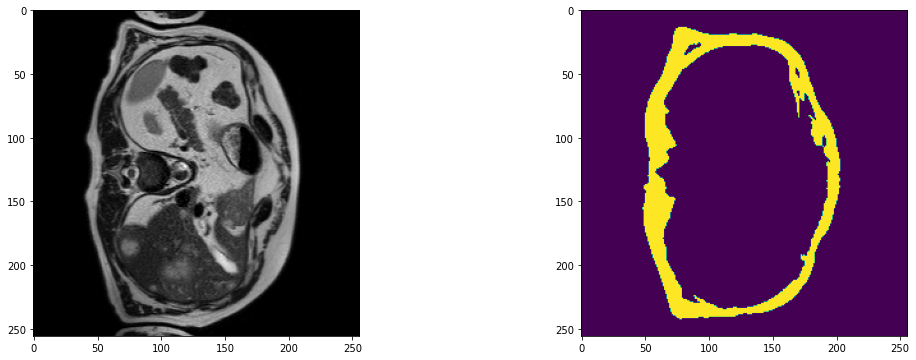

2023-09-14 05:59:26,747 INFO image_writer.py:194 - writing: outMR04_Sep23/A048_v3_T2W_seg.nii.gz


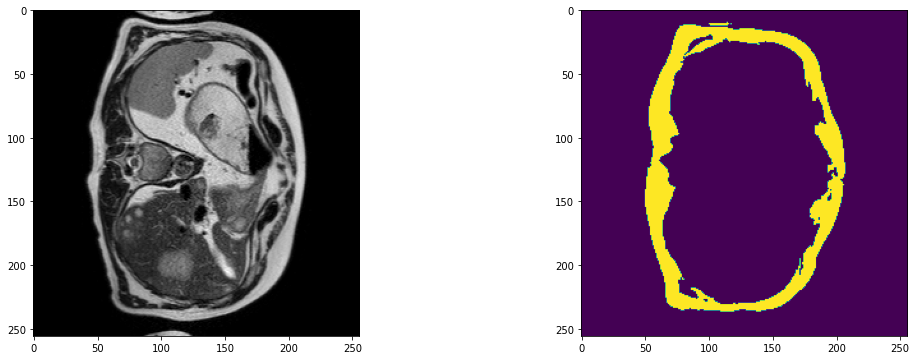

2023-09-14 05:59:29,067 INFO image_writer.py:194 - writing: outMR04_Sep23/A048_v4_T2W_seg.nii.gz


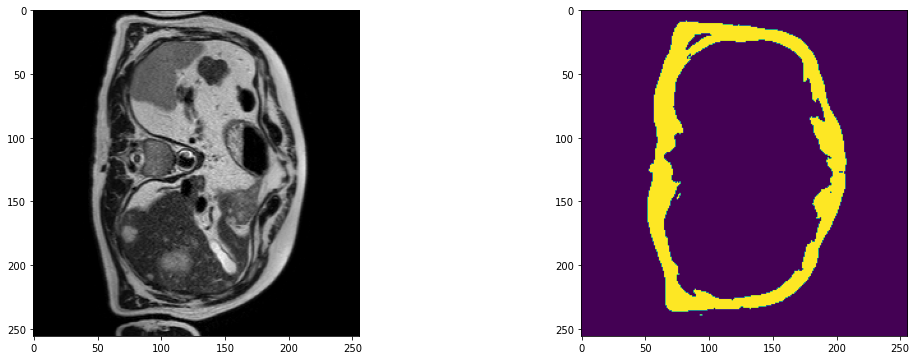

2023-09-14 05:59:31,382 INFO image_writer.py:194 - writing: outMR04_Sep23/A048_v5_T2W_seg.nii.gz


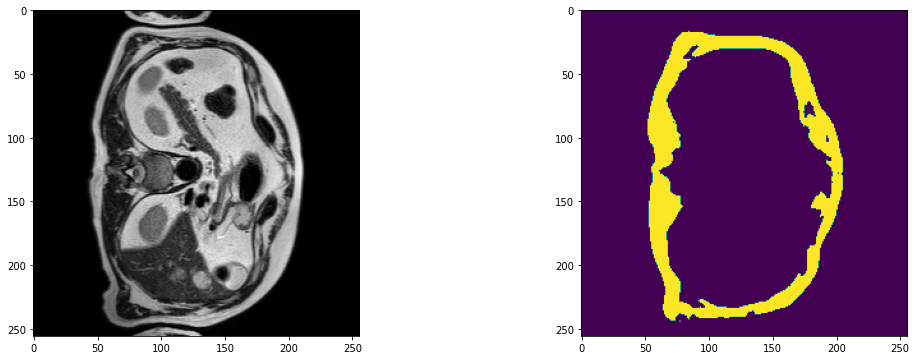

2023-09-14 05:59:33,718 INFO image_writer.py:194 - writing: outMR04_Sep23/A048_v6_T2W_seg.nii.gz


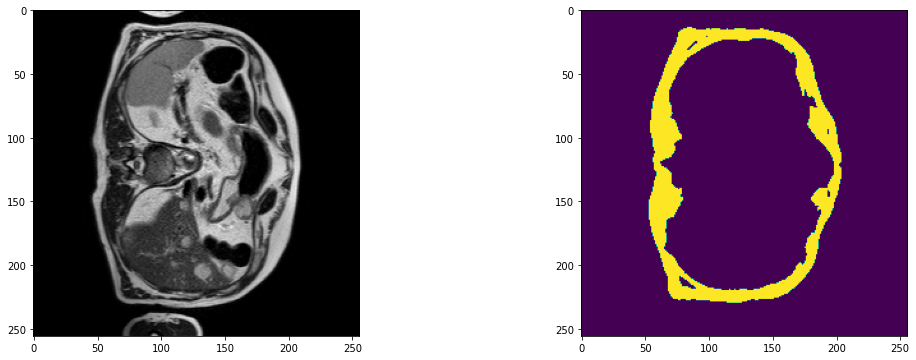

2023-09-14 05:59:36,043 INFO image_writer.py:194 - writing: outMR04_Sep23/A048_v7_T2W_seg.nii.gz


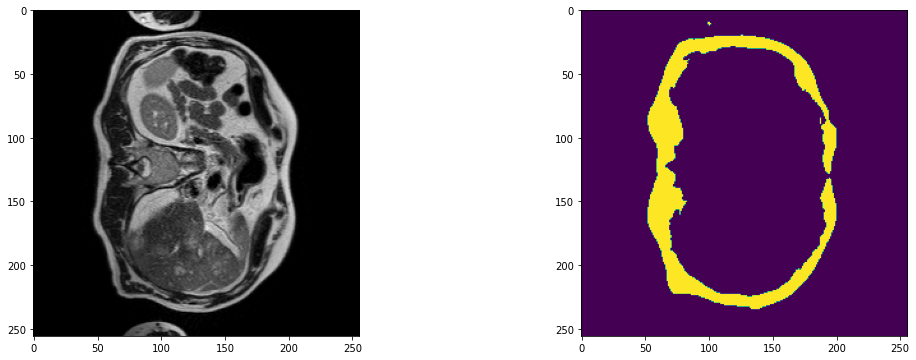

2023-09-14 05:59:38,359 INFO image_writer.py:194 - writing: outMR04_Sep23/A049_v1_T2W_seg.nii.gz


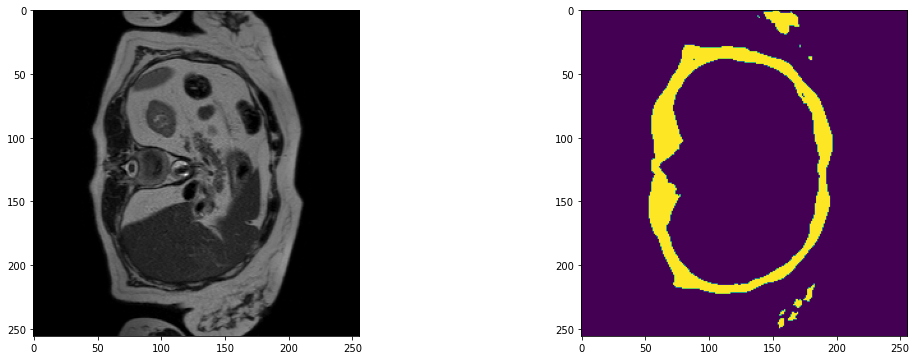

2023-09-14 05:59:40,676 INFO image_writer.py:194 - writing: outMR04_Sep23/A049_v2_T2W_seg.nii.gz


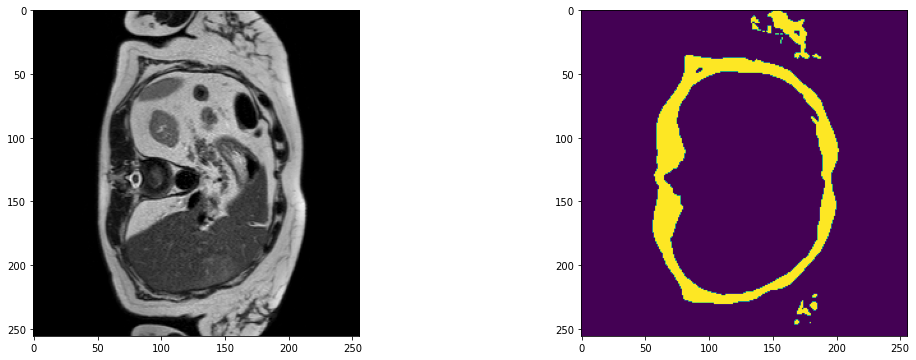

2023-09-14 05:59:42,972 INFO image_writer.py:194 - writing: outMR04_Sep23/A049_v3_T2W_seg.nii.gz


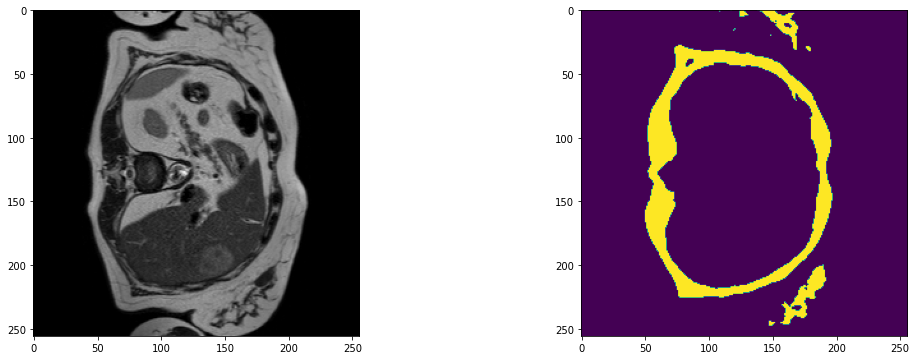

2023-09-14 05:59:45,274 INFO image_writer.py:194 - writing: outMR04_Sep23/A049_v4_T2W_seg.nii.gz


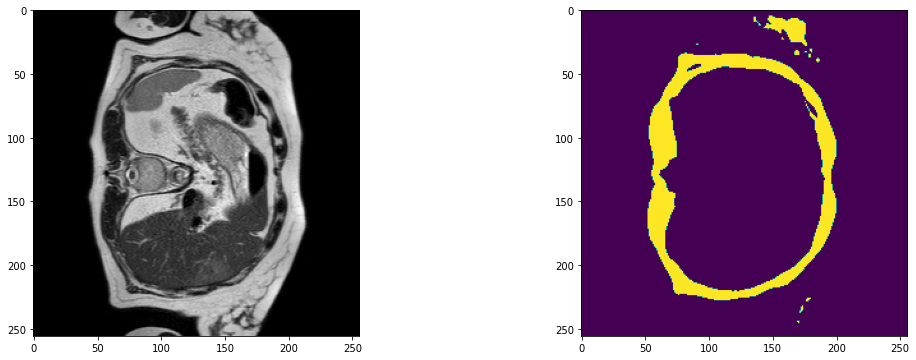

2023-09-14 05:59:47,620 INFO image_writer.py:194 - writing: outMR04_Sep23/A049_v5_T2W_seg.nii.gz


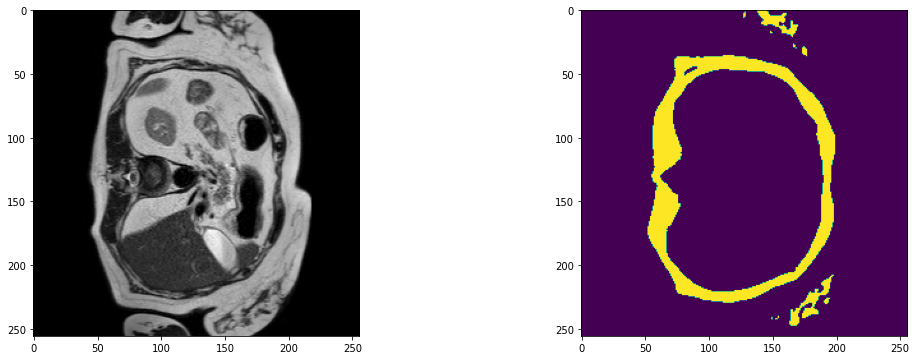

2023-09-14 05:59:53,330 INFO image_writer.py:194 - writing: outMR04_Sep23/A052_v1_T2W_seg.nii.gz


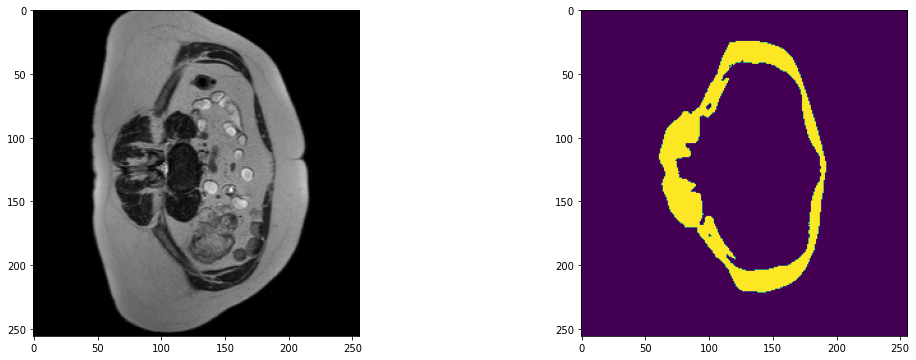

2023-09-14 05:59:58,983 INFO image_writer.py:194 - writing: outMR04_Sep23/A052_v2_T2W_seg.nii.gz


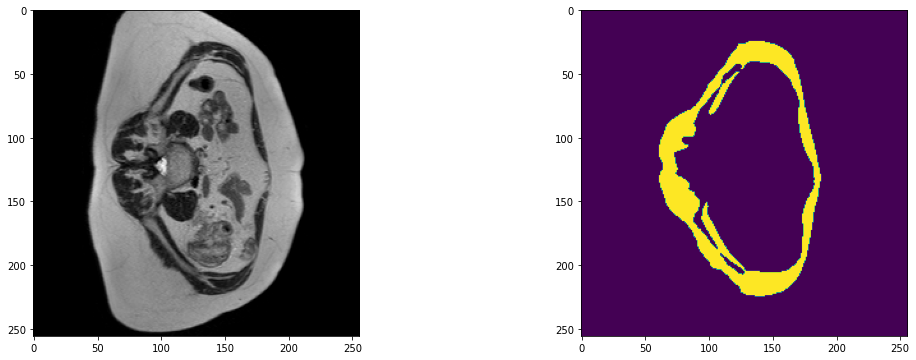

2023-09-14 06:00:04,707 INFO image_writer.py:194 - writing: outMR04_Sep23/A052_v4_T2W_seg.nii.gz


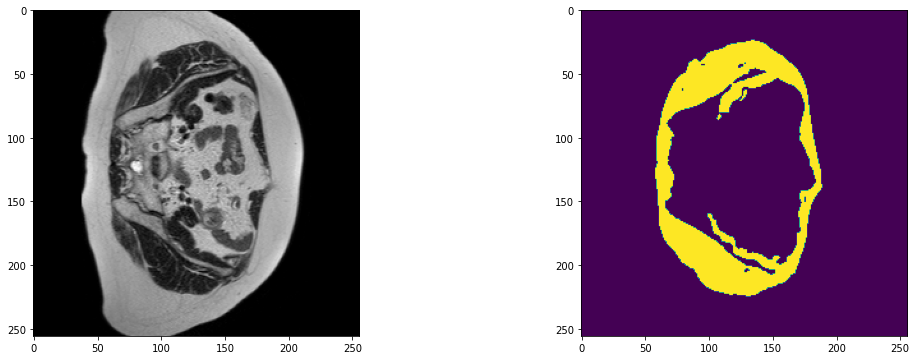

2023-09-14 06:00:10,524 INFO image_writer.py:194 - writing: outMR04_Sep23/A052_v5_T2W_seg.nii.gz


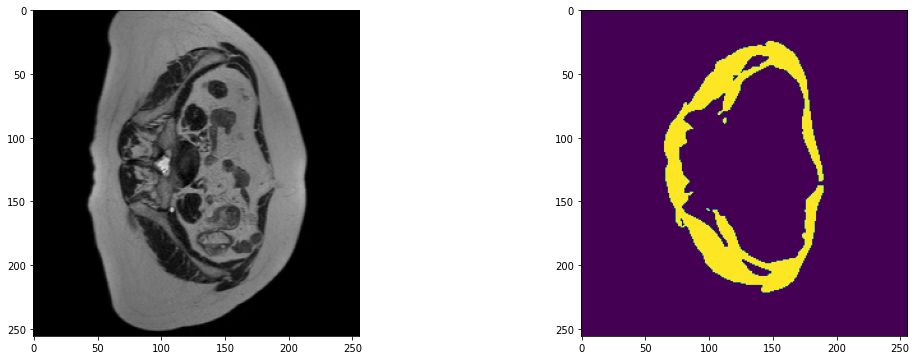

2023-09-14 06:00:12,836 INFO image_writer.py:194 - writing: outMR04_Sep23/A055_v1_T2W_seg.nii.gz


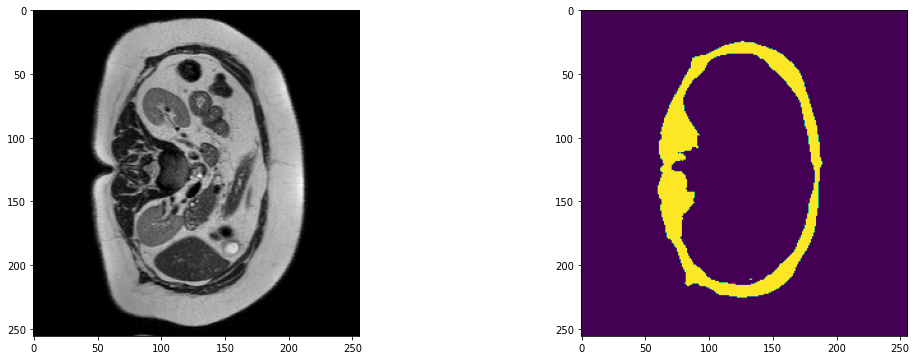

2023-09-14 06:00:15,150 INFO image_writer.py:194 - writing: outMR04_Sep23/A055_v2_T2W_seg.nii.gz


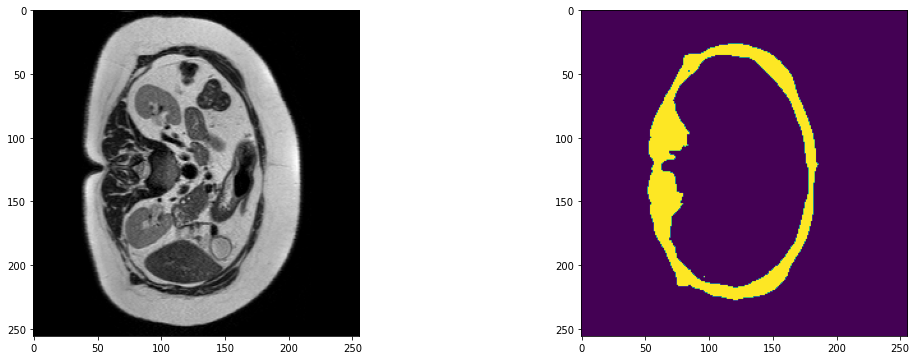

2023-09-14 06:00:17,457 INFO image_writer.py:194 - writing: outMR04_Sep23/A055_v3_T2W_seg.nii.gz


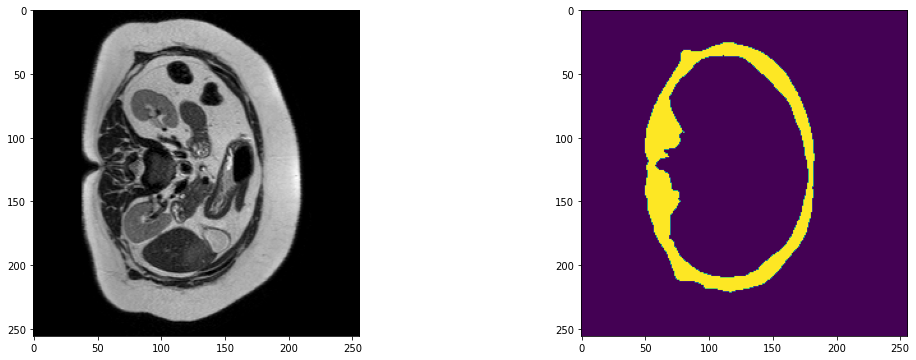

2023-09-14 06:00:19,761 INFO image_writer.py:194 - writing: outMR04_Sep23/A055_v4_T2W_seg.nii.gz


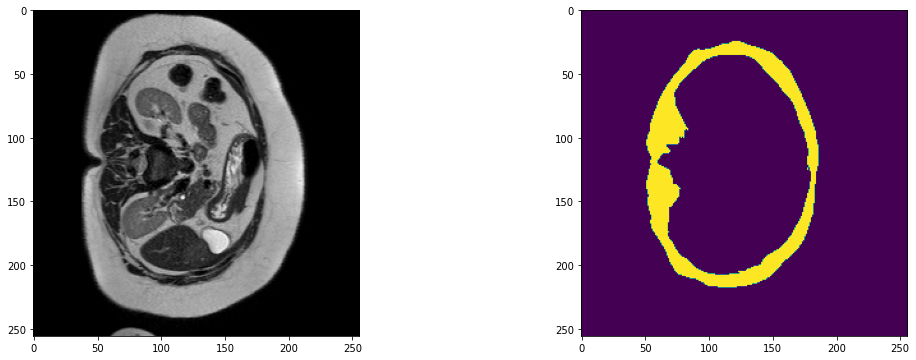

2023-09-14 06:00:22,071 INFO image_writer.py:194 - writing: outMR04_Sep23/A055_v5_T2W_seg.nii.gz


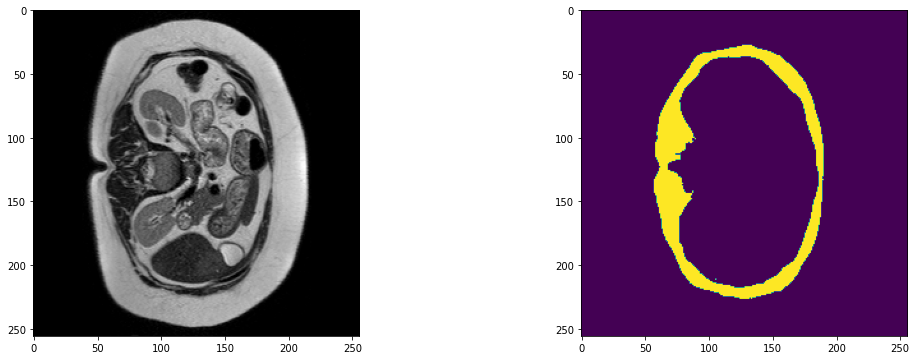

2023-09-14 06:00:24,379 INFO image_writer.py:194 - writing: outMR04_Sep23/A055_v6_T2W_seg.nii.gz


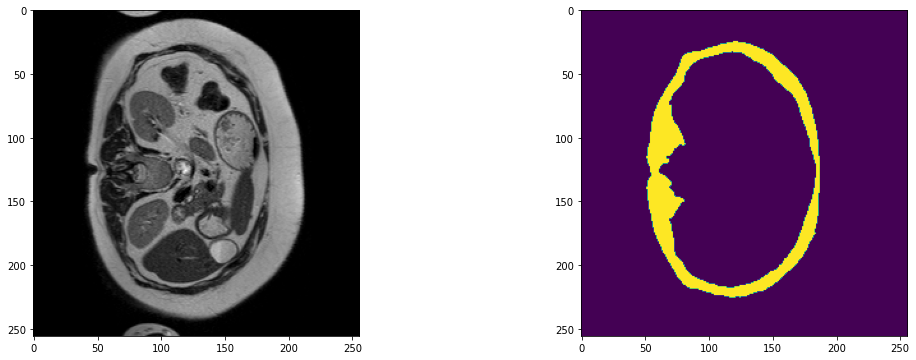

2023-09-14 06:00:26,689 INFO image_writer.py:194 - writing: outMR04_Sep23/A056_v1_T2W_seg.nii.gz


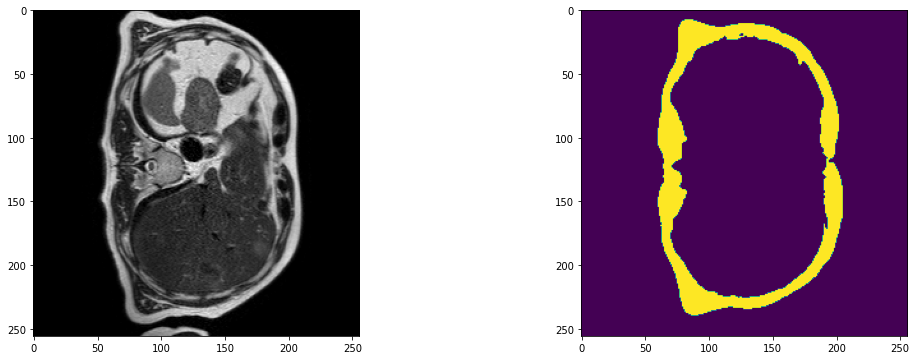

2023-09-14 06:00:29,012 INFO image_writer.py:194 - writing: outMR04_Sep23/A056_v2_T2W_seg.nii.gz


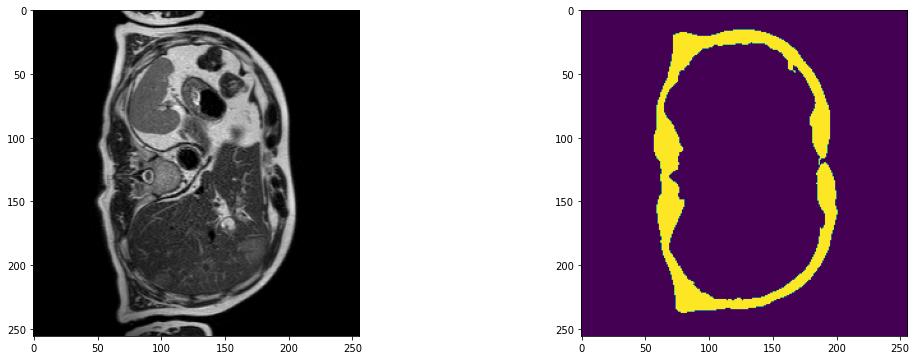

2023-09-14 06:00:31,292 INFO image_writer.py:194 - writing: outMR04_Sep23/A056_v3_T2W_seg.nii.gz


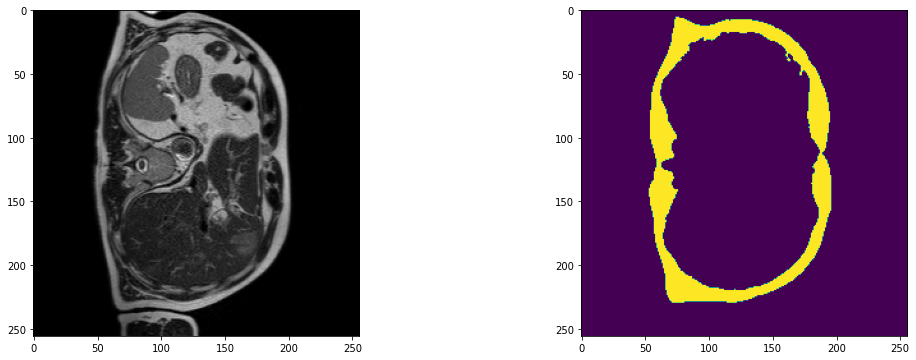

2023-09-14 06:00:33,591 INFO image_writer.py:194 - writing: outMR04_Sep23/A056_v4_T2W_seg.nii.gz


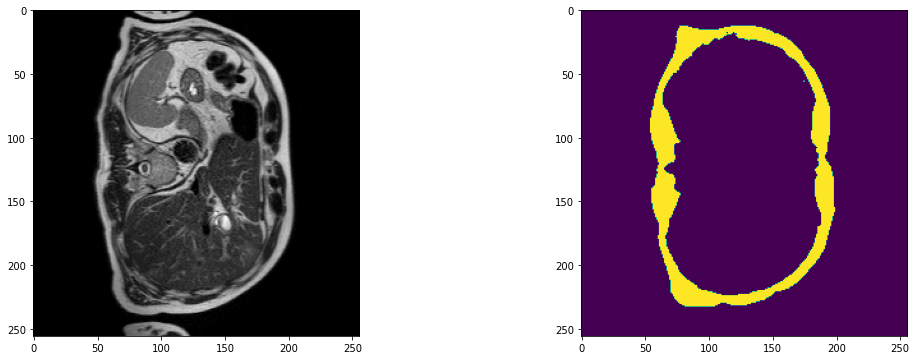

2023-09-14 06:00:35,912 INFO image_writer.py:194 - writing: outMR04_Sep23/A056_v5_T2W_seg.nii.gz


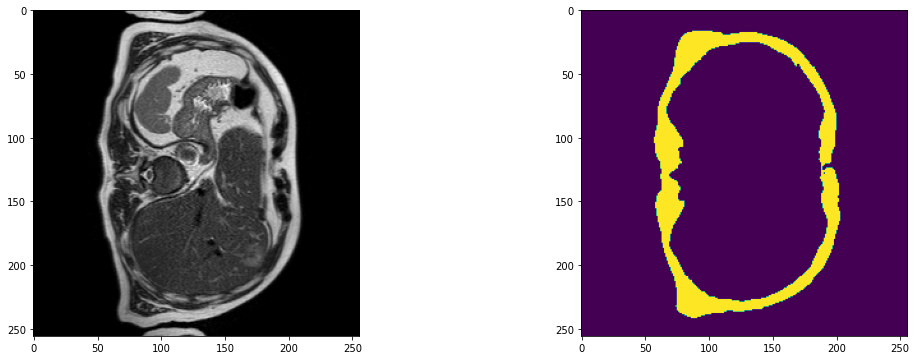

2023-09-14 06:00:38,230 INFO image_writer.py:194 - writing: outMR04_Sep23/A056_v6_T2W_seg.nii.gz


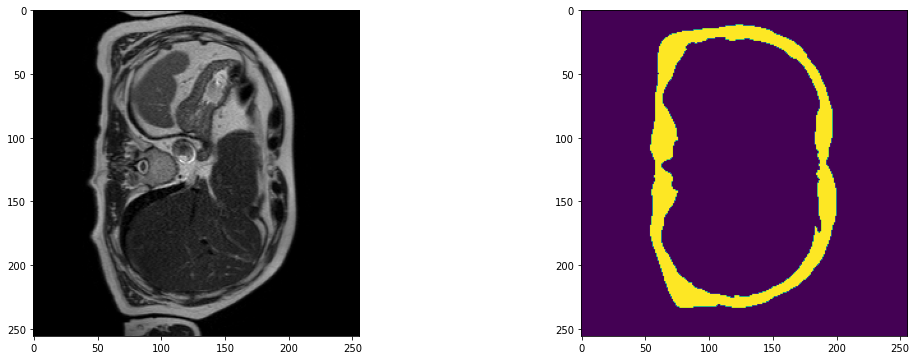

2023-09-14 06:00:40,679 INFO image_writer.py:194 - writing: outMR04_Sep23/A056_v7_T2W_seg.nii.gz


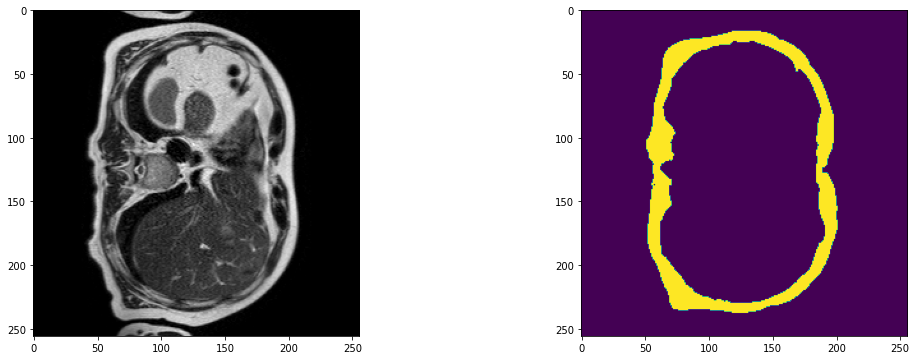

2023-09-14 06:00:43,005 INFO image_writer.py:194 - writing: outMR04_Sep23/A057_v1_T2W_seg.nii.gz


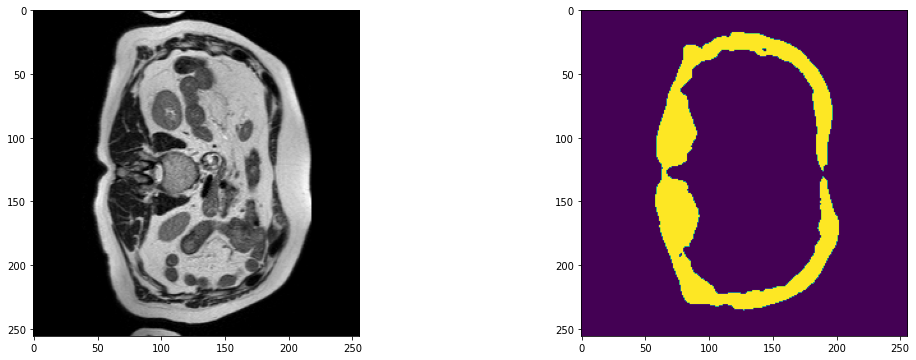

2023-09-14 06:00:45,331 INFO image_writer.py:194 - writing: outMR04_Sep23/A057_v2_T2W_seg.nii.gz


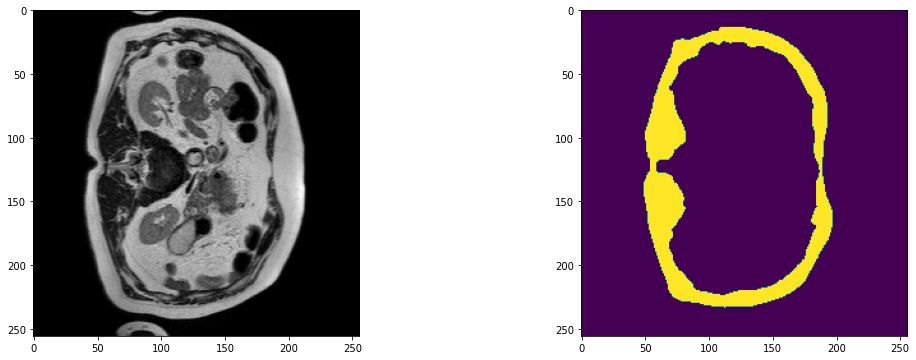

2023-09-14 06:00:47,652 INFO image_writer.py:194 - writing: outMR04_Sep23/A057_v3_T2W_seg.nii.gz


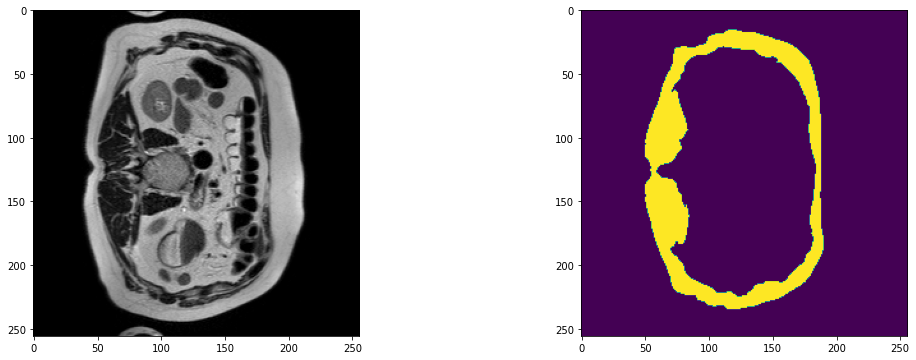

2023-09-14 06:00:49,964 INFO image_writer.py:194 - writing: outMR04_Sep23/A057_v4_T2W_seg.nii.gz


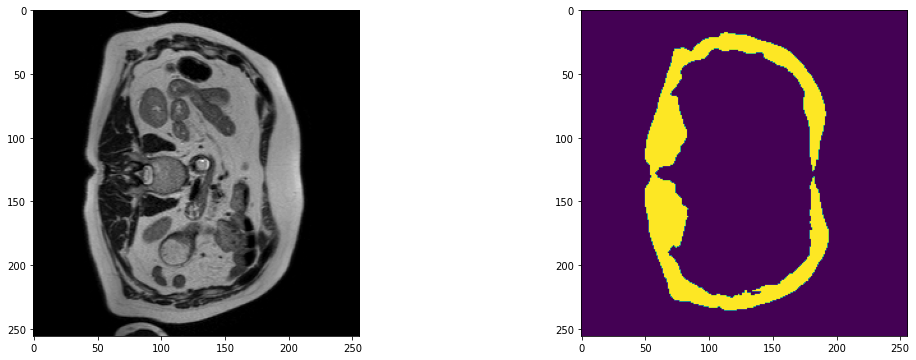

2023-09-14 06:00:52,274 INFO image_writer.py:194 - writing: outMR04_Sep23/A057_v5_T2W_seg.nii.gz


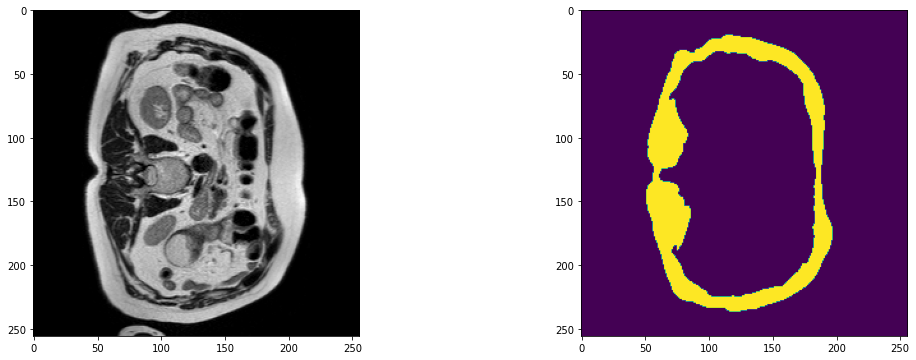

2023-09-14 06:00:54,606 INFO image_writer.py:194 - writing: outMR04_Sep23/A057_v6_T2W_seg.nii.gz


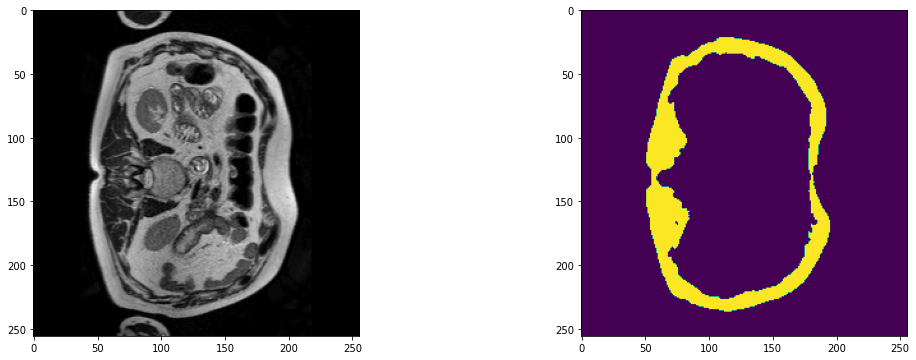

2023-09-14 06:01:00,316 INFO image_writer.py:194 - writing: outMR04_Sep23/A061_v1_T2W_seg.nii.gz


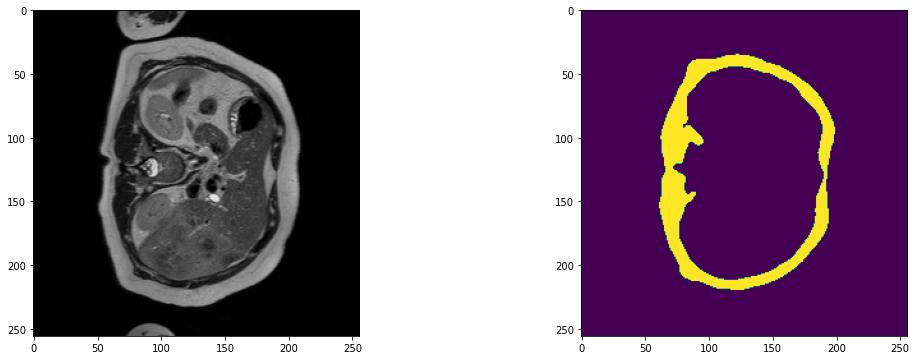

2023-09-14 06:01:06,014 INFO image_writer.py:194 - writing: outMR04_Sep23/A061_v2_T2W_seg.nii.gz


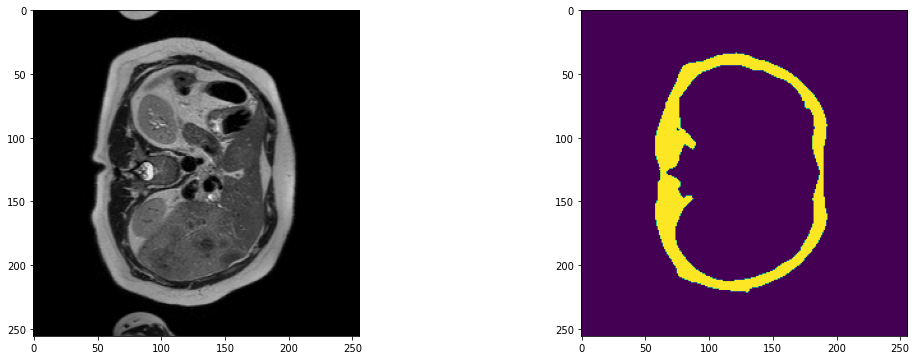

2023-09-14 06:01:11,752 INFO image_writer.py:194 - writing: outMR04_Sep23/A061_v3_T2W_seg.nii.gz


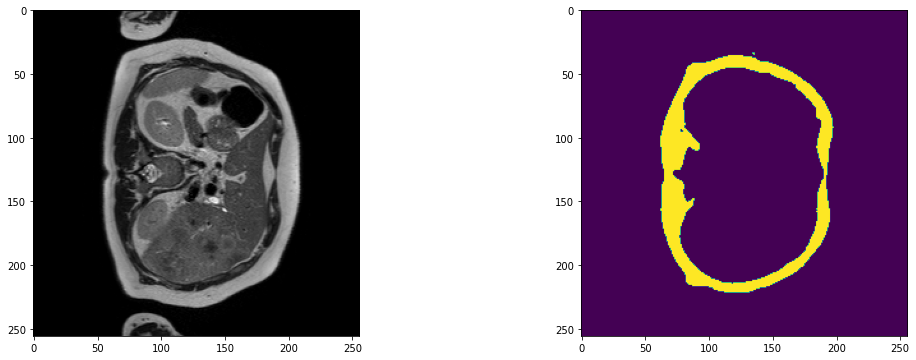

2023-09-14 06:01:17,470 INFO image_writer.py:194 - writing: outMR04_Sep23/A061_v4_T2W_seg.nii.gz


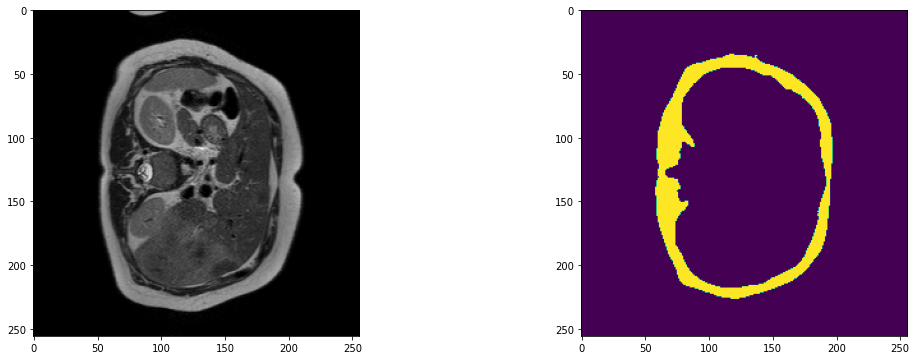

2023-09-14 06:01:23,166 INFO image_writer.py:194 - writing: outMR04_Sep23/A061_v5_T2W_seg.nii.gz


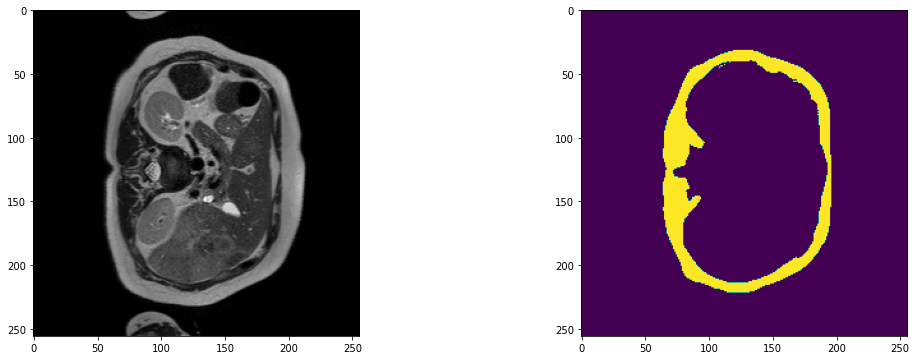

2023-09-14 06:01:25,209 INFO image_writer.py:194 - writing: outMR04_Sep23/A062_v1_T2W_seg.nii.gz


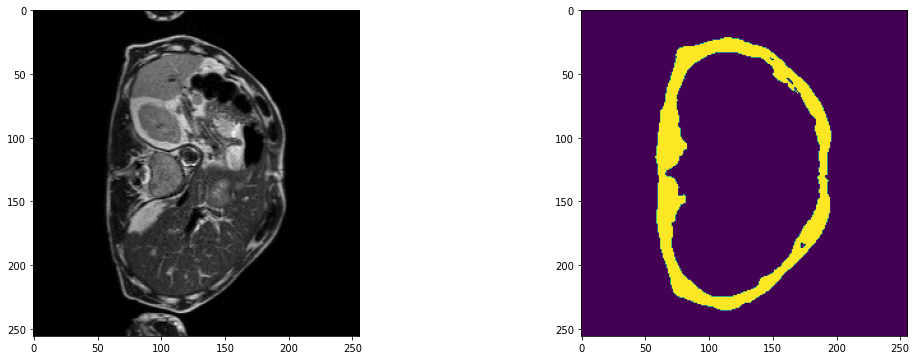

2023-09-14 06:01:27,361 INFO image_writer.py:194 - writing: outMR04_Sep23/A062_v2_T2W_seg.nii.gz


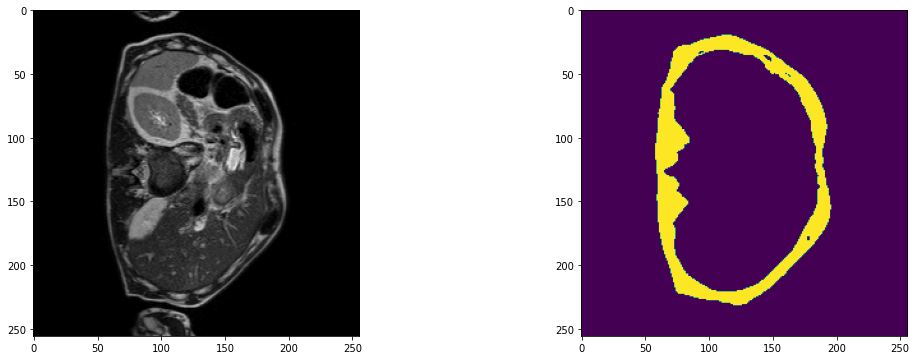

2023-09-14 06:01:29,393 INFO image_writer.py:194 - writing: outMR04_Sep23/A062_v3_T2W_seg.nii.gz


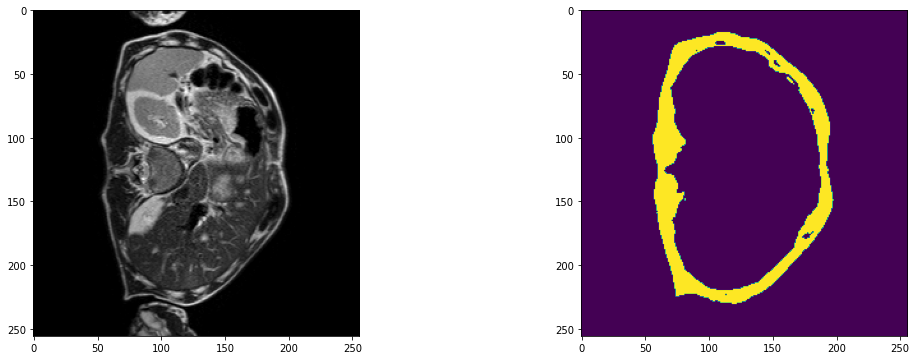

2023-09-14 06:01:31,684 INFO image_writer.py:194 - writing: outMR04_Sep23/A062_v4_T2W_seg.nii.gz


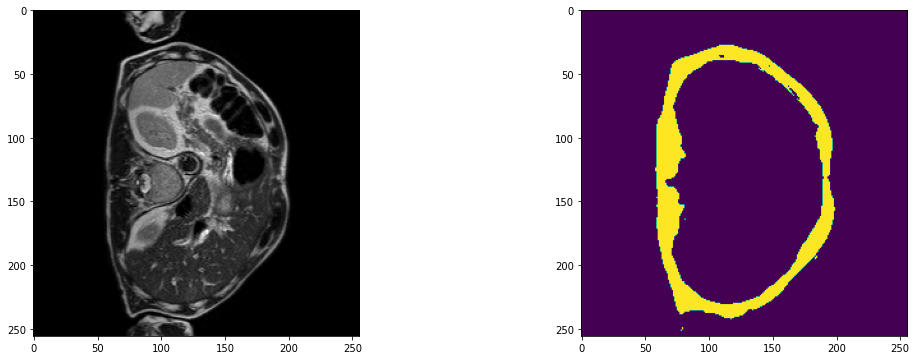

2023-09-14 06:01:33,693 INFO image_writer.py:194 - writing: outMR04_Sep23/A062_v5_T2W_seg.nii.gz


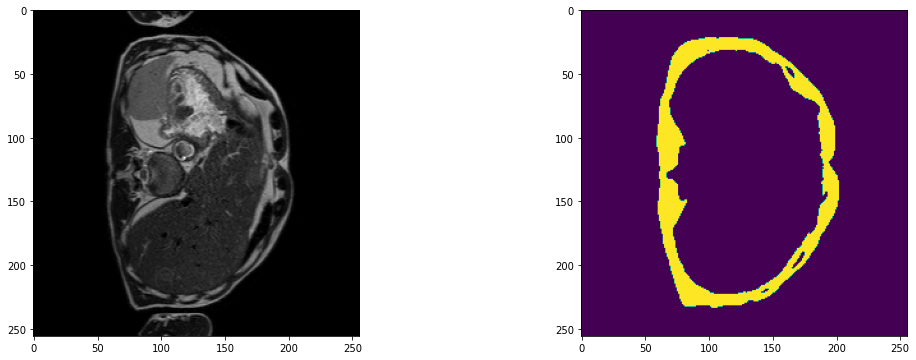

2023-09-14 06:01:36,033 INFO image_writer.py:194 - writing: outMR04_Sep23/A063_v1_T2W_seg.nii.gz


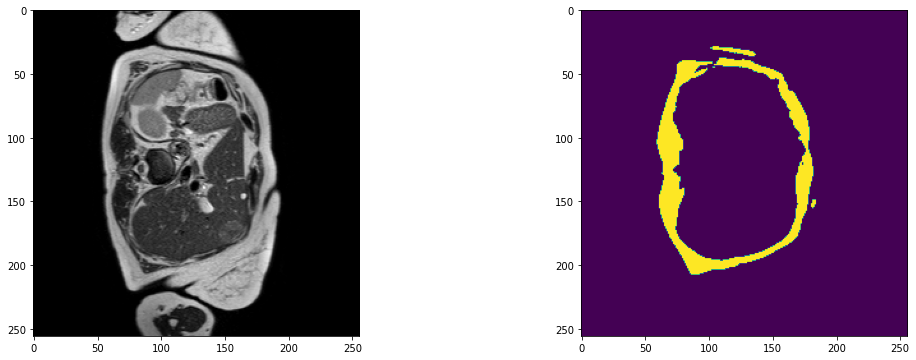

2023-09-14 06:01:38,345 INFO image_writer.py:194 - writing: outMR04_Sep23/A063_v2_T2W_seg.nii.gz


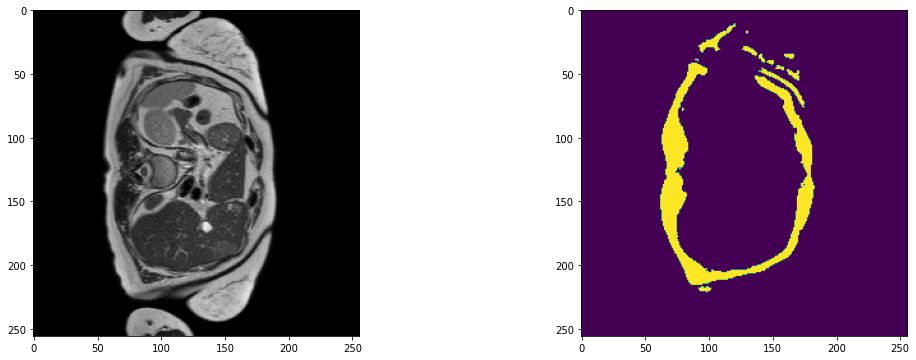

2023-09-14 06:01:40,664 INFO image_writer.py:194 - writing: outMR04_Sep23/A063_v3_T2W_seg.nii.gz


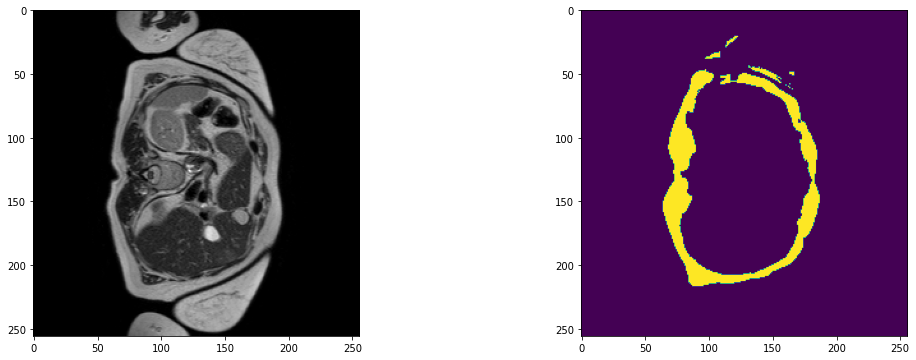

2023-09-14 06:01:42,978 INFO image_writer.py:194 - writing: outMR04_Sep23/A063_v4_T2W_seg.nii.gz


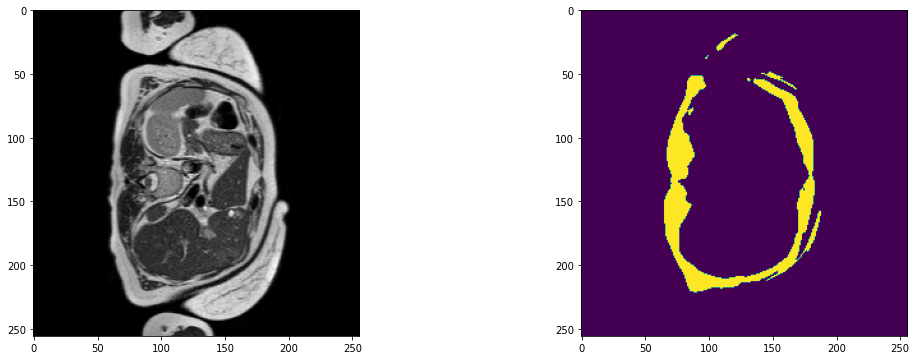

2023-09-14 06:01:44,990 INFO image_writer.py:194 - writing: outMR04_Sep23/A063_v5_T2W_seg.nii.gz


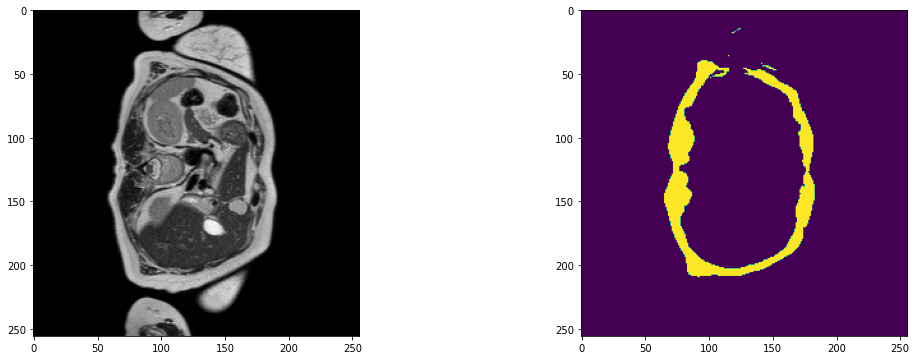

2023-09-14 06:01:47,015 INFO image_writer.py:194 - writing: outMR04_Sep23/A063_v6_T2W_seg.nii.gz


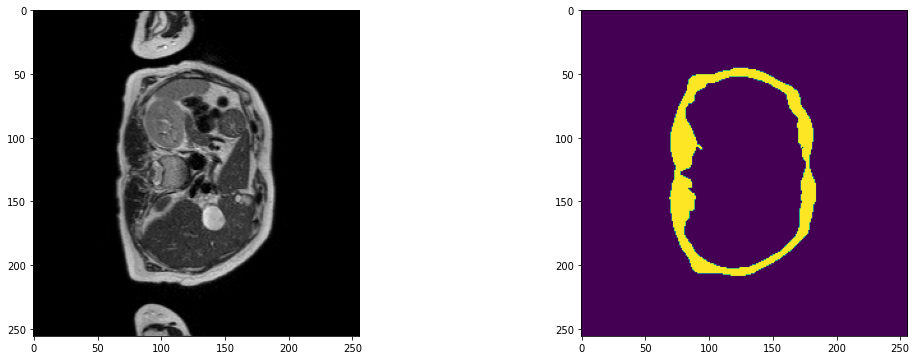

2023-09-14 06:01:49,043 INFO image_writer.py:194 - writing: outMR04_Sep23/A063_v7_T2W_seg.nii.gz


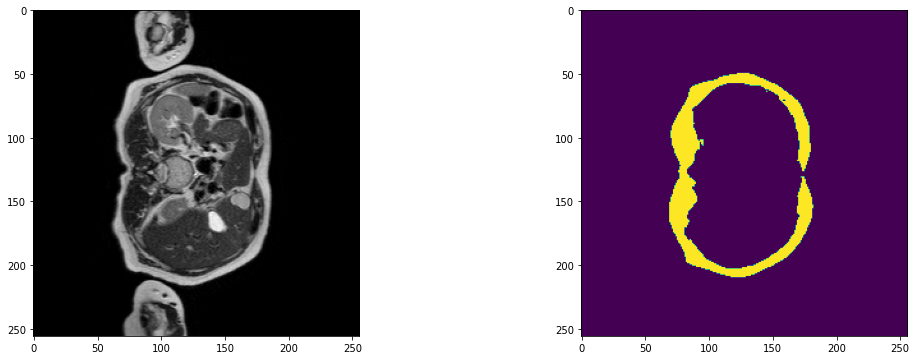

2023-09-14 06:01:51,056 INFO image_writer.py:194 - writing: outMR04_Sep23/A063_v8_T2W_seg.nii.gz


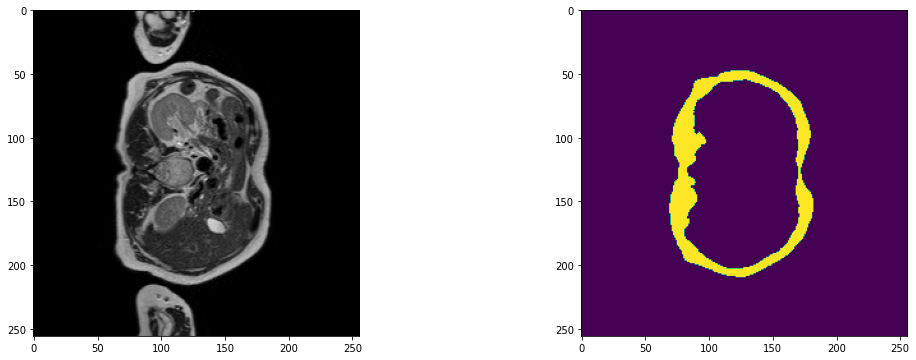

2023-09-14 06:01:53,366 INFO image_writer.py:194 - writing: outMR04_Sep23/A063_v9_T2W_seg.nii.gz


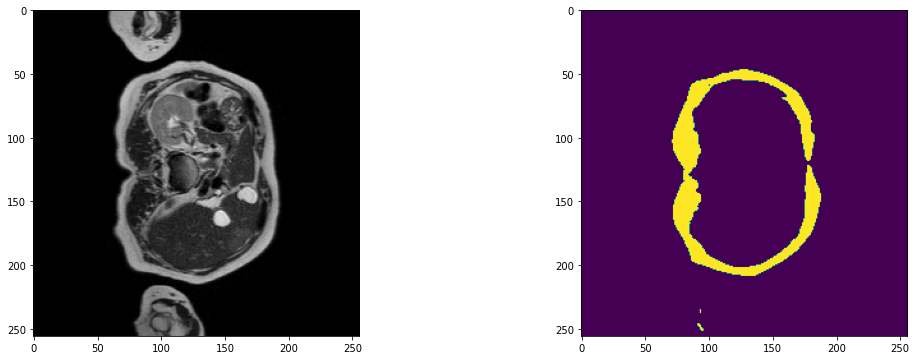

2023-09-14 06:01:55,807 INFO image_writer.py:194 - writing: outMR04_Sep23/A064_v1_T2W_seg.nii.gz


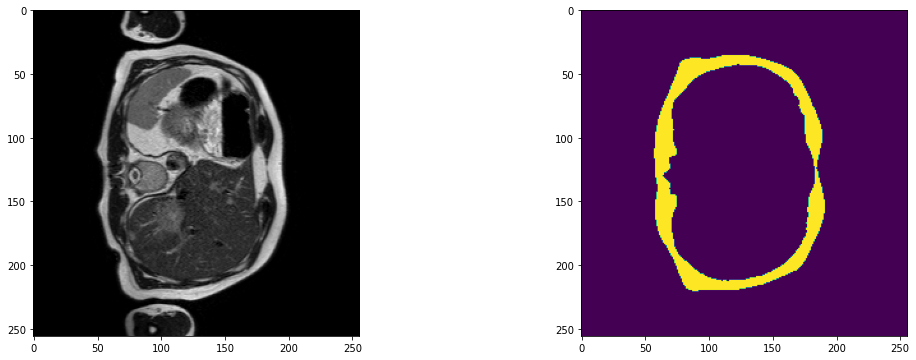

2023-09-14 06:01:58,114 INFO image_writer.py:194 - writing: outMR04_Sep23/A064_v2_T2W_seg.nii.gz


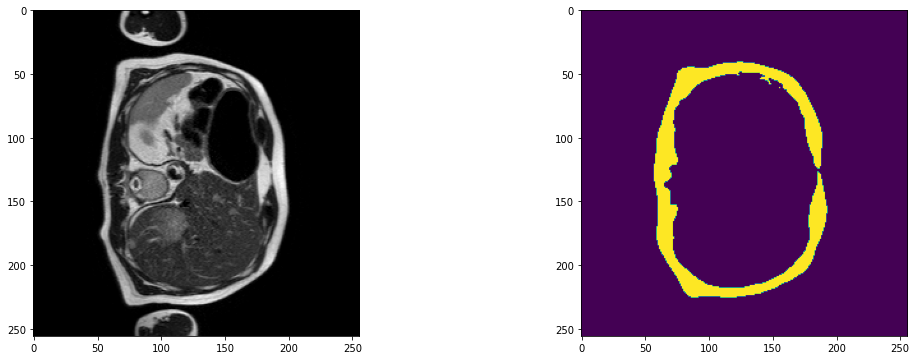

2023-09-14 06:02:00,426 INFO image_writer.py:194 - writing: outMR04_Sep23/A064_v3_T2W_seg.nii.gz


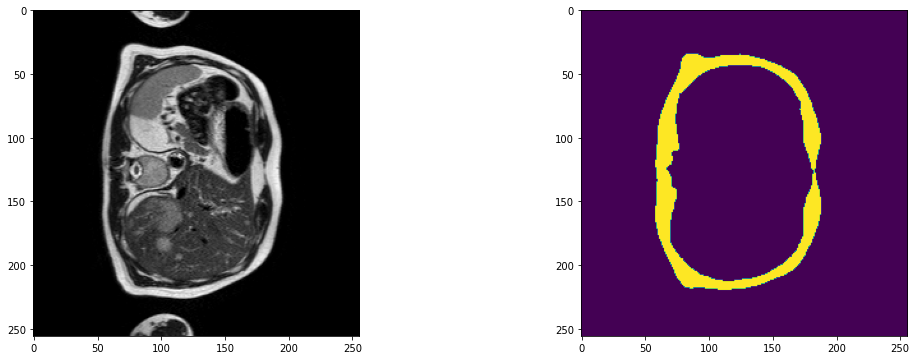

2023-09-14 06:02:02,734 INFO image_writer.py:194 - writing: outMR04_Sep23/A064_v4_T2W_seg.nii.gz


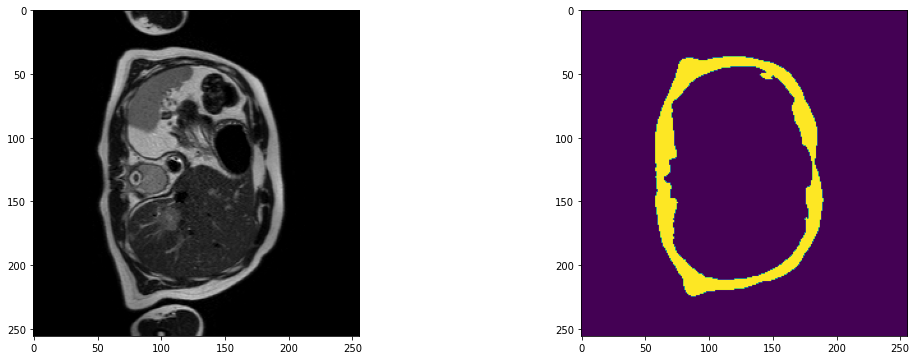

2023-09-14 06:02:05,023 INFO image_writer.py:194 - writing: outMR04_Sep23/A064_v5_T2W_seg.nii.gz


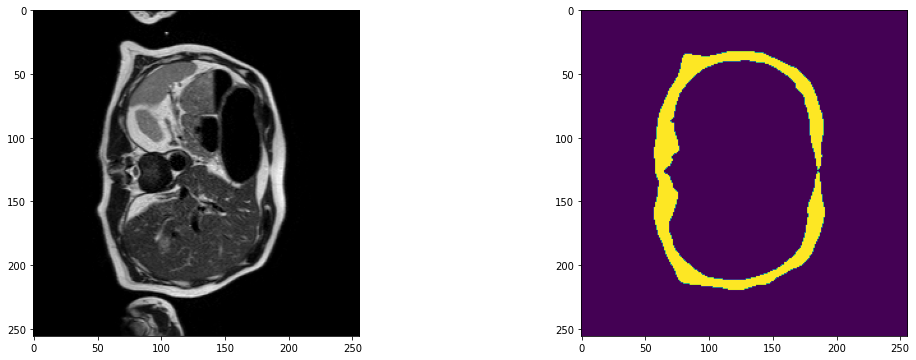

2023-09-14 06:02:07,319 INFO image_writer.py:194 - writing: outMR04_Sep23/A064_v6_T2W_seg.nii.gz


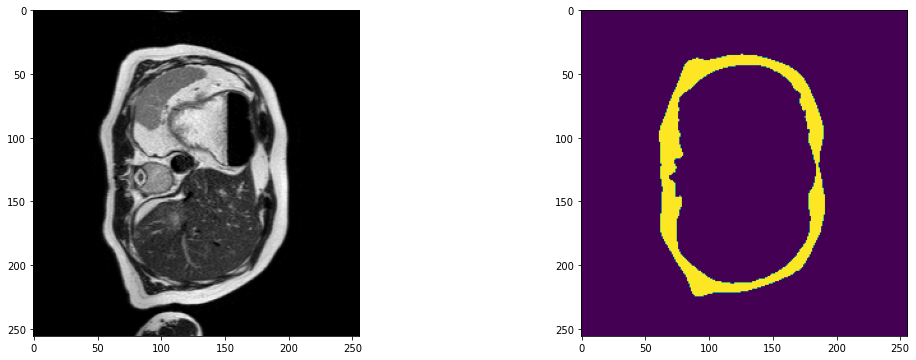

2023-09-14 06:02:09,589 INFO image_writer.py:194 - writing: outMR04_Sep23/A064_v7_T2W_seg.nii.gz


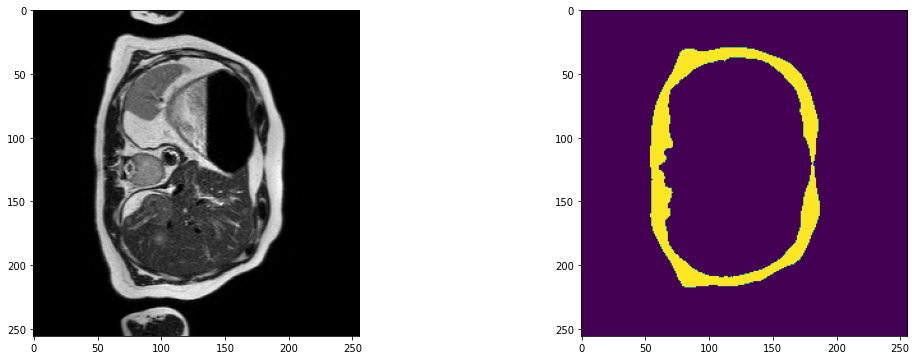

2023-09-14 06:02:11,887 INFO image_writer.py:194 - writing: outMR04_Sep23/A064_v8_T2W_seg.nii.gz


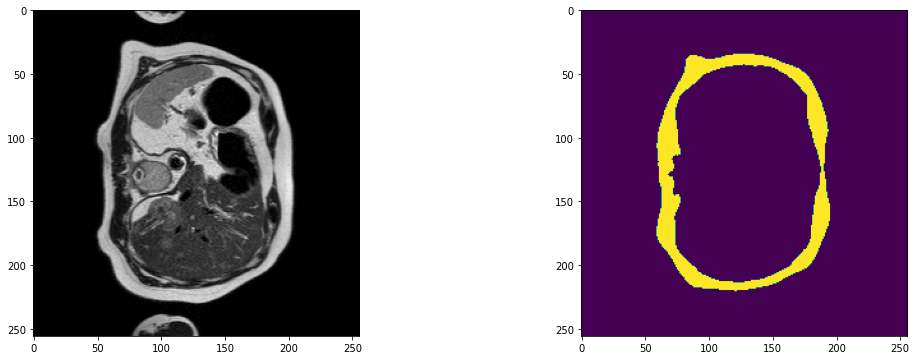

2023-09-14 06:02:14,180 INFO image_writer.py:194 - writing: outMR04_Sep23/A066_v1_T2W_seg.nii.gz


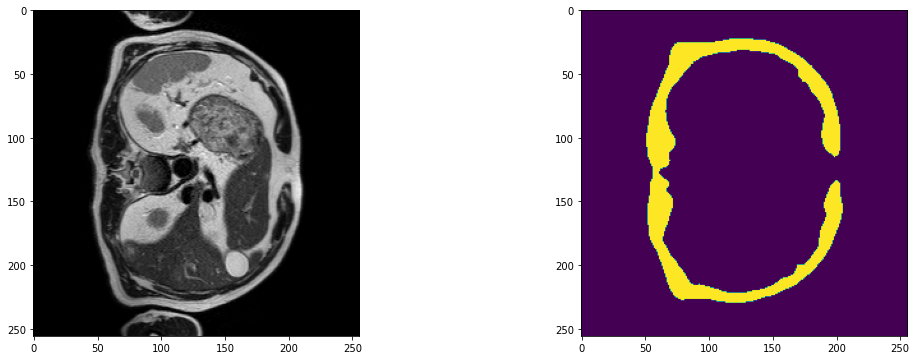

2023-09-14 06:02:16,459 INFO image_writer.py:194 - writing: outMR04_Sep23/A066_v2_T2W_seg.nii.gz


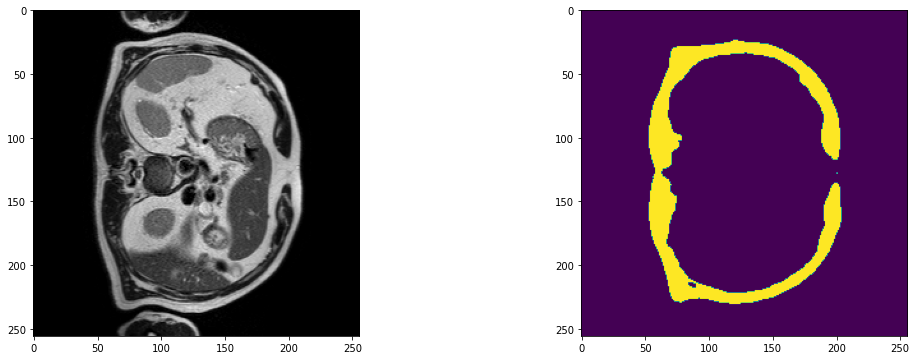

2023-09-14 06:02:18,747 INFO image_writer.py:194 - writing: outMR04_Sep23/A066_v3_T2W_seg.nii.gz


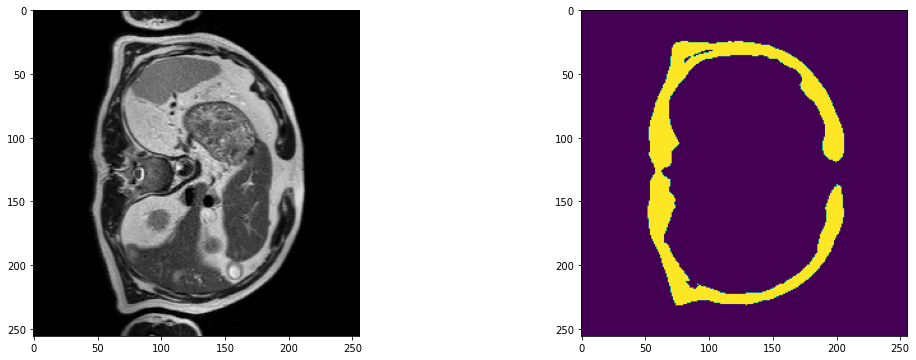

2023-09-14 06:02:21,053 INFO image_writer.py:194 - writing: outMR04_Sep23/A066_v4_T2W_seg.nii.gz


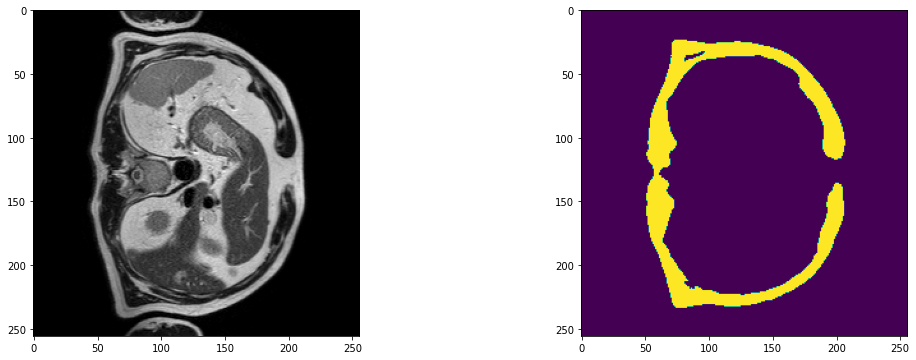

2023-09-14 06:02:23,353 INFO image_writer.py:194 - writing: outMR04_Sep23/A066_v5_T2W_seg.nii.gz


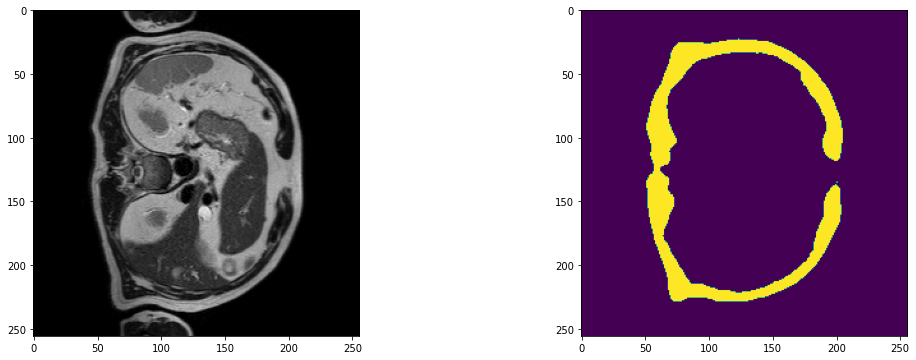

2023-09-14 06:02:25,800 INFO image_writer.py:194 - writing: outMR04_Sep23/A066_v6_T2W_seg.nii.gz


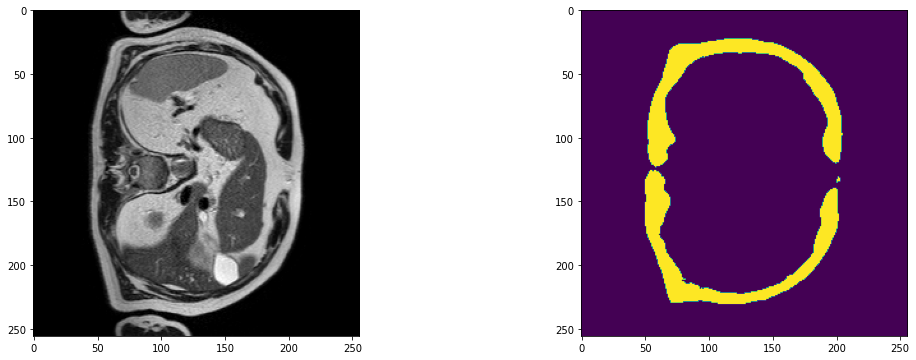

2023-09-14 06:02:28,124 INFO image_writer.py:194 - writing: outMR04_Sep23/A067_v1_T2W_seg.nii.gz


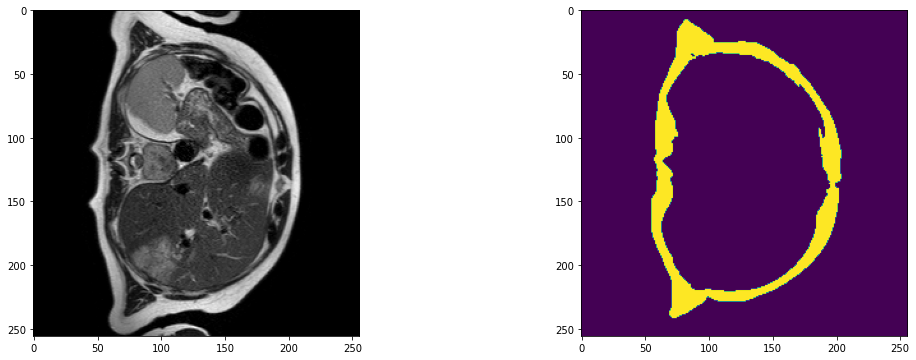

2023-09-14 06:02:30,441 INFO image_writer.py:194 - writing: outMR04_Sep23/A067_v2_T2W_seg.nii.gz


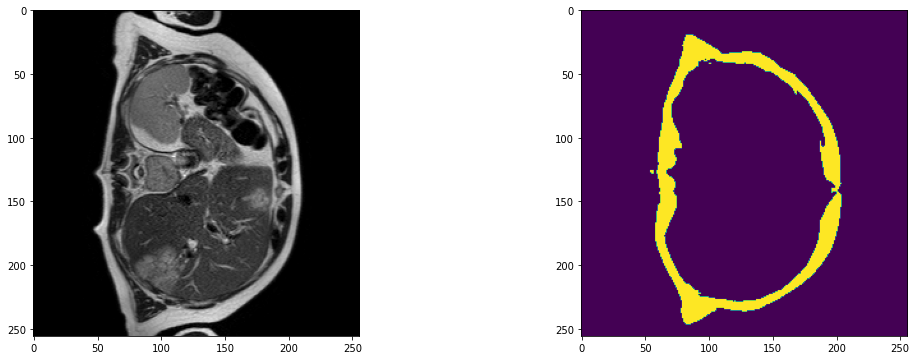

2023-09-14 06:02:32,720 INFO image_writer.py:194 - writing: outMR04_Sep23/A067_v3_T2W_seg.nii.gz


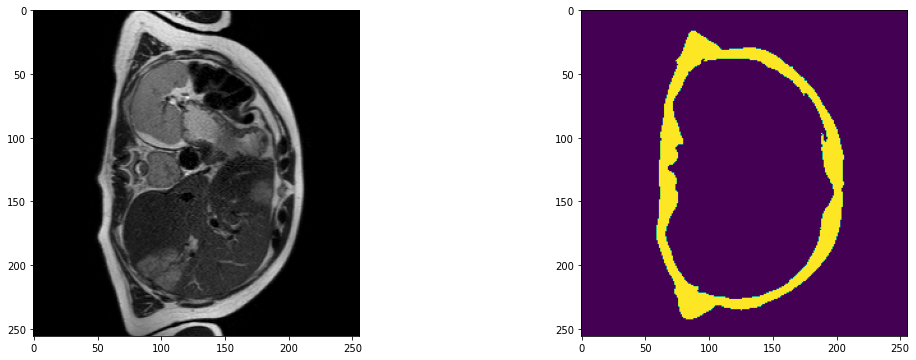

2023-09-14 06:02:35,001 INFO image_writer.py:194 - writing: outMR04_Sep23/A067_v4_T2W_seg.nii.gz


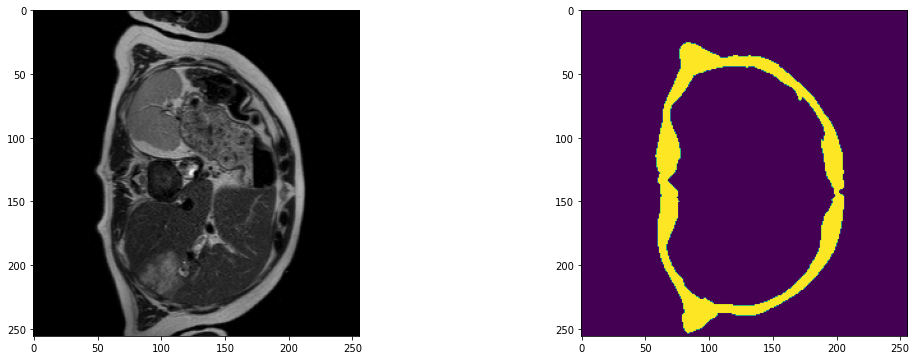

2023-09-14 06:02:37,289 INFO image_writer.py:194 - writing: outMR04_Sep23/A067_v5_T2W_seg.nii.gz


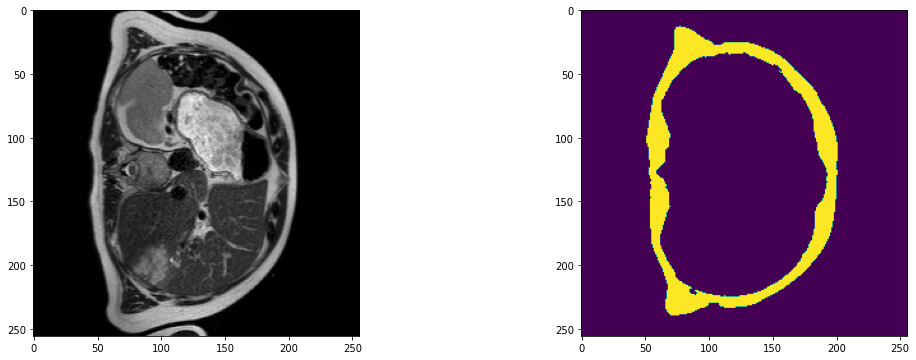

2023-09-14 06:02:39,599 INFO image_writer.py:194 - writing: outMR04_Sep23/A067_v6_T2W_seg.nii.gz


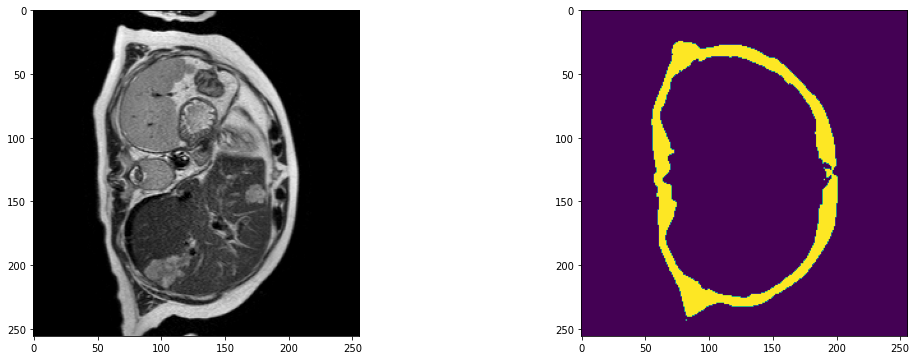

2023-09-14 06:02:41,470 INFO image_writer.py:194 - writing: outMR04_Sep23/A068_v1_T2W_seg.nii.gz


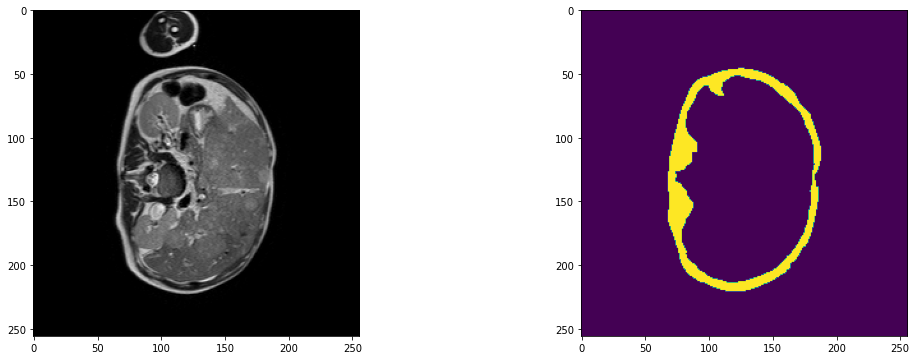

2023-09-14 06:02:43,491 INFO image_writer.py:194 - writing: outMR04_Sep23/A068_v2_T2W_seg.nii.gz


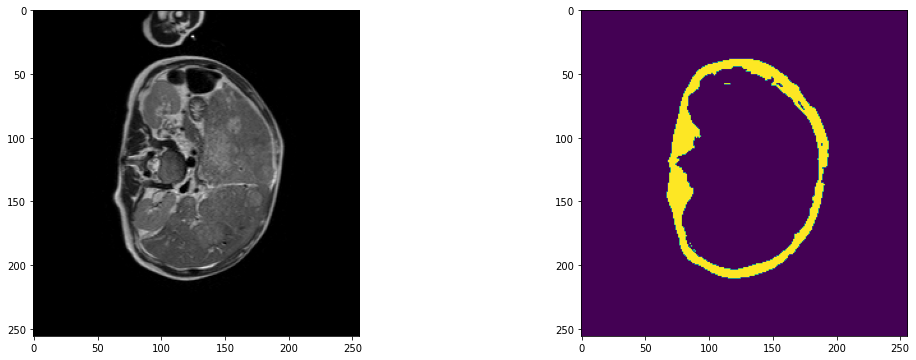

2023-09-14 06:02:45,494 INFO image_writer.py:194 - writing: outMR04_Sep23/A068_v3_T2W_seg.nii.gz


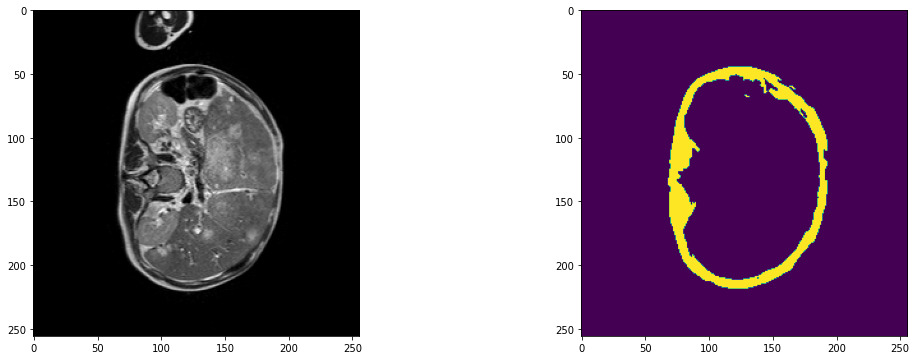

2023-09-14 06:02:47,512 INFO image_writer.py:194 - writing: outMR04_Sep23/A068_v4_T2W_seg.nii.gz


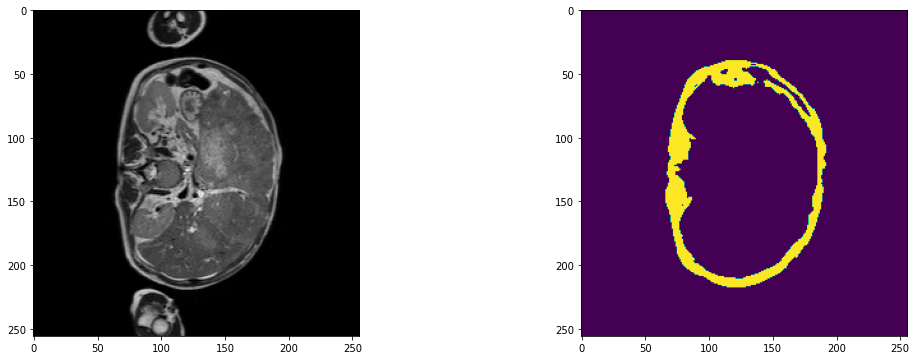

2023-09-14 06:02:49,523 INFO image_writer.py:194 - writing: outMR04_Sep23/A068_v5_T2W_seg.nii.gz


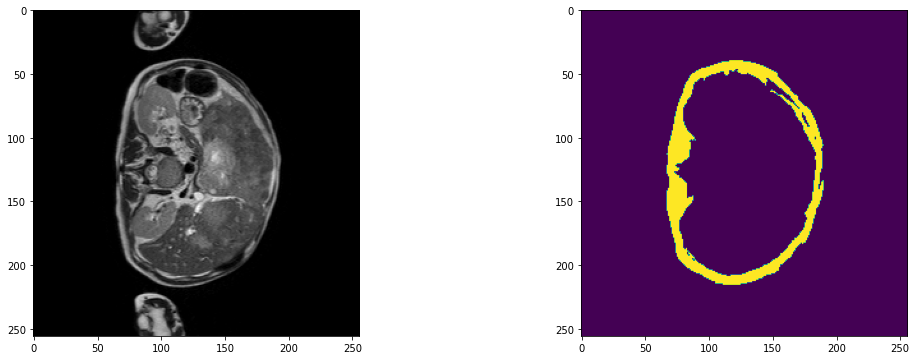

2023-09-14 06:02:51,535 INFO image_writer.py:194 - writing: outMR04_Sep23/A068_v6_T2W_seg.nii.gz


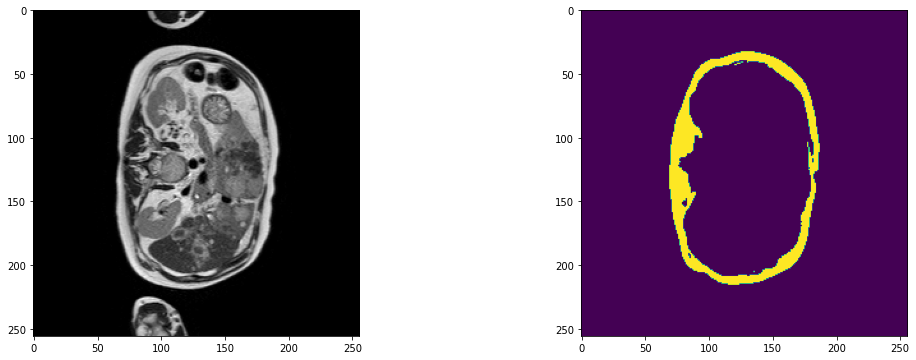

2023-09-14 06:02:53,942 INFO image_writer.py:194 - writing: outMR04_Sep23/A068_v7_T2W_seg.nii.gz


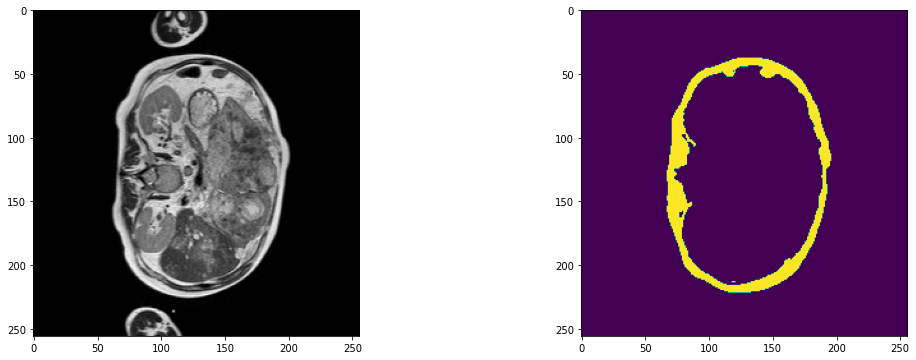

2023-09-14 06:02:55,965 INFO image_writer.py:194 - writing: outMR04_Sep23/A068_v8_T2W_seg.nii.gz


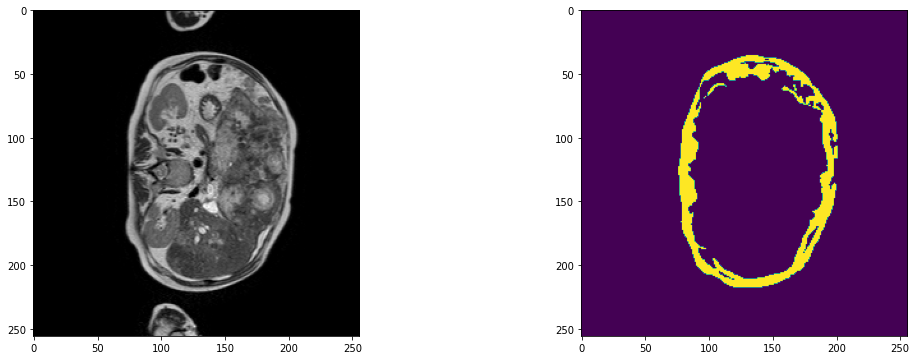

2023-09-14 06:02:58,251 INFO image_writer.py:194 - writing: outMR04_Sep23/A068_v9_T2W_seg.nii.gz


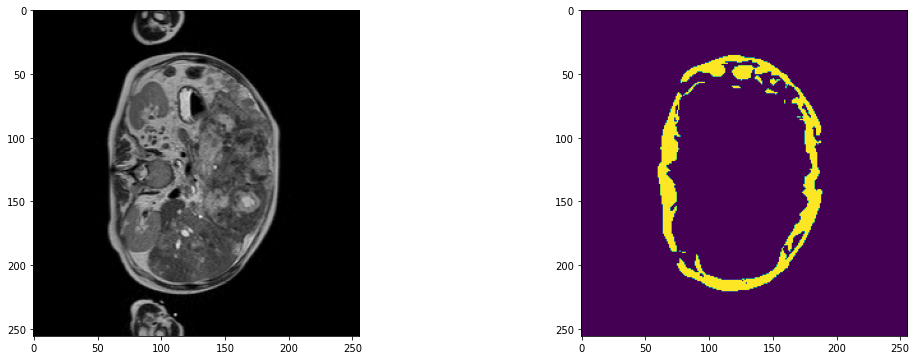

2023-09-14 06:03:03,137 INFO image_writer.py:194 - writing: outMR04_Sep23/A071_v1_T2W_seg.nii.gz


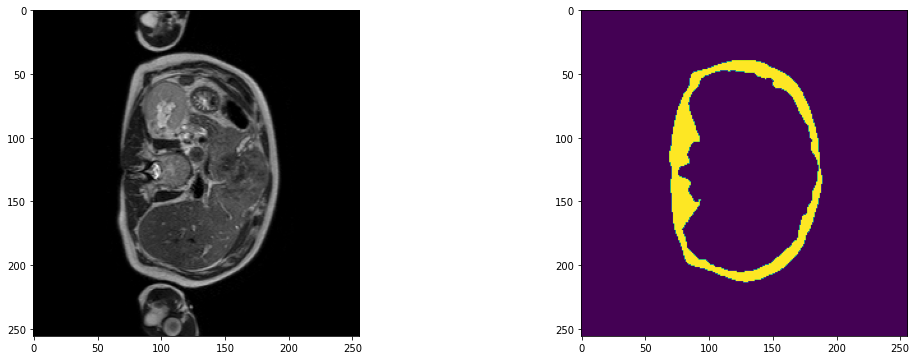

2023-09-14 06:03:08,128 INFO image_writer.py:194 - writing: outMR04_Sep23/A071_v2_T2W_seg.nii.gz


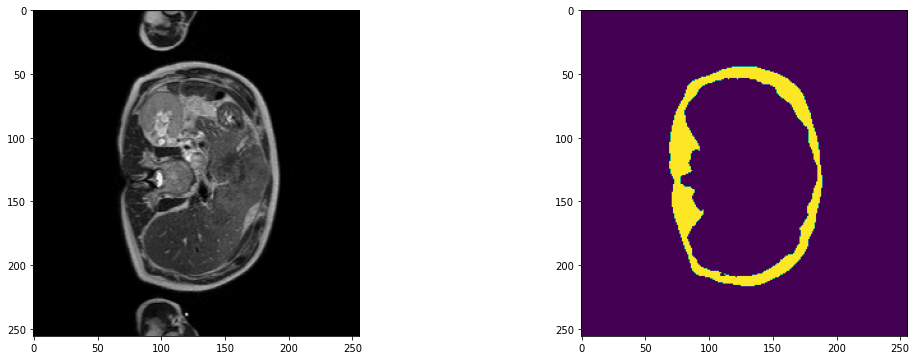

2023-09-14 06:03:12,990 INFO image_writer.py:194 - writing: outMR04_Sep23/A071_v3_T2W_seg.nii.gz


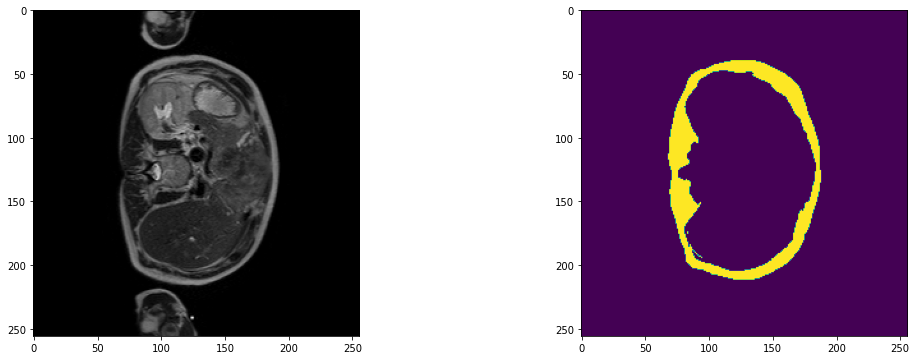

2023-09-14 06:03:18,658 INFO image_writer.py:194 - writing: outMR04_Sep23/A071_v4_T2W_seg.nii.gz


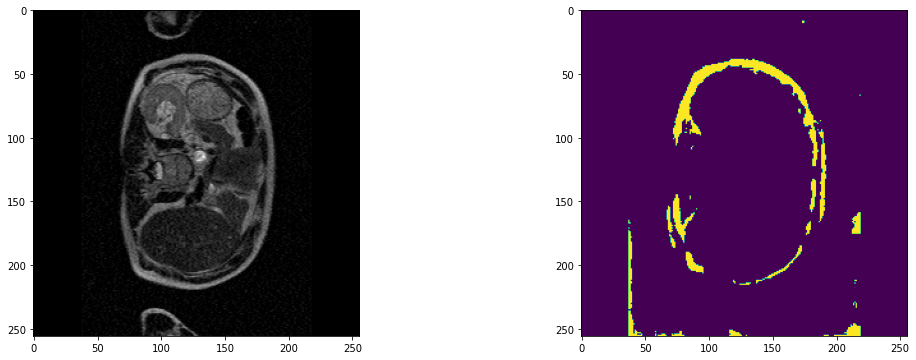

2023-09-14 06:03:23,541 INFO image_writer.py:194 - writing: outMR04_Sep23/A071_v5_T2W_seg.nii.gz


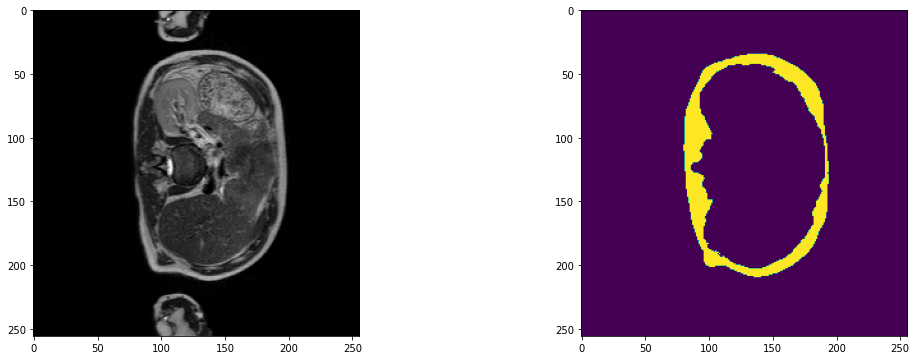

2023-09-14 06:03:28,409 INFO image_writer.py:194 - writing: outMR04_Sep23/A071_v6_T2W_seg.nii.gz


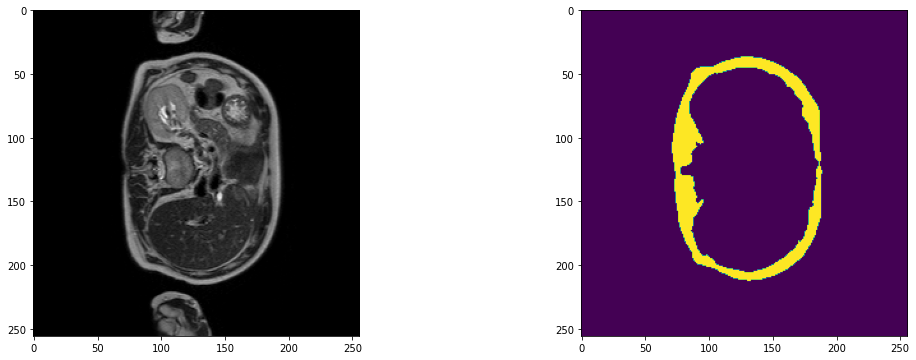

2023-09-14 06:03:33,279 INFO image_writer.py:194 - writing: outMR04_Sep23/A071_v7_T2W_seg.nii.gz


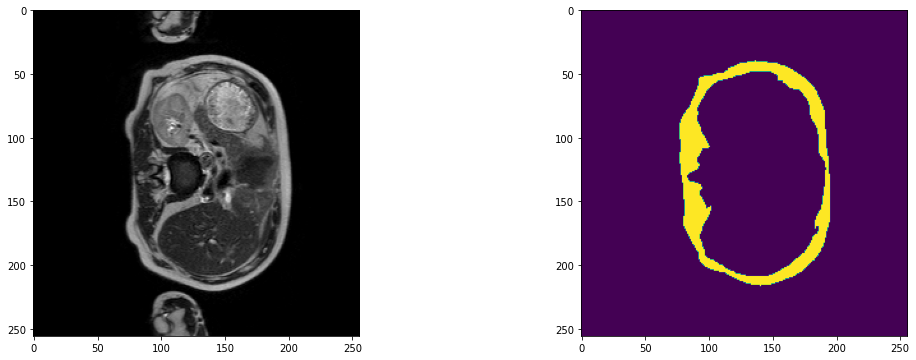

2023-09-14 06:03:38,143 INFO image_writer.py:194 - writing: outMR04_Sep23/A071_v9_T2W_seg.nii.gz


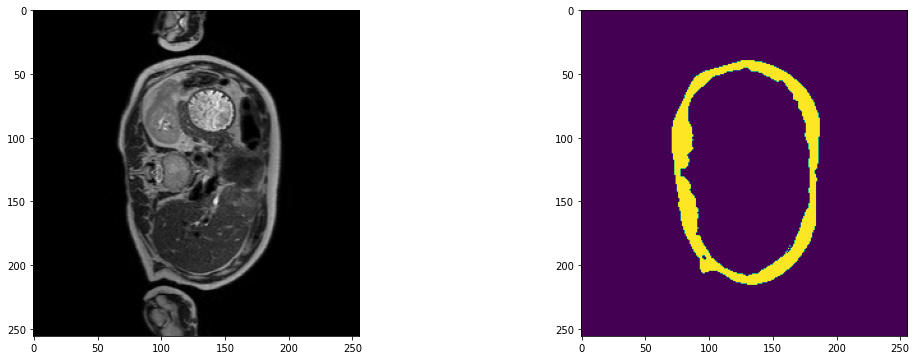

2023-09-14 06:03:43,018 INFO image_writer.py:194 - writing: outMR04_Sep23/A074_v1_T2W_seg.nii.gz


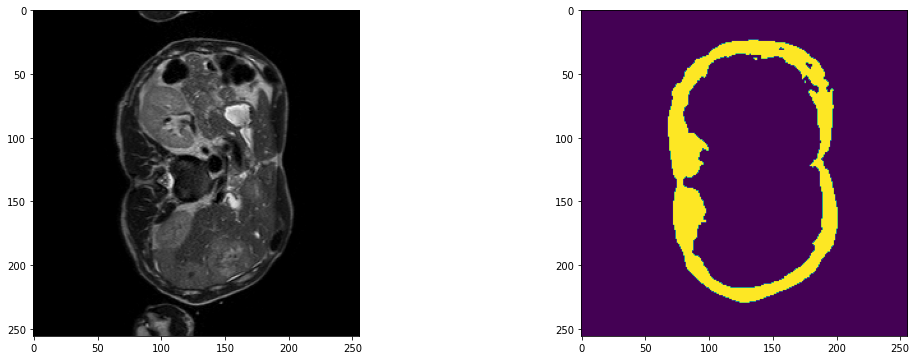

2023-09-14 06:03:48,734 INFO image_writer.py:194 - writing: outMR04_Sep23/A074_v2_T2W_seg.nii.gz


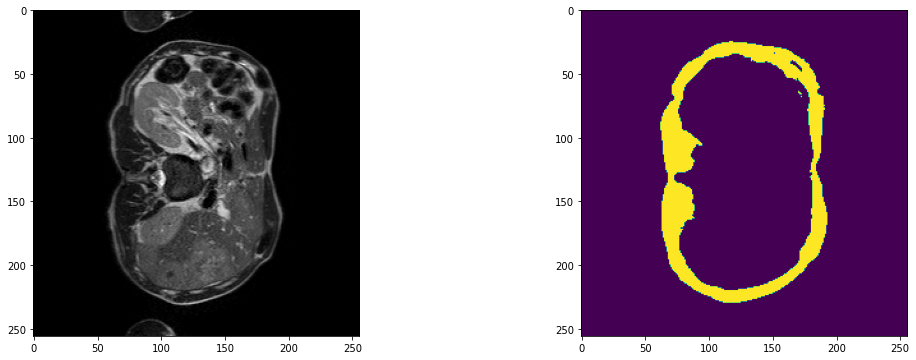

2023-09-14 06:03:54,468 INFO image_writer.py:194 - writing: outMR04_Sep23/A074_v3_T2W_seg.nii.gz


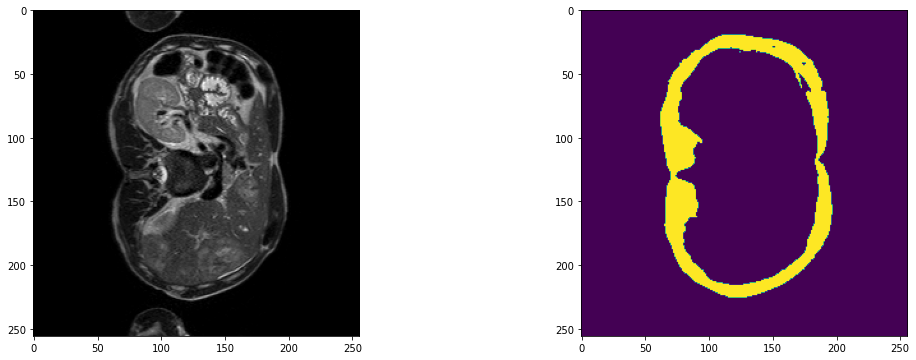

2023-09-14 06:03:59,494 INFO image_writer.py:194 - writing: outMR04_Sep23/A074_v4_T2W_seg.nii.gz


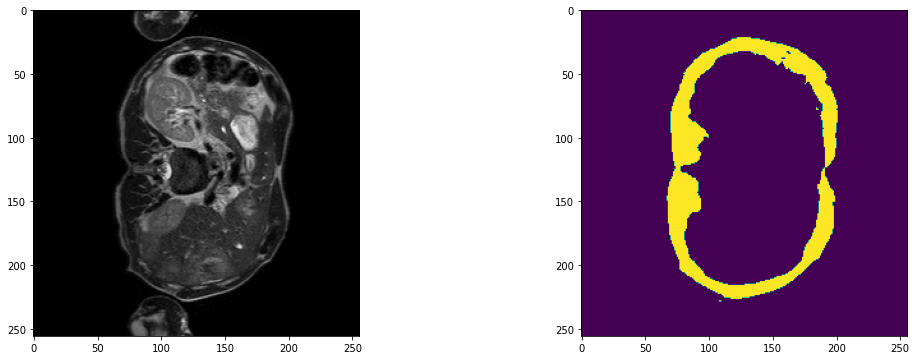

2023-09-14 06:04:04,371 INFO image_writer.py:194 - writing: outMR04_Sep23/A074_v5_T2W_seg.nii.gz


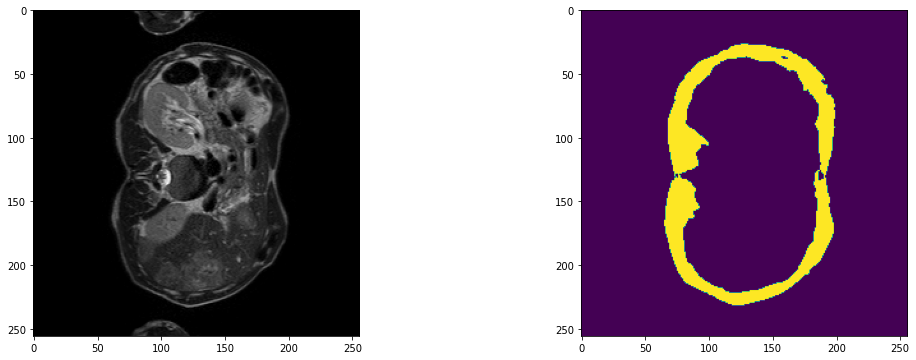

2023-09-14 06:04:09,237 INFO image_writer.py:194 - writing: outMR04_Sep23/A074_v6_T2W_seg.nii.gz


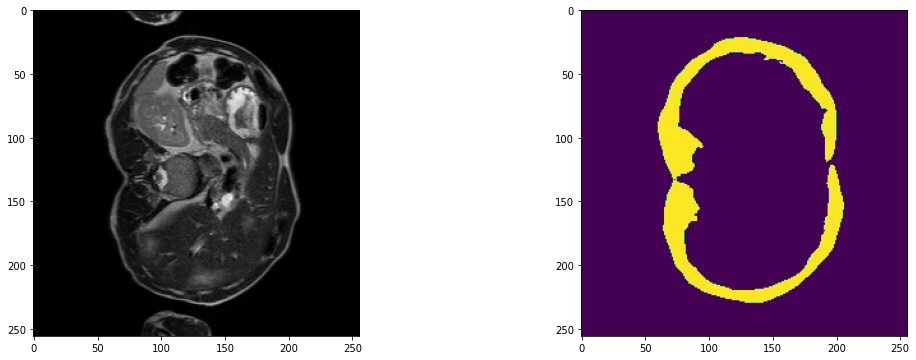

2023-09-14 06:04:14,965 INFO image_writer.py:194 - writing: outMR04_Sep23/A074_v7_T2W_seg.nii.gz


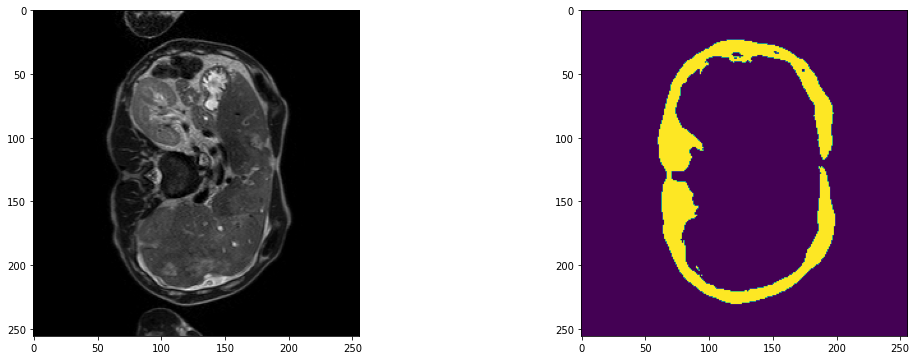

2023-09-14 06:04:17,016 INFO image_writer.py:194 - writing: outMR04_Sep23/A076_v1_T2W_seg.nii.gz


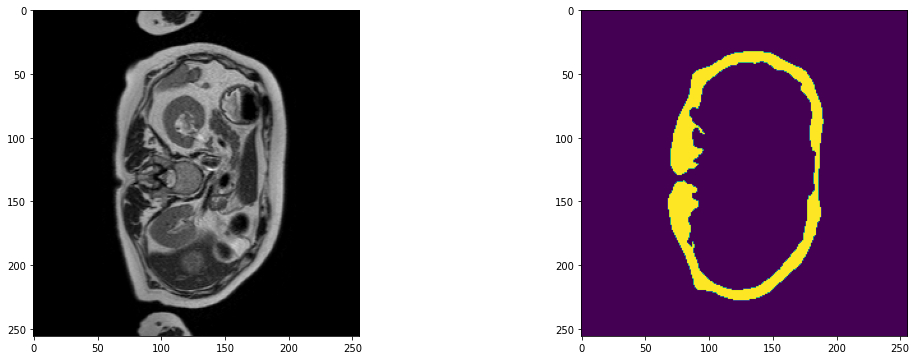

2023-09-14 06:04:19,311 INFO image_writer.py:194 - writing: outMR04_Sep23/A076_v2_T2W_seg.nii.gz


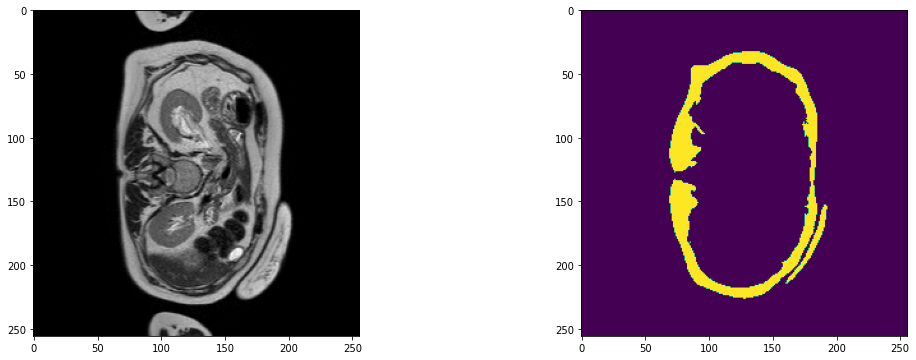

2023-09-14 06:04:21,367 INFO image_writer.py:194 - writing: outMR04_Sep23/A076_v3_T2W_seg.nii.gz


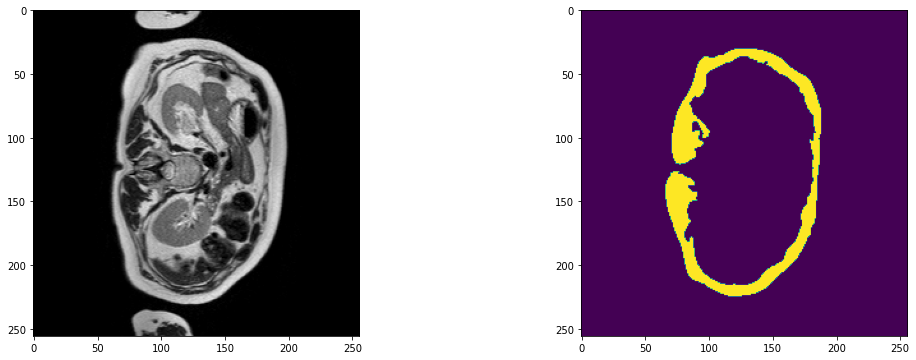

2023-09-14 06:04:23,662 INFO image_writer.py:194 - writing: outMR04_Sep23/A076_v4_T2W_seg.nii.gz


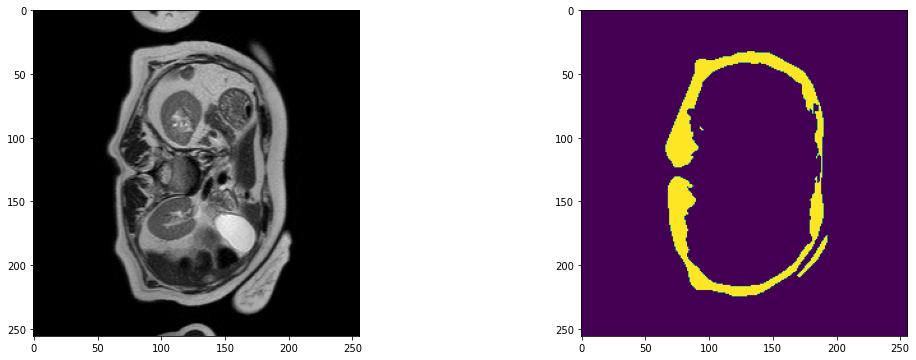

2023-09-14 06:04:26,017 INFO image_writer.py:194 - writing: outMR04_Sep23/A076_v5_T2W_seg.nii.gz


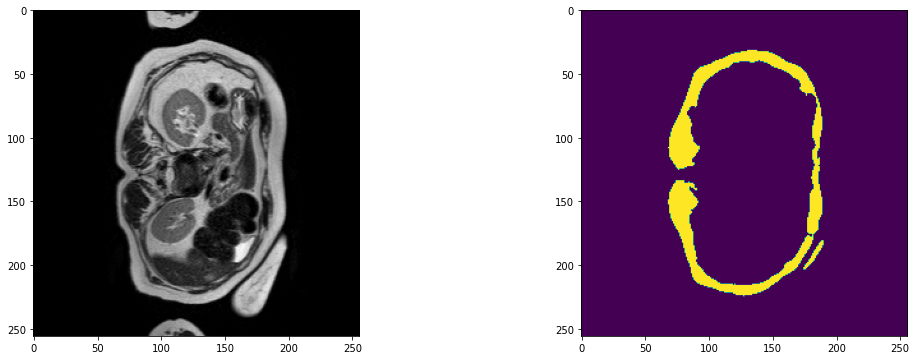

2023-09-14 06:04:28,335 INFO image_writer.py:194 - writing: outMR04_Sep23/A076_v6_T2W_seg.nii.gz


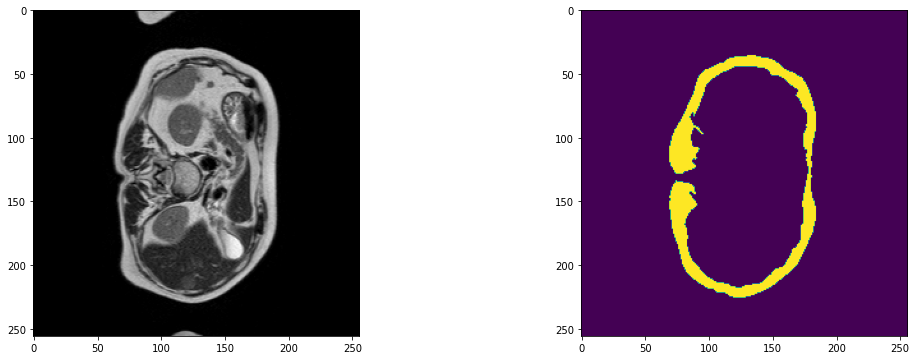

2023-09-14 06:04:30,631 INFO image_writer.py:194 - writing: outMR04_Sep23/A076_v7_T2W_seg.nii.gz


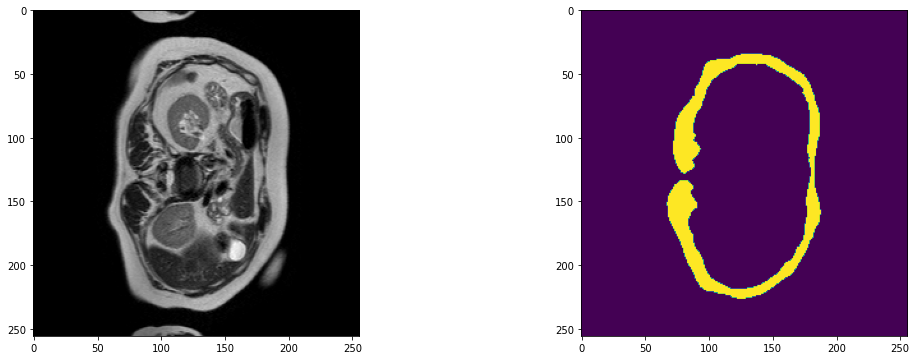

In [16]:
# # uncomment the following lines to visualize the predicted results
from monai.transforms import LoadImage
loader = LoadImage()

model.load_state_dict(torch.load(
    os.path.join(data_dir, "TestMR04_multiclassUNetR_Sep23.pth")))
model.eval()

with torch.no_grad():
    for test_data in test_org_loader:
        test_inputs = test_data["image"].to(device)
        roi_size = (96, 96, 16)
        sw_batch_size = 4
        test_data["pred"] = sliding_window_inference(
            test_inputs, roi_size, sw_batch_size, model, overlap=0.8)

        test_data = [post_transforms(i) for i in decollate_batch(test_data)]

#         # uncomment the following lines to visualize the predicted results
        test_output = from_engine(["pred"])(test_data)

        original_image = loader(test_data[0]["image_meta_dict"]["filename_or_obj"])[0]

        plt.figure("check", (18, 6))
        plt.subplot(1, 2, 1)
        plt.imshow(original_image[:, :, 8], cmap="gray")
        plt.subplot(1, 2, 2)
        plt.imshow(test_output[0].detach().cpu()[5, :, :, 8])
        plt.show()

In [17]:
!tar -cvzf outMR04_Sep23.tar.gz outMR04_Sep23

outMR04_Sep23/
outMR04_Sep23/A026_v1_T2W_seg.nii.gz
outMR04_Sep23/A066_v5_T2W_seg.nii.gz
outMR04_Sep23/A074_v5_T2W_seg.nii.gz
outMR04_Sep23/A022_v9_T2W_seg.nii.gz
outMR04_Sep23/A011_v2_T2W_seg.nii.gz
outMR04_Sep23/A003_v1_T2W_seg.nii.gz
outMR04_Sep23/A022_v3_T2W_seg.nii.gz
outMR04_Sep23/A034_v1_T2W_seg.nii.gz
outMR04_Sep23/A066_v3_T2W_seg.nii.gz
outMR04_Sep23/A049_v5_T2W_seg.nii.gz
outMR04_Sep23/A017_v1_T2W_seg.nii.gz
outMR04_Sep23/A071_v5_T2W_seg.nii.gz
outMR04_Sep23/A017_v5_T2W_seg.nii.gz
outMR04_Sep23/A057_v2_T2W_seg.nii.gz
outMR04_Sep23/A016_v3_T2W_seg.nii.gz
outMR04_Sep23/A031_v1_T2W_seg.nii.gz
outMR04_Sep23/A033_v3_T2W_seg.nii.gz
outMR04_Sep23/A076_v7_T2W_seg.nii.gz
outMR04_Sep23/A067_v6_T2W_seg.nii.gz
outMR04_Sep23/A011_v1_T2W_seg.nii.gz
outMR04_Sep23/A071_v2_T2W_seg.nii.gz
outMR04_Sep23/A061_v3_T2W_seg.nii.gz
outMR04_Sep23/A015_v7_T2W_seg.nii.gz
outMR04_Sep23/A064_v5_T2W_seg.nii.gz
outMR04_Sep23/A021_v3_T2W_seg.nii.gz
outMR04_Sep23/A048_v2_T2W_seg.nii.gz
outMR04_Sep23/A048_v6_T

outMR04_Sep23/A057_v6_T2W_seg.nii.gz
outMR04_Sep23/A062_v4_T2W_seg.nii.gz
outMR04_Sep23/A024_v7_T2W_seg.nii.gz
outMR04_Sep23/A002_v3_T2W_seg.nii.gz
outMR04_Sep23/A018_v6_T2W_seg.nii.gz
outMR04_Sep23/A057_v1_T2W_seg.nii.gz
outMR04_Sep23/A030_v3_T2W_seg.nii.gz
outMR04_Sep23/A030_v7_T2W_seg.nii.gz
outMR04_Sep23/A029_v4_T2W_seg.nii.gz
outMR04_Sep23/A022_v5_T2W_seg.nii.gz
outMR04_Sep23/A046_v3_T2W_seg.nii.gz
outMR04_Sep23/A013_v3_T2W_seg.nii.gz
outMR04_Sep23/A032_v5_T2W_seg.nii.gz
outMR04_Sep23/A041_v6_T2W_seg.nii.gz
outMR04_Sep23/A056_v4_T2W_seg.nii.gz
outMR04_Sep23/A009_v3_T2W_seg.nii.gz
outMR04_Sep23/A009_v6_T2W_seg.nii.gz
outMR04_Sep23/A037_v6_T2W_seg.nii.gz
outMR04_Sep23/A074_v6_T2W_seg.nii.gz
outMR04_Sep23/A016_v4_T2W_seg.nii.gz
outMR04_Sep23/A037_v2_T2W_seg.nii.gz
outMR04_Sep23/A057_v5_T2W_seg.nii.gz
outMR04_Sep23/A002_v5_T2W_seg.nii.gz
outMR04_Sep23/A063_v7_T2W_seg.nii.gz
outMR04_Sep23/A056_v5_T2W_seg.nii.gz
outMR04_Sep23/A068_v3_T2W_seg.nii.gz
outMR04_Sep23/A064_v6_T2W_seg.nii.gz
o

In [ ]:
# !pwd

In [ ]:
# plt.figure("check", (18, 6))
# plt.subplot(1, 2, 1)
# plt.title("image")
# plt.imshow(test_inputs.cpu().numpy()[0, 0, :, :, 20], cmap="gray")
# plt.subplot(1, 2, 2)
# plt.title("output")
# plt.imshow(
#     torch.argmax(test_outputs, dim=1).detach().cpu()[0, :, :, 20]
# )
# plt.show()

In [ ]:
# print(test_output[0].shape)

In [ ]:
# slno = 20
# plt.figure("check1", (18, 6))
# plt.imshow(original_image[:, :, slno], cmap="gray")
# plt.figure("check2", (18, 6))
# plt.subplot(3, 3, 1)
# plt.imshow(test_output[0].detach().cpu()[0, :, :, slno])
# plt.subplot(3, 3, 2)
# plt.imshow(test_output[0].detach().cpu()[1, :, :, slno])
# plt.subplot(3, 3, 3)
# plt.imshow(test_output[0].detach().cpu()[2, :, :, slno])
# plt.subplot(3, 3, 4)
# plt.imshow(test_output[0].detach().cpu()[3, :, :, slno])
# plt.subplot(3, 3, 5)
# plt.imshow(test_output[0].detach().cpu()[4, :, :, slno])
# plt.subplot(3, 3, 6)
# plt.imshow(test_output[0].detach().cpu()[5, :, :, slno])
# plt.subplot(3, 3, 7)
# plt.imshow(test_output[0].detach().cpu()[6, :, :, slno])
# plt.subplot(3, 3, 8)
# plt.imshow(test_output[0].detach().cpu()[7, :, :, slno])
# plt.subplot(3, 3, 9)
# plt.imshow(test_output[0].detach().cpu()[8, :, :, slno])
# plt.show()